In [1]:
import os
import tensorflow as tf
import random

from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

In [2]:
gtPath = "_conv3/"
rgbPath = "_out/"

modelList = ['Unet','DeepLab','Segnet','PspNet']

modelChoice = 'Unet'

gtFileNames = os.listdir(gtPath)
outFileNames = os.listdir(rgbPath)

matchingFiles = set(outFileNames) & set(gtFileNames)

In [3]:
NumTrainingImages = 10000
StartingIndex = 0

import random

random.seed(2)
FileNames = random.sample(matchingFiles, NumTrainingImages)

                            
gtFileNames = gtFileNames[StartingIndex:StartingIndex+NumTrainingImages]
outFileNames = outFileNames [StartingIndex:StartingIndex+NumTrainingImages]

for i in range(0,NumTrainingImages):
    gtFileNames[i] = gtPath + FileNames[i]
    outFileNames[i] = rgbPath + FileNames[i]
    

C:\Users\danie\AppData\Local\Temp\ipykernel_19740\4100139935.py:7: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  FileNames = random.sample(matchingFiles, NumTrainingImages)


In [4]:
len(gtFileNames)

10000

In [5]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(outFileNames, gtFileNames, test_size=0.2, random_state=1)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1) # 0.25 x 0.8 = 0.2

In [6]:
def loadImage(outPath, gtPath):
    img = tf.io.read_file(outPath)
    img = tf.image.decode_png(img, channels=3)
    img = tf.cast(img, tf.float32) / 255.0
    img = img[:1000, 460:1460, :] # Crop the photo (bonnet &)
    img = tf.image.resize(img, (256, 256), method='nearest')

    mask = tf.io.read_file(gtPath)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = mask[:1000, 460:1460, :] # Crop the bonnet
    mask = tf.image.resize(mask, (256, 256), method='nearest')
    
    return img, mask

In [7]:
def genDataset(outPath, gtPath, bufferSize, batchSize):
    
    imageList = tf.constant(outPath) 
    maskList = tf.constant(gtPath)
    dataset = tf.data.Dataset.from_tensor_slices((imageList, maskList))
    dataset = dataset.map(loadImage, num_parallel_calls=tf.data.AUTOTUNE)
    
    dataset = dataset.cache().shuffle(bufferSize).batch(batchSize)
    
    return dataset

In [8]:
import Segnet
import Unet
import PspNet
import DeepLab

In [9]:
imgShape = (256,256,3)

filters = 32
labels = 32 # True/False 32 total classes if you want to go for full class classification 



if(modelChoice == 'Unet'):
    batchSize = 32
    bufferSize = 500
    filters = 64
    model = Unet.unet(imgShape, filters, labels)
    model.summary()
elif(modelChoice == 'Segnet'):
    batchSize = 10 #Lower batchSize to fit into GPU mem
    bufferSize = 500
    model = Segnet.segnet(imgShape, labels, 3, (2, 2), "softmax")
    model.summary()
elif(modelChoice == 'DeepLab'):
    batchSize = 32
    bufferSize = 500
    model = DeepLab.DeepLab(imgShape, labels)
    model.summary()
elif(modelChoice == 'PspNet'):
    batchSize = 5 #Lower batchSize to fit into GPU mem
    bufferSize = 500
    model = PspNet.pspNet(imgShape, labels)
    model.summary()
else:
    print('Model choice not in list')

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 32  896         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 32  128        ['conv2d[0][0]']                 
 alization)                     )                                                             

In [10]:
trainDataset = genDataset(X_train, y_train, bufferSize, batchSize)
valDataset = genDataset(X_val, y_val, bufferSize, batchSize)
testDataset = genDataset(X_test, y_test, bufferSize, batchSize)

In [11]:
model.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])
ES = EarlyStopping(monitor='val_accuracy', patience=15, restore_best_weights=True, verbose=1)
reduceLR = ReduceLROnPlateau(monitor='val_accuracy',factor=1e-1, patience=5, verbose=1, min_lr = 2e-6)

epochs = 30

In [12]:
MeasureEmissions = True
if(MeasureEmissions == True):
    from codecarbon import EmissionsTracker
    tracker = EmissionsTracker()
    tracker.start()
try:

    history = model.fit(trainDataset, 
                        validation_data = valDataset, 
                        epochs = epochs, 
                        verbose=1, 
                        callbacks = [ES, reduceLR], 
                        batch_size = batchSize, 
                        shuffle = True)
finally:
    if(MeasureEmissions == True):
        tracker.stop()

[codecarbon INFO @ 20:38:21] [setup] RAM Tracking...
[codecarbon INFO @ 20:38:21] [setup] GPU Tracking...
[codecarbon INFO @ 20:38:21] Tracking Nvidia GPU via pynvml
[codecarbon INFO @ 20:38:21] [setup] CPU Tracking...
[codecarbon WARNING @ 20:38:21] No CPU tracking mode found. Falling back on CPU constant mode.
[codecarbon INFO @ 20:38:22] CPU Model on constant consumption mode: AMD Ryzen 7 5800X 8-Core Processor
[codecarbon INFO @ 20:38:22] >>> Tracker's metadata:
[codecarbon INFO @ 20:38:22]   Platform system: Windows-10-10.0.22631-SP0
[codecarbon INFO @ 20:38:22]   Python version: 3.9.18
[codecarbon INFO @ 20:38:22]   CodeCarbon version: 2.3.2
[codecarbon INFO @ 20:38:22]   Available RAM : 31.925 GB
[codecarbon INFO @ 20:38:22]   CPU count: 16
[codecarbon INFO @ 20:38:22]   CPU model: AMD Ryzen 7 5800X 8-Core Processor
[codecarbon INFO @ 20:38:22]   GPU count: 1
[codecarbon INFO @ 20:38:22]   GPU model: 1 x NVIDIA GeForce RTX 3060


Epoch 1/30


[codecarbon INFO @ 20:38:41] Energy consumed for RAM : 0.000050 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:38:41] Energy consumed for all GPUs : 0.000172 kWh. Total GPU Power : 41.245903743265856 W
[codecarbon INFO @ 20:38:41] Energy consumed for all CPUs : 0.000219 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:38:41] 0.000441 kWh of electricity used since the beginning.


  3/188 [..............................] - ETA: 3:24 - loss: 4.1209 - accuracy: 0.0390     

[codecarbon INFO @ 20:38:56] Energy consumed for RAM : 0.000100 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:38:56] Energy consumed for all GPUs : 0.000692 kWh. Total GPU Power : 124.52279182613425 W
[codecarbon INFO @ 20:38:56] Energy consumed for all CPUs : 0.000438 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:38:56] 0.001229 kWh of electricity used since the beginning.


 17/188 [=>............................] - ETA: 3:04 - loss: 2.7387 - accuracy: 0.6944

[codecarbon INFO @ 20:39:11] Energy consumed for RAM : 0.000150 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:39:11] Energy consumed for all GPUs : 0.001149 kWh. Total GPU Power : 109.63079479167602 W
[codecarbon INFO @ 20:39:11] Energy consumed for all CPUs : 0.000657 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:39:11] 0.001955 kWh of electricity used since the beginning.


 30/188 [===>..........................] - ETA: 2:50 - loss: 1.7839 - accuracy: 0.8100

[codecarbon INFO @ 20:39:26] Energy consumed for RAM : 0.000200 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:39:26] Energy consumed for all GPUs : 0.001600 kWh. Total GPU Power : 108.46740333111784 W
[codecarbon INFO @ 20:39:26] Energy consumed for all CPUs : 0.000876 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:39:26] 0.002676 kWh of electricity used since the beginning.


 44/188 [======>.......................] - ETA: 2:36 - loss: 1.2751 - accuracy: 0.8565

[codecarbon INFO @ 20:39:41] Energy consumed for RAM : 0.000249 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:39:41] Energy consumed for all GPUs : 0.002047 kWh. Total GPU Power : 107.11410796478188 W
[codecarbon INFO @ 20:39:41] Energy consumed for all CPUs : 0.001095 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:39:41] 0.003391 kWh of electricity used since the beginning.


 58/188 [========>.....................] - ETA: 2:21 - loss: 0.9909 - accuracy: 0.8840

[codecarbon INFO @ 20:39:56] Energy consumed for RAM : 0.000299 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:39:56] Energy consumed for all GPUs : 0.002502 kWh. Total GPU Power : 108.9368223145547 W
[codecarbon INFO @ 20:39:56] Energy consumed for all CPUs : 0.001314 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:39:56] 0.004115 kWh of electricity used since the beginning.


 71/188 [==========>...................] - ETA: 2:07 - loss: 0.8198 - accuracy: 0.9024

[codecarbon INFO @ 20:40:11] Energy consumed for RAM : 0.000349 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:40:11] Energy consumed for all GPUs : 0.002953 kWh. Total GPU Power : 108.43248935666143 W
[codecarbon INFO @ 20:40:11] Energy consumed for all CPUs : 0.001532 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:40:11] 0.004835 kWh of electricity used since the beginning.


 85/188 [============>.................] - ETA: 1:52 - loss: 0.6925 - accuracy: 0.9161

[codecarbon INFO @ 20:40:26] Energy consumed for RAM : 0.000399 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:40:26] Energy consumed for all GPUs : 0.003403 kWh. Total GPU Power : 107.91198256207542 W
[codecarbon INFO @ 20:40:26] Energy consumed for all CPUs : 0.001751 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:40:26] 0.005554 kWh of electricity used since the beginning.


 99/188 [==============>...............] - ETA: 1:36 - loss: 0.5996 - accuracy: 0.9263

[codecarbon INFO @ 20:40:41] Energy consumed for RAM : 0.000449 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:40:41] Energy consumed for all GPUs : 0.003859 kWh. Total GPU Power : 109.41878858284636 W
[codecarbon INFO @ 20:40:41] Energy consumed for all CPUs : 0.001970 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:40:41] 0.006278 kWh of electricity used since the beginning.


113/188 [=================>............] - ETA: 1:21 - loss: 0.5300 - accuracy: 0.9339

[codecarbon INFO @ 20:40:56] Energy consumed for RAM : 0.000499 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:40:56] Energy consumed for all GPUs : 0.004300 kWh. Total GPU Power : 105.80866547005559 W
[codecarbon INFO @ 20:40:56] Energy consumed for all CPUs : 0.002189 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:40:56] 0.006988 kWh of electricity used since the beginning.


126/188 [===================>..........] - ETA: 1:07 - loss: 0.4786 - accuracy: 0.9396

[codecarbon INFO @ 20:41:11] Energy consumed for RAM : 0.000549 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:41:11] Energy consumed for all GPUs : 0.004749 kWh. Total GPU Power : 107.79059911706955 W
[codecarbon INFO @ 20:41:11] Energy consumed for all CPUs : 0.002408 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:41:11] 0.007706 kWh of electricity used since the beginning.


140/188 [=====================>........] - ETA: 52s - loss: 0.4337 - accuracy: 0.9446

[codecarbon INFO @ 20:41:26] Energy consumed for RAM : 0.000599 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:41:26] Energy consumed for all GPUs : 0.005191 kWh. Total GPU Power : 105.88970284485632 W
[codecarbon INFO @ 20:41:26] Energy consumed for all CPUs : 0.002627 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:41:26] 0.008417 kWh of electricity used since the beginning.


153/188 [=======================>......] - ETA: 38s - loss: 0.4012 - accuracy: 0.9479

[codecarbon INFO @ 20:41:41] Energy consumed for RAM : 0.000649 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:41:41] Energy consumed for all GPUs : 0.005633 kWh. Total GPU Power : 105.91371658302512 W
[codecarbon INFO @ 20:41:41] Energy consumed for all CPUs : 0.002846 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:41:41] 0.009127 kWh of electricity used since the beginning.


167/188 [=========================>....] - ETA: 23s - loss: 0.3731 - accuracy: 0.9506

[codecarbon INFO @ 20:41:56] Energy consumed for RAM : 0.000699 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:41:56] Energy consumed for all GPUs : 0.006080 kWh. Total GPU Power : 107.05918425387495 W
[codecarbon INFO @ 20:41:56] Energy consumed for all CPUs : 0.003065 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:41:56] 0.009843 kWh of electricity used since the beginning.


184/188 [============================>.] - ETA: 4s - loss: 0.3425 - accuracy: 0.9538

[codecarbon INFO @ 20:42:11] Energy consumed for RAM : 0.000748 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:42:11] Energy consumed for all GPUs : 0.006592 kWh. Total GPU Power : 123.12709665405107 W
[codecarbon INFO @ 20:42:11] Energy consumed for all CPUs : 0.003284 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:42:11] 0.010624 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.3367 - accuracy: 0.9544

[codecarbon INFO @ 20:42:26] Energy consumed for RAM : 0.000798 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:42:26] Energy consumed for all GPUs : 0.007021 kWh. Total GPU Power : 102.67733292157298 W
[codecarbon INFO @ 20:42:26] Energy consumed for all CPUs : 0.003503 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:42:26] 0.011323 kWh of electricity used since the beginning.
[codecarbon INFO @ 20:42:41] Energy consumed for RAM : 0.000848 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:42:41] Energy consumed for all GPUs : 0.007308 kWh. Total GPU Power : 68.8242733230236 W
[codecarbon INFO @ 20:42:41] Energy consumed for all CPUs : 0.003722 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:42:41] 0.011879 kWh of electricity used since the beginning.
[codecarbon INFO @ 20:42:56] Energy consumed for RAM : 0.000898 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:42:56] Energy consumed for all GPUs : 0.007648 kWh. Total GPU Power : 81.64138854509697

188/188 [==============================] - 276s 1s/step - loss: 0.3367 - accuracy: 0.9544 - val_loss: 20.6148 - val_accuracy: 0.0612 - lr: 0.0010
Epoch 2/30
 11/188 [>.............................] - ETA: 2:15 - loss: 0.0357 - accuracy: 0.9877

[codecarbon INFO @ 20:43:11] Energy consumed for RAM : 0.000948 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:43:11] Energy consumed for all GPUs : 0.008180 kWh. Total GPU Power : 127.52282392093863 W
[codecarbon INFO @ 20:43:11] Energy consumed for all CPUs : 0.004159 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:43:11] 0.013287 kWh of electricity used since the beginning.


 31/188 [===>..........................] - ETA: 2:00 - loss: 0.0383 - accuracy: 0.9862

[codecarbon INFO @ 20:43:26] Energy consumed for RAM : 0.000998 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:43:26] Energy consumed for all GPUs : 0.008731 kWh. Total GPU Power : 132.34799838775655 W
[codecarbon INFO @ 20:43:26] Energy consumed for all CPUs : 0.004378 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:43:26] 0.014107 kWh of electricity used since the beginning.


 50/188 [======>.......................] - ETA: 1:46 - loss: 0.0385 - accuracy: 0.9864

[codecarbon INFO @ 20:43:41] Energy consumed for RAM : 0.001048 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:43:41] Energy consumed for all GPUs : 0.009298 kWh. Total GPU Power : 136.07345263557423 W
[codecarbon INFO @ 20:43:41] Energy consumed for all CPUs : 0.004597 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:43:41] 0.014943 kWh of electricity used since the beginning.


 70/188 [==========>...................] - ETA: 1:30 - loss: 0.0355 - accuracy: 0.9875

[codecarbon INFO @ 20:43:56] Energy consumed for RAM : 0.001098 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:43:56] Energy consumed for all GPUs : 0.009860 kWh. Total GPU Power : 134.8509104274092 W
[codecarbon INFO @ 20:43:56] Energy consumed for all CPUs : 0.004816 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:43:56] 0.015774 kWh of electricity used since the beginning.


 89/188 [=============>................] - ETA: 1:16 - loss: 0.0331 - accuracy: 0.9884

[codecarbon INFO @ 20:44:11] Energy consumed for RAM : 0.001148 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:44:11] Energy consumed for all GPUs : 0.010424 kWh. Total GPU Power : 135.2781970644927 W
[codecarbon INFO @ 20:44:11] Energy consumed for all CPUs : 0.005035 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:44:11] 0.016607 kWh of electricity used since the beginning.


109/188 [================>.............] - ETA: 1:00 - loss: 0.0308 - accuracy: 0.9892

[codecarbon INFO @ 20:44:26] Energy consumed for RAM : 0.001197 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:44:26] Energy consumed for all GPUs : 0.010998 kWh. Total GPU Power : 137.715282042047 W
[codecarbon INFO @ 20:44:26] Energy consumed for all CPUs : 0.005254 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:44:26] 0.017449 kWh of electricity used since the beginning.


128/188 [===================>..........] - ETA: 46s - loss: 0.0292 - accuracy: 0.9897

[codecarbon INFO @ 20:44:41] Energy consumed for RAM : 0.001247 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:44:41] Energy consumed for all GPUs : 0.011556 kWh. Total GPU Power : 133.7139976384965 W
[codecarbon INFO @ 20:44:41] Energy consumed for all CPUs : 0.005472 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:44:41] 0.018275 kWh of electricity used since the beginning.


148/188 [======================>.......] - ETA: 30s - loss: 0.0281 - accuracy: 0.9900

[codecarbon INFO @ 20:44:56] Energy consumed for RAM : 0.001297 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:44:56] Energy consumed for all GPUs : 0.012126 kWh. Total GPU Power : 136.83768123704348 W
[codecarbon INFO @ 20:44:56] Energy consumed for all CPUs : 0.005691 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:44:56] 0.019114 kWh of electricity used since the beginning.


167/188 [=========================>....] - ETA: 16s - loss: 0.0272 - accuracy: 0.9903

[codecarbon INFO @ 20:45:11] Energy consumed for RAM : 0.001347 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:45:11] Energy consumed for all GPUs : 0.012688 kWh. Total GPU Power : 134.81361825997692 W
[codecarbon INFO @ 20:45:11] Energy consumed for all CPUs : 0.005910 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:45:11] 0.019945 kWh of electricity used since the beginning.


186/188 [============================>.] - ETA: 1s - loss: 0.0278 - accuracy: 0.9901

[codecarbon INFO @ 20:45:26] Energy consumed for RAM : 0.001397 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:45:26] Energy consumed for all GPUs : 0.013260 kWh. Total GPU Power : 137.2395292228311 W
[codecarbon INFO @ 20:45:26] Energy consumed for all CPUs : 0.006129 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:45:26] 0.020786 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0277 - accuracy: 0.9901

[codecarbon INFO @ 20:45:41] Energy consumed for RAM : 0.001447 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:45:41] Energy consumed for all GPUs : 0.013815 kWh. Total GPU Power : 133.31428630708385 W
[codecarbon INFO @ 20:45:41] Energy consumed for all CPUs : 0.006348 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:45:41] 0.021610 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 860ms/step - loss: 0.0277 - accuracy: 0.9901 - val_loss: 0.1992 - val_accuracy: 0.9672 - lr: 0.0010
Epoch 3/30
 16/188 [=>............................] - ETA: 2:12 - loss: 0.0275 - accuracy: 0.9895

[codecarbon INFO @ 20:45:56] Energy consumed for RAM : 0.001497 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:45:56] Energy consumed for all GPUs : 0.014383 kWh. Total GPU Power : 136.24874818776289 W
[codecarbon INFO @ 20:45:56] Energy consumed for all CPUs : 0.006567 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:45:56] 0.022447 kWh of electricity used since the beginning.


 35/188 [====>.........................] - ETA: 1:58 - loss: 0.0233 - accuracy: 0.9912

[codecarbon INFO @ 20:46:11] Energy consumed for RAM : 0.001547 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:46:11] Energy consumed for all GPUs : 0.014952 kWh. Total GPU Power : 136.31168043505664 W
[codecarbon INFO @ 20:46:11] Energy consumed for all CPUs : 0.006785 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:46:11] 0.023284 kWh of electricity used since the beginning.


 55/188 [=======>......................] - ETA: 1:42 - loss: 0.0223 - accuracy: 0.9917

[codecarbon INFO @ 20:46:26] Energy consumed for RAM : 0.001597 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:46:26] Energy consumed for all GPUs : 0.015527 kWh. Total GPU Power : 138.12886682483884 W
[codecarbon INFO @ 20:46:26] Energy consumed for all CPUs : 0.007004 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:46:26] 0.024128 kWh of electricity used since the beginning.


 74/188 [==========>...................] - ETA: 1:28 - loss: 0.0219 - accuracy: 0.9919

[codecarbon INFO @ 20:46:41] Energy consumed for RAM : 0.001646 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:46:41] Energy consumed for all GPUs : 0.016092 kWh. Total GPU Power : 135.56440658049476 W
[codecarbon INFO @ 20:46:41] Energy consumed for all CPUs : 0.007223 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:46:41] 0.024962 kWh of electricity used since the beginning.


 94/188 [==============>...............] - ETA: 1:12 - loss: 0.0208 - accuracy: 0.9923

[codecarbon INFO @ 20:46:56] Energy consumed for RAM : 0.001696 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:46:56] Energy consumed for all GPUs : 0.016669 kWh. Total GPU Power : 138.47651840415057 W
[codecarbon INFO @ 20:46:56] Energy consumed for all CPUs : 0.007442 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:46:56] 0.025808 kWh of electricity used since the beginning.


113/188 [=================>............] - ETA: 57s - loss: 0.0199 - accuracy: 0.9927

[codecarbon INFO @ 20:47:11] Energy consumed for RAM : 0.001746 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:47:11] Energy consumed for all GPUs : 0.017230 kWh. Total GPU Power : 134.53030062388584 W
[codecarbon INFO @ 20:47:11] Energy consumed for all CPUs : 0.007661 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:47:11] 0.026637 kWh of electricity used since the beginning.


132/188 [====================>.........] - ETA: 43s - loss: 0.0192 - accuracy: 0.9930

[codecarbon INFO @ 20:47:26] Energy consumed for RAM : 0.001796 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:47:26] Energy consumed for all GPUs : 0.017800 kWh. Total GPU Power : 136.7375602145728 W
[codecarbon INFO @ 20:47:26] Energy consumed for all CPUs : 0.007880 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:47:26] 0.027475 kWh of electricity used since the beginning.


152/188 [=======================>......] - ETA: 27s - loss: 0.0186 - accuracy: 0.9932

[codecarbon INFO @ 20:47:41] Energy consumed for RAM : 0.001846 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:47:41] Energy consumed for all GPUs : 0.018372 kWh. Total GPU Power : 137.31265650817016 W
[codecarbon INFO @ 20:47:41] Energy consumed for all CPUs : 0.008098 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:47:41] 0.028316 kWh of electricity used since the beginning.


171/188 [==========================>...] - ETA: 13s - loss: 0.0180 - accuracy: 0.9934

[codecarbon INFO @ 20:47:56] Energy consumed for RAM : 0.001896 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:47:56] Energy consumed for all GPUs : 0.018940 kWh. Total GPU Power : 136.29144765212604 W
[codecarbon INFO @ 20:47:56] Energy consumed for all CPUs : 0.008317 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:47:56] 0.029154 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0178 - accuracy: 0.9935

[codecarbon INFO @ 20:48:11] Energy consumed for RAM : 0.001946 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:48:11] Energy consumed for all GPUs : 0.019499 kWh. Total GPU Power : 134.04926706332523 W
[codecarbon INFO @ 20:48:11] Energy consumed for all CPUs : 0.008536 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:48:11] 0.029981 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0178 - accuracy: 0.9935 - val_loss: 0.0561 - val_accuracy: 0.9835 - lr: 0.0010
Epoch 4/30


[codecarbon INFO @ 20:48:26] Energy consumed for RAM : 0.001996 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:48:26] Energy consumed for all GPUs : 0.020057 kWh. Total GPU Power : 133.8504976998395 W
[codecarbon INFO @ 20:48:26] Energy consumed for all CPUs : 0.008755 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:48:26] 0.030807 kWh of electricity used since the beginning.


 19/188 [==>...........................] - ETA: 2:11 - loss: 0.0146 - accuracy: 0.9946

[codecarbon INFO @ 20:48:41] Energy consumed for RAM : 0.002046 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:48:41] Energy consumed for all GPUs : 0.020627 kWh. Total GPU Power : 136.8607263703757 W
[codecarbon INFO @ 20:48:41] Energy consumed for all CPUs : 0.008974 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:48:41] 0.031646 kWh of electricity used since the beginning.


 39/188 [=====>........................] - ETA: 1:55 - loss: 0.0135 - accuracy: 0.9950

[codecarbon INFO @ 20:48:56] Energy consumed for RAM : 0.002095 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:48:56] Energy consumed for all GPUs : 0.021187 kWh. Total GPU Power : 134.31477478510573 W
[codecarbon INFO @ 20:48:56] Energy consumed for all CPUs : 0.009193 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:48:56] 0.032475 kWh of electricity used since the beginning.


 58/188 [========>.....................] - ETA: 1:41 - loss: 0.0130 - accuracy: 0.9952

[codecarbon INFO @ 20:49:11] Energy consumed for RAM : 0.002145 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:49:11] Energy consumed for all GPUs : 0.021758 kWh. Total GPU Power : 137.01279704451355 W
[codecarbon INFO @ 20:49:11] Energy consumed for all CPUs : 0.009411 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:49:11] 0.033315 kWh of electricity used since the beginning.


 77/188 [===========>..................] - ETA: 1:26 - loss: 0.0128 - accuracy: 0.9952

[codecarbon INFO @ 20:49:26] Energy consumed for RAM : 0.002195 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:49:26] Energy consumed for all GPUs : 0.022333 kWh. Total GPU Power : 137.85725764416418 W
[codecarbon INFO @ 20:49:26] Energy consumed for all CPUs : 0.009630 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:49:26] 0.034158 kWh of electricity used since the beginning.


 97/188 [==============>...............] - ETA: 1:10 - loss: 0.0126 - accuracy: 0.9953

[codecarbon INFO @ 20:49:41] Energy consumed for RAM : 0.002245 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:49:41] Energy consumed for all GPUs : 0.022888 kWh. Total GPU Power : 133.31617291740434 W
[codecarbon INFO @ 20:49:41] Energy consumed for all CPUs : 0.009849 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:49:41] 0.034983 kWh of electricity used since the beginning.


116/188 [=================>............] - ETA: 55s - loss: 0.0127 - accuracy: 0.9953

[codecarbon INFO @ 20:49:56] Energy consumed for RAM : 0.002295 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:49:56] Energy consumed for all GPUs : 0.023464 kWh. Total GPU Power : 138.11456335417813 W
[codecarbon INFO @ 20:49:56] Energy consumed for all CPUs : 0.010068 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:49:56] 0.035827 kWh of electricity used since the beginning.


135/188 [====================>.........] - ETA: 41s - loss: 0.0128 - accuracy: 0.9952

[codecarbon INFO @ 20:50:11] Energy consumed for RAM : 0.002345 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:50:11] Energy consumed for all GPUs : 0.024032 kWh. Total GPU Power : 136.05952387248692 W
[codecarbon INFO @ 20:50:11] Energy consumed for all CPUs : 0.010287 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:50:11] 0.036664 kWh of electricity used since the beginning.


155/188 [=======================>......] - ETA: 25s - loss: 0.0128 - accuracy: 0.9953

[codecarbon INFO @ 20:50:26] Energy consumed for RAM : 0.002395 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:50:26] Energy consumed for all GPUs : 0.024593 kWh. Total GPU Power : 134.75300150164807 W
[codecarbon INFO @ 20:50:26] Energy consumed for all CPUs : 0.010506 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:50:26] 0.037494 kWh of electricity used since the beginning.


174/188 [==========================>...] - ETA: 10s - loss: 0.0126 - accuracy: 0.9953

[codecarbon INFO @ 20:50:41] Energy consumed for RAM : 0.002445 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:50:41] Energy consumed for all GPUs : 0.025165 kWh. Total GPU Power : 137.01198305344775 W
[codecarbon INFO @ 20:50:41] Energy consumed for all CPUs : 0.010725 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:50:41] 0.038334 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0125 - accuracy: 0.9953

[codecarbon INFO @ 20:50:56] Energy consumed for RAM : 0.002495 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:50:56] Energy consumed for all GPUs : 0.025730 kWh. Total GPU Power : 135.62792734523222 W
[codecarbon INFO @ 20:50:56] Energy consumed for all CPUs : 0.010944 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:50:56] 0.039168 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 864ms/step - loss: 0.0125 - accuracy: 0.9953 - val_loss: 0.0161 - val_accuracy: 0.9938 - lr: 0.0010
Epoch 5/30
  4/188 [..............................] - ETA: 2:22 - loss: 0.0131 - accuracy: 0.9951

[codecarbon INFO @ 20:51:11] Energy consumed for RAM : 0.002545 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:51:11] Energy consumed for all GPUs : 0.026286 kWh. Total GPU Power : 133.42558289900296 W
[codecarbon INFO @ 20:51:11] Energy consumed for all CPUs : 0.011163 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:51:11] 0.039993 kWh of electricity used since the beginning.


 23/188 [==>...........................] - ETA: 2:07 - loss: 0.0111 - accuracy: 0.9958

[codecarbon INFO @ 20:51:26] Energy consumed for RAM : 0.002595 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:51:26] Energy consumed for all GPUs : 0.026861 kWh. Total GPU Power : 137.81425543516437 W
[codecarbon INFO @ 20:51:26] Energy consumed for all CPUs : 0.011381 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:51:26] 0.040836 kWh of electricity used since the beginning.


 42/188 [=====>........................] - ETA: 1:53 - loss: 0.0126 - accuracy: 0.9953

[codecarbon INFO @ 20:51:41] Energy consumed for RAM : 0.002644 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:51:41] Energy consumed for all GPUs : 0.027423 kWh. Total GPU Power : 134.884803318297 W
[codecarbon INFO @ 20:51:41] Energy consumed for all CPUs : 0.011600 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:51:41] 0.041667 kWh of electricity used since the beginning.


 62/188 [========>.....................] - ETA: 1:37 - loss: 0.0125 - accuracy: 0.9953

[codecarbon INFO @ 20:51:56] Energy consumed for RAM : 0.002694 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:51:56] Energy consumed for all GPUs : 0.027993 kWh. Total GPU Power : 136.79173518238835 W
[codecarbon INFO @ 20:51:56] Energy consumed for all CPUs : 0.011819 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:51:56] 0.042506 kWh of electricity used since the beginning.


 81/188 [===========>..................] - ETA: 1:22 - loss: 0.0122 - accuracy: 0.9954

[codecarbon INFO @ 20:52:11] Energy consumed for RAM : 0.002744 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:52:11] Energy consumed for all GPUs : 0.028560 kWh. Total GPU Power : 136.1388324686233 W
[codecarbon INFO @ 20:52:11] Energy consumed for all CPUs : 0.012038 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:52:11] 0.043342 kWh of electricity used since the beginning.


100/188 [==============>...............] - ETA: 1:08 - loss: 0.0119 - accuracy: 0.9955

[codecarbon INFO @ 20:52:26] Energy consumed for RAM : 0.002794 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:52:26] Energy consumed for all GPUs : 0.029134 kWh. Total GPU Power : 137.66769574806236 W
[codecarbon INFO @ 20:52:26] Energy consumed for all CPUs : 0.012257 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:52:26] 0.044185 kWh of electricity used since the beginning.


120/188 [==================>...........] - ETA: 52s - loss: 0.0116 - accuracy: 0.9956

[codecarbon INFO @ 20:52:41] Energy consumed for RAM : 0.002844 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:52:41] Energy consumed for all GPUs : 0.029698 kWh. Total GPU Power : 135.29814405645394 W
[codecarbon INFO @ 20:52:41] Energy consumed for all CPUs : 0.012476 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:52:41] 0.045018 kWh of electricity used since the beginning.


139/188 [=====================>........] - ETA: 37s - loss: 0.0113 - accuracy: 0.9957

[codecarbon INFO @ 20:52:56] Energy consumed for RAM : 0.002894 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:52:56] Energy consumed for all GPUs : 0.030265 kWh. Total GPU Power : 136.0486468180271 W
[codecarbon INFO @ 20:52:56] Energy consumed for all CPUs : 0.012694 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:52:56] 0.045854 kWh of electricity used since the beginning.


159/188 [========================>.....] - ETA: 22s - loss: 0.0111 - accuracy: 0.9958

[codecarbon INFO @ 20:53:11] Energy consumed for RAM : 0.002944 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:53:11] Energy consumed for all GPUs : 0.030831 kWh. Total GPU Power : 135.83008227529587 W
[codecarbon INFO @ 20:53:11] Energy consumed for all CPUs : 0.012913 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:53:11] 0.046688 kWh of electricity used since the beginning.


178/188 [===========================>..] - ETA: 7s - loss: 0.0109 - accuracy: 0.9959

[codecarbon INFO @ 20:53:26] Energy consumed for RAM : 0.002994 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:53:26] Energy consumed for all GPUs : 0.031399 kWh. Total GPU Power : 136.1285754641705 W
[codecarbon INFO @ 20:53:26] Energy consumed for all CPUs : 0.013132 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:53:26] 0.047524 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0108 - accuracy: 0.9959

[codecarbon INFO @ 20:53:41] Energy consumed for RAM : 0.003044 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:53:41] Energy consumed for all GPUs : 0.031969 kWh. Total GPU Power : 136.83561518812533 W
[codecarbon INFO @ 20:53:41] Energy consumed for all CPUs : 0.013351 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:53:41] 0.048363 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0108 - accuracy: 0.9959 - val_loss: 0.0099 - val_accuracy: 0.9962 - lr: 0.0010
Epoch 6/30
  7/188 [>.............................] - ETA: 2:20 - loss: 0.0094 - accuracy: 0.9963

[codecarbon INFO @ 20:53:56] Energy consumed for RAM : 0.003093 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:53:56] Energy consumed for all GPUs : 0.032527 kWh. Total GPU Power : 133.8645508354687 W
[codecarbon INFO @ 20:53:56] Energy consumed for all CPUs : 0.013570 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:53:56] 0.049190 kWh of electricity used since the beginning.


 27/188 [===>..........................] - ETA: 2:04 - loss: 0.0094 - accuracy: 0.9965

[codecarbon INFO @ 20:54:11] Energy consumed for RAM : 0.003143 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:54:11] Energy consumed for all GPUs : 0.033099 kWh. Total GPU Power : 137.2841414132252 W
[codecarbon INFO @ 20:54:11] Energy consumed for all CPUs : 0.013788 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:54:11] 0.050031 kWh of electricity used since the beginning.


 46/188 [======>.......................] - ETA: 1:49 - loss: 0.0092 - accuracy: 0.9965

[codecarbon INFO @ 20:54:26] Energy consumed for RAM : 0.003193 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:54:26] Energy consumed for all GPUs : 0.033659 kWh. Total GPU Power : 134.49481947167786 W
[codecarbon INFO @ 20:54:26] Energy consumed for all CPUs : 0.014007 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:54:26] 0.050860 kWh of electricity used since the beginning.


 65/188 [=========>....................] - ETA: 1:35 - loss: 0.0090 - accuracy: 0.9966

[codecarbon INFO @ 20:54:41] Energy consumed for RAM : 0.003243 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:54:41] Energy consumed for all GPUs : 0.034227 kWh. Total GPU Power : 136.30446475198806 W
[codecarbon INFO @ 20:54:41] Energy consumed for all CPUs : 0.014226 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:54:41] 0.051697 kWh of electricity used since the beginning.


 85/188 [============>.................] - ETA: 1:19 - loss: 0.0090 - accuracy: 0.9965

[codecarbon INFO @ 20:54:56] Energy consumed for RAM : 0.003293 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:54:56] Energy consumed for all GPUs : 0.034798 kWh. Total GPU Power : 136.94900402140374 W
[codecarbon INFO @ 20:54:56] Energy consumed for all CPUs : 0.014445 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:54:56] 0.052536 kWh of electricity used since the beginning.


104/188 [===============>..............] - ETA: 1:05 - loss: 0.0091 - accuracy: 0.9965

[codecarbon INFO @ 20:55:11] Energy consumed for RAM : 0.003343 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:55:11] Energy consumed for all GPUs : 0.035359 kWh. Total GPU Power : 134.71222581088745 W
[codecarbon INFO @ 20:55:11] Energy consumed for all CPUs : 0.014664 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:55:11] 0.053366 kWh of electricity used since the beginning.


124/188 [==================>...........] - ETA: 49s - loss: 0.0090 - accuracy: 0.9965

[codecarbon INFO @ 20:55:26] Energy consumed for RAM : 0.003393 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:55:26] Energy consumed for all GPUs : 0.035933 kWh. Total GPU Power : 137.67465434075032 W
[codecarbon INFO @ 20:55:26] Energy consumed for all CPUs : 0.014883 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:55:26] 0.054208 kWh of electricity used since the beginning.


143/188 [=====================>........] - ETA: 34s - loss: 0.0089 - accuracy: 0.9966

[codecarbon INFO @ 20:55:41] Energy consumed for RAM : 0.003443 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:55:41] Energy consumed for all GPUs : 0.036496 kWh. Total GPU Power : 135.0224223148239 W
[codecarbon INFO @ 20:55:41] Energy consumed for all CPUs : 0.015101 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:55:41] 0.055040 kWh of electricity used since the beginning.


162/188 [========================>.....] - ETA: 20s - loss: 0.0088 - accuracy: 0.9966

[codecarbon INFO @ 20:55:56] Energy consumed for RAM : 0.003493 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:55:56] Energy consumed for all GPUs : 0.037065 kWh. Total GPU Power : 136.5478001154284 W
[codecarbon INFO @ 20:55:56] Energy consumed for all CPUs : 0.015320 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:55:56] 0.055878 kWh of electricity used since the beginning.


182/188 [============================>.] - ETA: 4s - loss: 0.0087 - accuracy: 0.9966

[codecarbon INFO @ 20:56:11] Energy consumed for RAM : 0.003542 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:56:11] Energy consumed for all GPUs : 0.037638 kWh. Total GPU Power : 137.3509617736977 W
[codecarbon INFO @ 20:56:11] Energy consumed for all CPUs : 0.015539 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:56:11] 0.056719 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0087 - accuracy: 0.9966

[codecarbon INFO @ 20:56:26] Energy consumed for RAM : 0.003592 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:56:26] Energy consumed for all GPUs : 0.038201 kWh. Total GPU Power : 135.22884946581812 W
[codecarbon INFO @ 20:56:26] Energy consumed for all CPUs : 0.015758 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:56:26] 0.057551 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0087 - accuracy: 0.9966 - val_loss: 0.0099 - val_accuracy: 0.9963 - lr: 0.0010
Epoch 7/30
 11/188 [>.............................] - ETA: 2:17 - loss: 0.0085 - accuracy: 0.9967

[codecarbon INFO @ 20:56:41] Energy consumed for RAM : 0.003642 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:56:41] Energy consumed for all GPUs : 0.038758 kWh. Total GPU Power : 133.67402581773985 W
[codecarbon INFO @ 20:56:41] Energy consumed for all CPUs : 0.015977 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:56:41] 0.058377 kWh of electricity used since the beginning.


 30/188 [===>..........................] - ETA: 2:02 - loss: 0.0084 - accuracy: 0.9967

[codecarbon INFO @ 20:56:56] Energy consumed for RAM : 0.003692 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:56:56] Energy consumed for all GPUs : 0.039338 kWh. Total GPU Power : 139.2014934282352 W
[codecarbon INFO @ 20:56:56] Energy consumed for all CPUs : 0.016195 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:56:56] 0.059226 kWh of electricity used since the beginning.


 50/188 [======>.......................] - ETA: 1:46 - loss: 0.0084 - accuracy: 0.9967

[codecarbon INFO @ 20:57:11] Energy consumed for RAM : 0.003742 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:57:11] Energy consumed for all GPUs : 0.039905 kWh. Total GPU Power : 135.9669309372726 W
[codecarbon INFO @ 20:57:11] Energy consumed for all CPUs : 0.016414 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:57:11] 0.060061 kWh of electricity used since the beginning.


 69/188 [==========>...................] - ETA: 1:32 - loss: 0.0082 - accuracy: 0.9968

[codecarbon INFO @ 20:57:26] Energy consumed for RAM : 0.003792 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:57:26] Energy consumed for all GPUs : 0.040470 kWh. Total GPU Power : 135.61435851208586 W
[codecarbon INFO @ 20:57:26] Energy consumed for all CPUs : 0.016633 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:57:26] 0.060895 kWh of electricity used since the beginning.


 89/188 [=============>................] - ETA: 1:16 - loss: 0.0080 - accuracy: 0.9969

[codecarbon INFO @ 20:57:41] Energy consumed for RAM : 0.003842 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:57:41] Energy consumed for all GPUs : 0.041042 kWh. Total GPU Power : 137.0817052128088 W
[codecarbon INFO @ 20:57:41] Energy consumed for all CPUs : 0.016852 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:57:41] 0.061736 kWh of electricity used since the beginning.


108/188 [================>.............] - ETA: 1:02 - loss: 0.0079 - accuracy: 0.9969

[codecarbon INFO @ 20:57:56] Energy consumed for RAM : 0.003892 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:57:56] Energy consumed for all GPUs : 0.041605 kWh. Total GPU Power : 135.18967589057291 W
[codecarbon INFO @ 20:57:56] Energy consumed for all CPUs : 0.017071 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:57:56] 0.062568 kWh of electricity used since the beginning.


127/188 [===================>..........] - ETA: 47s - loss: 0.0078 - accuracy: 0.9970

[codecarbon INFO @ 20:58:11] Energy consumed for RAM : 0.003942 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:58:11] Energy consumed for all GPUs : 0.042173 kWh. Total GPU Power : 136.15286832672737 W
[codecarbon INFO @ 20:58:11] Energy consumed for all CPUs : 0.017290 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:58:11] 0.063404 kWh of electricity used since the beginning.


146/188 [======================>.......] - ETA: 32s - loss: 0.0077 - accuracy: 0.9970

[codecarbon INFO @ 20:58:26] Energy consumed for RAM : 0.003991 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:58:26] Energy consumed for all GPUs : 0.042737 kWh. Total GPU Power : 135.4741004568753 W
[codecarbon INFO @ 20:58:26] Energy consumed for all CPUs : 0.017509 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:58:26] 0.064238 kWh of electricity used since the beginning.


165/188 [=========================>....] - ETA: 17s - loss: 0.0076 - accuracy: 0.9970

[codecarbon INFO @ 20:58:41] Energy consumed for RAM : 0.004041 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:58:42] Energy consumed for all GPUs : 0.043293 kWh. Total GPU Power : 133.18971405046224 W
[codecarbon INFO @ 20:58:42] Energy consumed for all CPUs : 0.017728 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:58:42] 0.065061 kWh of electricity used since the beginning.


185/188 [============================>.] - ETA: 2s - loss: 0.0076 - accuracy: 0.9971

[codecarbon INFO @ 20:58:57] Energy consumed for RAM : 0.004091 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:58:57] Energy consumed for all GPUs : 0.043872 kWh. Total GPU Power : 138.9883136454407 W
[codecarbon INFO @ 20:58:57] Energy consumed for all CPUs : 0.017946 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:58:57] 0.065909 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0075 - accuracy: 0.9971

[codecarbon INFO @ 20:59:12] Energy consumed for RAM : 0.004141 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:59:12] Energy consumed for all GPUs : 0.044428 kWh. Total GPU Power : 133.41552003179612 W
[codecarbon INFO @ 20:59:12] Energy consumed for all CPUs : 0.018165 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:59:12] 0.066734 kWh of electricity used since the beginning.


188/188 [==============================] - 163s 866ms/step - loss: 0.0075 - accuracy: 0.9971 - val_loss: 0.0100 - val_accuracy: 0.9958 - lr: 0.0010
Epoch 8/30
 14/188 [=>............................] - ETA: 2:14 - loss: 0.0072 - accuracy: 0.9971

[codecarbon INFO @ 20:59:27] Energy consumed for RAM : 0.004191 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:59:27] Energy consumed for all GPUs : 0.044989 kWh. Total GPU Power : 134.64382570819907 W
[codecarbon INFO @ 20:59:27] Energy consumed for all CPUs : 0.018384 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:59:27] 0.067564 kWh of electricity used since the beginning.


 33/188 [====>.........................] - ETA: 2:00 - loss: 0.0070 - accuracy: 0.9972

[codecarbon INFO @ 20:59:42] Energy consumed for RAM : 0.004241 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:59:42] Energy consumed for all GPUs : 0.045569 kWh. Total GPU Power : 139.1087052912389 W
[codecarbon INFO @ 20:59:42] Energy consumed for all CPUs : 0.018603 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:59:42] 0.068412 kWh of electricity used since the beginning.


 53/188 [=======>......................] - ETA: 1:44 - loss: 0.0070 - accuracy: 0.9972

[codecarbon INFO @ 20:59:57] Energy consumed for RAM : 0.004291 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 20:59:57] Energy consumed for all GPUs : 0.046131 kWh. Total GPU Power : 134.86675126255827 W
[codecarbon INFO @ 20:59:57] Energy consumed for all CPUs : 0.018822 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 20:59:57] 0.069243 kWh of electricity used since the beginning.


 72/188 [==========>...................] - ETA: 1:29 - loss: 0.0069 - accuracy: 0.9973

[codecarbon INFO @ 21:00:12] Energy consumed for RAM : 0.004341 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:00:12] Energy consumed for all GPUs : 0.046688 kWh. Total GPU Power : 133.80379854892544 W
[codecarbon INFO @ 21:00:12] Energy consumed for all CPUs : 0.019040 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:00:12] 0.070069 kWh of electricity used since the beginning.


 91/188 [=============>................] - ETA: 1:15 - loss: 0.0069 - accuracy: 0.9973

[codecarbon INFO @ 21:00:27] Energy consumed for RAM : 0.004391 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:00:27] Energy consumed for all GPUs : 0.047257 kWh. Total GPU Power : 136.32756272587838 W
[codecarbon INFO @ 21:00:27] Energy consumed for all CPUs : 0.019259 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:00:27] 0.070907 kWh of electricity used since the beginning.


111/188 [================>.............] - ETA: 59s - loss: 0.0069 - accuracy: 0.9973 

[codecarbon INFO @ 21:00:42] Energy consumed for RAM : 0.004440 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:00:42] Energy consumed for all GPUs : 0.047835 kWh. Total GPU Power : 138.70933177546135 W
[codecarbon INFO @ 21:00:42] Energy consumed for all CPUs : 0.019478 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:00:42] 0.071754 kWh of electricity used since the beginning.


130/188 [===================>..........] - ETA: 44s - loss: 0.0070 - accuracy: 0.9972

[codecarbon INFO @ 21:00:57] Energy consumed for RAM : 0.004490 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:00:57] Energy consumed for all GPUs : 0.048397 kWh. Total GPU Power : 134.96791746747292 W
[codecarbon INFO @ 21:00:57] Energy consumed for all CPUs : 0.019697 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:00:57] 0.072585 kWh of electricity used since the beginning.


149/188 [======================>.......] - ETA: 30s - loss: 0.0070 - accuracy: 0.9973

[codecarbon INFO @ 21:01:12] Energy consumed for RAM : 0.004540 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:01:12] Energy consumed for all GPUs : 0.048971 kWh. Total GPU Power : 137.60064361219332 W
[codecarbon INFO @ 21:01:12] Energy consumed for all CPUs : 0.019916 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:01:12] 0.073427 kWh of electricity used since the beginning.


169/188 [=========================>....] - ETA: 14s - loss: 0.0069 - accuracy: 0.9973

[codecarbon INFO @ 21:01:27] Energy consumed for RAM : 0.004590 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:01:27] Energy consumed for all GPUs : 0.049533 kWh. Total GPU Power : 134.7682952722397 W
[codecarbon INFO @ 21:01:27] Energy consumed for all CPUs : 0.020135 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:01:27] 0.074258 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0068 - accuracy: 0.9973

[codecarbon INFO @ 21:01:42] Energy consumed for RAM : 0.004640 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:01:42] Energy consumed for all GPUs : 0.050097 kWh. Total GPU Power : 135.25439818132588 W
[codecarbon INFO @ 21:01:42] Energy consumed for all CPUs : 0.020354 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:01:42] 0.075091 kWh of electricity used since the beginning.
[codecarbon INFO @ 21:01:57] Energy consumed for RAM : 0.004690 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:01:57] Energy consumed for all GPUs : 0.050657 kWh. Total GPU Power : 134.51926721306862 W
[codecarbon INFO @ 21:01:57] Energy consumed for all CPUs : 0.020572 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:01:57] 0.075920 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 864ms/step - loss: 0.0068 - accuracy: 0.9973 - val_loss: 0.0072 - val_accuracy: 0.9972 - lr: 0.0010
Epoch 9/30
 18/188 [=>............................] - ETA: 2:11 - loss: 0.0063 - accuracy: 0.9975

[codecarbon INFO @ 21:02:12] Energy consumed for RAM : 0.004740 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:02:12] Energy consumed for all GPUs : 0.051225 kWh. Total GPU Power : 136.3024092764374 W
[codecarbon INFO @ 21:02:12] Energy consumed for all CPUs : 0.020791 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:02:12] 0.076757 kWh of electricity used since the beginning.


 37/188 [====>.........................] - ETA: 1:56 - loss: 0.0062 - accuracy: 0.9976

[codecarbon INFO @ 21:02:27] Energy consumed for RAM : 0.004790 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:02:27] Energy consumed for all GPUs : 0.051799 kWh. Total GPU Power : 137.4917682464904 W
[codecarbon INFO @ 21:02:27] Energy consumed for all CPUs : 0.021010 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:02:27] 0.077598 kWh of electricity used since the beginning.


 56/188 [=======>......................] - ETA: 1:42 - loss: 0.0063 - accuracy: 0.9975

[codecarbon INFO @ 21:02:42] Energy consumed for RAM : 0.004840 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:02:42] Energy consumed for all GPUs : 0.052357 kWh. Total GPU Power : 134.02718683894963 W
[codecarbon INFO @ 21:02:42] Energy consumed for all CPUs : 0.021229 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:02:42] 0.078426 kWh of electricity used since the beginning.


 76/188 [===========>..................] - ETA: 1:26 - loss: 0.0062 - accuracy: 0.9976

[codecarbon INFO @ 21:02:57] Energy consumed for RAM : 0.004890 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:02:57] Energy consumed for all GPUs : 0.052931 kWh. Total GPU Power : 137.49228434566066 W
[codecarbon INFO @ 21:02:57] Energy consumed for all CPUs : 0.021448 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:02:57] 0.079268 kWh of electricity used since the beginning.


 95/188 [==============>...............] - ETA: 1:12 - loss: 0.0061 - accuracy: 0.9976

[codecarbon INFO @ 21:03:12] Energy consumed for RAM : 0.004939 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:03:12] Energy consumed for all GPUs : 0.053505 kWh. Total GPU Power : 137.79663489955962 W
[codecarbon INFO @ 21:03:12] Energy consumed for all CPUs : 0.021667 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:03:12] 0.080112 kWh of electricity used since the beginning.


114/188 [=================>............] - ETA: 57s - loss: 0.0061 - accuracy: 0.9976

[codecarbon INFO @ 21:03:27] Energy consumed for RAM : 0.004989 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:03:27] Energy consumed for all GPUs : 0.054067 kWh. Total GPU Power : 134.70951521407406 W
[codecarbon INFO @ 21:03:27] Energy consumed for all CPUs : 0.021886 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:03:27] 0.080942 kWh of electricity used since the beginning.


134/188 [====================>.........] - ETA: 41s - loss: 0.0060 - accuracy: 0.9976

[codecarbon INFO @ 21:03:42] Energy consumed for RAM : 0.005039 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:03:42] Energy consumed for all GPUs : 0.054634 kWh. Total GPU Power : 136.12512181941506 W
[codecarbon INFO @ 21:03:42] Energy consumed for all CPUs : 0.022105 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:03:42] 0.081778 kWh of electricity used since the beginning.


153/188 [=======================>......] - ETA: 27s - loss: 0.0064 - accuracy: 0.9975

[codecarbon INFO @ 21:03:57] Energy consumed for RAM : 0.005089 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:03:57] Energy consumed for all GPUs : 0.055197 kWh. Total GPU Power : 134.920066423569 W
[codecarbon INFO @ 21:03:57] Energy consumed for all CPUs : 0.022323 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:03:57] 0.082609 kWh of electricity used since the beginning.


173/188 [==========================>...] - ETA: 11s - loss: 0.0066 - accuracy: 0.9974

[codecarbon INFO @ 21:04:12] Energy consumed for RAM : 0.005139 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:04:12] Energy consumed for all GPUs : 0.055761 kWh. Total GPU Power : 135.3597405545303 W
[codecarbon INFO @ 21:04:12] Energy consumed for all CPUs : 0.022542 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:04:12] 0.083442 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0067 - accuracy: 0.9974

[codecarbon INFO @ 21:04:27] Energy consumed for RAM : 0.005189 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:04:27] Energy consumed for all GPUs : 0.056336 kWh. Total GPU Power : 137.85530395587364 W
[codecarbon INFO @ 21:04:27] Energy consumed for all CPUs : 0.022761 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:04:27] 0.084286 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0067 - accuracy: 0.9974 - val_loss: 0.0093 - val_accuracy: 0.9965 - lr: 0.0010
Epoch 10/30
  2/188 [..............................] - ETA: 2:24 - loss: 0.0073 - accuracy: 0.9971

[codecarbon INFO @ 21:04:42] Energy consumed for RAM : 0.005239 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:04:42] Energy consumed for all GPUs : 0.056897 kWh. Total GPU Power : 134.72627532292785 W
[codecarbon INFO @ 21:04:42] Energy consumed for all CPUs : 0.022980 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:04:42] 0.085116 kWh of electricity used since the beginning.


 21/188 [==>...........................] - ETA: 2:09 - loss: 0.0076 - accuracy: 0.9970

[codecarbon INFO @ 21:04:57] Energy consumed for RAM : 0.005289 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:04:57] Energy consumed for all GPUs : 0.057454 kWh. Total GPU Power : 133.60759121838726 W
[codecarbon INFO @ 21:04:57] Energy consumed for all CPUs : 0.023199 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:04:57] 0.085942 kWh of electricity used since the beginning.


 41/188 [=====>........................] - ETA: 1:53 - loss: 0.0083 - accuracy: 0.9967

[codecarbon INFO @ 21:05:12] Energy consumed for RAM : 0.005339 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:05:12] Energy consumed for all GPUs : 0.058023 kWh. Total GPU Power : 136.52829929677196 W
[codecarbon INFO @ 21:05:12] Energy consumed for all CPUs : 0.023418 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:05:12] 0.086780 kWh of electricity used since the beginning.


 60/188 [========>.....................] - ETA: 1:39 - loss: 0.0078 - accuracy: 0.9969

[codecarbon INFO @ 21:05:27] Energy consumed for RAM : 0.005389 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:05:27] Energy consumed for all GPUs : 0.058586 kWh. Total GPU Power : 134.9898703449059 W
[codecarbon INFO @ 21:05:27] Energy consumed for all CPUs : 0.023637 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:05:27] 0.087611 kWh of electricity used since the beginning.


 79/188 [===========>..................] - ETA: 1:24 - loss: 0.0077 - accuracy: 0.9970

[codecarbon INFO @ 21:05:42] Energy consumed for RAM : 0.005439 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:05:42] Energy consumed for all GPUs : 0.059157 kWh. Total GPU Power : 136.88535050843697 W
[codecarbon INFO @ 21:05:42] Energy consumed for all CPUs : 0.023856 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:05:42] 0.088451 kWh of electricity used since the beginning.


 99/188 [==============>...............] - ETA: 1:08 - loss: 0.0076 - accuracy: 0.9970

[codecarbon INFO @ 21:05:57] Energy consumed for RAM : 0.005488 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:05:57] Energy consumed for all GPUs : 0.059727 kWh. Total GPU Power : 136.83974904483 W
[codecarbon INFO @ 21:05:57] Energy consumed for all CPUs : 0.024074 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:05:57] 0.089290 kWh of electricity used since the beginning.


118/188 [=================>............] - ETA: 54s - loss: 0.0077 - accuracy: 0.9970

[codecarbon INFO @ 21:06:12] Energy consumed for RAM : 0.005538 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:06:12] Energy consumed for all GPUs : 0.060294 kWh. Total GPU Power : 136.17896392506503 W
[codecarbon INFO @ 21:06:12] Energy consumed for all CPUs : 0.024293 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:06:12] 0.090126 kWh of electricity used since the beginning.


138/188 [=====================>........] - ETA: 38s - loss: 0.0076 - accuracy: 0.9970

[codecarbon INFO @ 21:06:27] Energy consumed for RAM : 0.005588 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:06:27] Energy consumed for all GPUs : 0.060864 kWh. Total GPU Power : 136.70639610540832 W
[codecarbon INFO @ 21:06:27] Energy consumed for all CPUs : 0.024512 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:06:27] 0.090964 kWh of electricity used since the beginning.


157/188 [========================>.....] - ETA: 24s - loss: 0.0075 - accuracy: 0.9971

[codecarbon INFO @ 21:06:42] Energy consumed for RAM : 0.005638 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:06:42] Energy consumed for all GPUs : 0.061425 kWh. Total GPU Power : 134.53357676474835 W
[codecarbon INFO @ 21:06:42] Energy consumed for all CPUs : 0.024731 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:06:42] 0.091794 kWh of electricity used since the beginning.


176/188 [===========================>..] - ETA: 9s - loss: 0.0073 - accuracy: 0.9971 

[codecarbon INFO @ 21:06:57] Energy consumed for RAM : 0.005688 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:06:57] Energy consumed for all GPUs : 0.061994 kWh. Total GPU Power : 136.59748679631952 W
[codecarbon INFO @ 21:06:57] Energy consumed for all CPUs : 0.024950 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:06:57] 0.092632 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0073 - accuracy: 0.9972

[codecarbon INFO @ 21:07:12] Energy consumed for RAM : 0.005738 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:07:12] Energy consumed for all GPUs : 0.062557 kWh. Total GPU Power : 135.14378336993383 W
[codecarbon INFO @ 21:07:12] Energy consumed for all CPUs : 0.025169 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:07:12] 0.093464 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0073 - accuracy: 0.9972 - val_loss: 0.0065 - val_accuracy: 0.9974 - lr: 0.0010
Epoch 11/30
  6/188 [..............................] - ETA: 2:20 - loss: 0.0062 - accuracy: 0.9976

[codecarbon INFO @ 21:07:27] Energy consumed for RAM : 0.005788 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:07:27] Energy consumed for all GPUs : 0.063114 kWh. Total GPU Power : 133.64192786361397 W
[codecarbon INFO @ 21:07:27] Energy consumed for all CPUs : 0.025387 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:07:27] 0.094289 kWh of electricity used since the beginning.


 25/188 [==>...........................] - ETA: 2:06 - loss: 0.0058 - accuracy: 0.9977

[codecarbon INFO @ 21:07:42] Energy consumed for RAM : 0.005838 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:07:42] Energy consumed for all GPUs : 0.063693 kWh. Total GPU Power : 138.82419246406607 W
[codecarbon INFO @ 21:07:42] Energy consumed for all CPUs : 0.025606 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:07:42] 0.095137 kWh of electricity used since the beginning.


 44/188 [======>.......................] - ETA: 1:51 - loss: 0.0057 - accuracy: 0.9978

[codecarbon INFO @ 21:07:57] Energy consumed for RAM : 0.005888 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:07:57] Energy consumed for all GPUs : 0.064252 kWh. Total GPU Power : 134.20768144839397 W
[codecarbon INFO @ 21:07:57] Energy consumed for all CPUs : 0.025825 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:07:57] 0.095965 kWh of electricity used since the beginning.


 64/188 [=========>....................] - ETA: 1:36 - loss: 0.0056 - accuracy: 0.9978

[codecarbon INFO @ 21:08:12] Energy consumed for RAM : 0.005937 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:08:12] Energy consumed for all GPUs : 0.064824 kWh. Total GPU Power : 137.19835115914944 W
[codecarbon INFO @ 21:08:12] Energy consumed for all CPUs : 0.026044 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:08:12] 0.096806 kWh of electricity used since the beginning.


 83/188 [============>.................] - ETA: 1:21 - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:08:27] Energy consumed for RAM : 0.005987 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:08:27] Energy consumed for all GPUs : 0.065392 kWh. Total GPU Power : 136.16279717009166 W
[codecarbon INFO @ 21:08:27] Energy consumed for all CPUs : 0.026263 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:08:27] 0.097642 kWh of electricity used since the beginning.


103/188 [===============>..............] - ETA: 1:05 - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:08:42] Energy consumed for RAM : 0.006037 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:08:42] Energy consumed for all GPUs : 0.065957 kWh. Total GPU Power : 135.6225423929696 W
[codecarbon INFO @ 21:08:42] Energy consumed for all CPUs : 0.026482 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:08:42] 0.098476 kWh of electricity used since the beginning.


122/188 [==================>...........] - ETA: 51s - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:08:57] Energy consumed for RAM : 0.006087 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:08:57] Energy consumed for all GPUs : 0.066532 kWh. Total GPU Power : 137.94265345767573 W
[codecarbon INFO @ 21:08:57] Energy consumed for all CPUs : 0.026700 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:08:57] 0.099320 kWh of electricity used since the beginning.


141/188 [=====================>........] - ETA: 36s - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:09:12] Energy consumed for RAM : 0.006137 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:09:12] Energy consumed for all GPUs : 0.067088 kWh. Total GPU Power : 133.28840202830804 W
[codecarbon INFO @ 21:09:12] Energy consumed for all CPUs : 0.026919 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:09:12] 0.100144 kWh of electricity used since the beginning.


161/188 [========================>.....] - ETA: 20s - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:09:27] Energy consumed for RAM : 0.006187 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:09:27] Energy consumed for all GPUs : 0.067647 kWh. Total GPU Power : 134.09374806716403 W
[codecarbon INFO @ 21:09:27] Energy consumed for all CPUs : 0.027138 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:09:27] 0.100972 kWh of electricity used since the beginning.


180/188 [===========================>..] - ETA: 6s - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:09:42] Energy consumed for RAM : 0.006237 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:09:42] Energy consumed for all GPUs : 0.068224 kWh. Total GPU Power : 138.3916276513819 W
[codecarbon INFO @ 21:09:42] Energy consumed for all CPUs : 0.027357 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:09:42] 0.101817 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:09:57] Energy consumed for RAM : 0.006287 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:09:57] Energy consumed for all GPUs : 0.068795 kWh. Total GPU Power : 137.1303819941402 W
[codecarbon INFO @ 21:09:57] Energy consumed for all CPUs : 0.027576 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:09:57] 0.102658 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0054 - accuracy: 0.9978 - val_loss: 0.0058 - val_accuracy: 0.9977 - lr: 0.0010
Epoch 12/30
  9/188 [>.............................] - ETA: 2:18 - loss: 0.0053 - accuracy: 0.9979

[codecarbon INFO @ 21:10:12] Energy consumed for RAM : 0.006337 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:10:12] Energy consumed for all GPUs : 0.069363 kWh. Total GPU Power : 136.18081904191953 W
[codecarbon INFO @ 21:10:12] Energy consumed for all CPUs : 0.027795 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:10:12] 0.103494 kWh of electricity used since the beginning.


 29/188 [===>..........................] - ETA: 2:03 - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:10:27] Energy consumed for RAM : 0.006386 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:10:27] Energy consumed for all GPUs : 0.069926 kWh. Total GPU Power : 135.2539770605533 W
[codecarbon INFO @ 21:10:27] Energy consumed for all CPUs : 0.028013 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:10:27] 0.104326 kWh of electricity used since the beginning.


 48/188 [======>.......................] - ETA: 1:48 - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:10:42] Energy consumed for RAM : 0.006436 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:10:42] Energy consumed for all GPUs : 0.070503 kWh. Total GPU Power : 138.47374935827614 W
[codecarbon INFO @ 21:10:42] Energy consumed for all CPUs : 0.028232 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:10:42] 0.105172 kWh of electricity used since the beginning.


 67/188 [=========>....................] - ETA: 1:33 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:10:57] Energy consumed for RAM : 0.006486 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:10:57] Energy consumed for all GPUs : 0.071070 kWh. Total GPU Power : 135.75937816596425 W
[codecarbon INFO @ 21:10:57] Energy consumed for all CPUs : 0.028451 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:10:57] 0.106007 kWh of electricity used since the beginning.


 87/188 [============>.................] - ETA: 1:18 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:11:12] Energy consumed for RAM : 0.006536 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:11:12] Energy consumed for all GPUs : 0.071642 kWh. Total GPU Power : 137.46627764149926 W
[codecarbon INFO @ 21:11:12] Energy consumed for all CPUs : 0.028670 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:11:12] 0.106849 kWh of electricity used since the beginning.


106/188 [===============>..............] - ETA: 1:03 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:11:27] Energy consumed for RAM : 0.006586 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:11:27] Energy consumed for all GPUs : 0.072208 kWh. Total GPU Power : 135.67356024199856 W
[codecarbon INFO @ 21:11:27] Energy consumed for all CPUs : 0.028889 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:11:27] 0.107683 kWh of electricity used since the beginning.


126/188 [===================>..........] - ETA: 48s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:11:42] Energy consumed for RAM : 0.006636 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:11:42] Energy consumed for all GPUs : 0.072773 kWh. Total GPU Power : 135.54708265508583 W
[codecarbon INFO @ 21:11:42] Energy consumed for all CPUs : 0.029108 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:11:42] 0.108516 kWh of electricity used since the beginning.


145/188 [======================>.......] - ETA: 33s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:11:57] Energy consumed for RAM : 0.006686 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:11:57] Energy consumed for all GPUs : 0.073345 kWh. Total GPU Power : 137.29893519029025 W
[codecarbon INFO @ 21:11:57] Energy consumed for all CPUs : 0.029326 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:11:57] 0.109357 kWh of electricity used since the beginning.


164/188 [=========================>....] - ETA: 18s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:12:12] Energy consumed for RAM : 0.006736 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:12:12] Energy consumed for all GPUs : 0.073913 kWh. Total GPU Power : 136.2568982724577 W
[codecarbon INFO @ 21:12:12] Energy consumed for all CPUs : 0.029545 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:12:12] 0.110194 kWh of electricity used since the beginning.


184/188 [============================>.] - ETA: 3s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:12:27] Energy consumed for RAM : 0.006786 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:12:27] Energy consumed for all GPUs : 0.074492 kWh. Total GPU Power : 138.8772669709223 W
[codecarbon INFO @ 21:12:27] Energy consumed for all CPUs : 0.029764 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:12:27] 0.111041 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:12:42] Energy consumed for RAM : 0.006835 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:12:42] Energy consumed for all GPUs : 0.075053 kWh. Total GPU Power : 134.82527749882112 W
[codecarbon INFO @ 21:12:42] Energy consumed for all CPUs : 0.029983 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:12:42] 0.111872 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0048 - accuracy: 0.9980 - val_loss: 0.0058 - val_accuracy: 0.9977 - lr: 0.0010
Epoch 13/30
 13/188 [=>............................] - ETA: 2:15 - loss: 0.0046 - accuracy: 0.9982

[codecarbon INFO @ 21:12:57] Energy consumed for RAM : 0.006885 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:12:57] Energy consumed for all GPUs : 0.075612 kWh. Total GPU Power : 134.04193107648092 W
[codecarbon INFO @ 21:12:57] Energy consumed for all CPUs : 0.030202 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:12:57] 0.112700 kWh of electricity used since the beginning.


 32/188 [====>.........................] - ETA: 2:00 - loss: 0.0045 - accuracy: 0.9981

[codecarbon INFO @ 21:13:12] Energy consumed for RAM : 0.006935 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:13:12] Energy consumed for all GPUs : 0.076185 kWh. Total GPU Power : 137.54097133669785 W
[codecarbon INFO @ 21:13:12] Energy consumed for all CPUs : 0.030421 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:13:12] 0.113541 kWh of electricity used since the beginning.


 52/188 [=======>......................] - ETA: 1:45 - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:13:27] Energy consumed for RAM : 0.006985 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:13:27] Energy consumed for all GPUs : 0.076745 kWh. Total GPU Power : 134.1352371376244 W
[codecarbon INFO @ 21:13:27] Energy consumed for all CPUs : 0.030640 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:13:27] 0.114369 kWh of electricity used since the beginning.


 71/188 [==========>...................] - ETA: 1:30 - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:13:42] Energy consumed for RAM : 0.007035 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:13:42] Energy consumed for all GPUs : 0.077316 kWh. Total GPU Power : 137.1256253258076 W
[codecarbon INFO @ 21:13:42] Energy consumed for all CPUs : 0.030858 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:13:42] 0.115209 kWh of electricity used since the beginning.


 91/188 [=============>................] - ETA: 1:15 - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:13:57] Energy consumed for RAM : 0.007085 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:13:57] Energy consumed for all GPUs : 0.077887 kWh. Total GPU Power : 137.0343993578513 W
[codecarbon INFO @ 21:13:57] Energy consumed for all CPUs : 0.031077 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:13:57] 0.116049 kWh of electricity used since the beginning.


110/188 [================>.............] - ETA: 1:00 - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:14:12] Energy consumed for RAM : 0.007135 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:14:12] Energy consumed for all GPUs : 0.078458 kWh. Total GPU Power : 137.0098222841141 W
[codecarbon INFO @ 21:14:12] Energy consumed for all CPUs : 0.031296 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:14:12] 0.116889 kWh of electricity used since the beginning.


129/188 [===================>..........] - ETA: 45s - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:14:27] Energy consumed for RAM : 0.007185 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:14:27] Energy consumed for all GPUs : 0.079027 kWh. Total GPU Power : 136.49596419825613 W
[codecarbon INFO @ 21:14:27] Energy consumed for all CPUs : 0.031515 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:14:27] 0.117727 kWh of electricity used since the beginning.


149/188 [======================>.......] - ETA: 30s - loss: 0.0045 - accuracy: 0.9981

[codecarbon INFO @ 21:14:42] Energy consumed for RAM : 0.007235 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:14:42] Energy consumed for all GPUs : 0.079591 kWh. Total GPU Power : 135.42425770627977 W
[codecarbon INFO @ 21:14:42] Energy consumed for all CPUs : 0.031734 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:14:42] 0.118560 kWh of electricity used since the beginning.


168/188 [=========================>....] - ETA: 15s - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:14:57] Energy consumed for RAM : 0.007284 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:14:57] Energy consumed for all GPUs : 0.080151 kWh. Total GPU Power : 134.24173280146027 W
[codecarbon INFO @ 21:14:57] Energy consumed for all CPUs : 0.031953 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:14:57] 0.119388 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:15:12] Energy consumed for RAM : 0.007334 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:15:12] Energy consumed for all GPUs : 0.080716 kWh. Total GPU Power : 135.67450318386534 W
[codecarbon INFO @ 21:15:12] Energy consumed for all CPUs : 0.032171 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:15:12] 0.120222 kWh of electricity used since the beginning.
[codecarbon INFO @ 21:15:27] Energy consumed for RAM : 0.007384 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:15:27] Energy consumed for all GPUs : 0.081281 kWh. Total GPU Power : 135.49930785368917 W
[codecarbon INFO @ 21:15:27] Energy consumed for all CPUs : 0.032390 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:15:27] 0.121055 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0046 - accuracy: 0.9981 - val_loss: 0.0047 - val_accuracy: 0.9981 - lr: 0.0010
Epoch 14/30
 17/188 [=>............................] - ETA: 2:12 - loss: 0.0045 - accuracy: 0.9982

[codecarbon INFO @ 21:15:42] Energy consumed for RAM : 0.007434 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:15:42] Energy consumed for all GPUs : 0.081852 kWh. Total GPU Power : 137.06899415654473 W
[codecarbon INFO @ 21:15:42] Energy consumed for all CPUs : 0.032609 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:15:42] 0.121895 kWh of electricity used since the beginning.


 36/188 [====>.........................] - ETA: 1:57 - loss: 0.0044 - accuracy: 0.9982

[codecarbon INFO @ 21:15:57] Energy consumed for RAM : 0.007484 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:15:57] Energy consumed for all GPUs : 0.082423 kWh. Total GPU Power : 137.06771918533354 W
[codecarbon INFO @ 21:15:57] Energy consumed for all CPUs : 0.032828 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:15:57] 0.122735 kWh of electricity used since the beginning.


 56/188 [=======>......................] - ETA: 1:42 - loss: 0.0045 - accuracy: 0.9982

[codecarbon INFO @ 21:16:12] Energy consumed for RAM : 0.007534 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:16:12] Energy consumed for all GPUs : 0.082988 kWh. Total GPU Power : 135.55765430893763 W
[codecarbon INFO @ 21:16:12] Energy consumed for all CPUs : 0.033047 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:16:12] 0.123569 kWh of electricity used since the beginning.


 75/188 [==========>...................] - ETA: 1:27 - loss: 0.0044 - accuracy: 0.9982

[codecarbon INFO @ 21:16:27] Energy consumed for RAM : 0.007584 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:16:27] Energy consumed for all GPUs : 0.083555 kWh. Total GPU Power : 136.0483309434028 W
[codecarbon INFO @ 21:16:27] Energy consumed for all CPUs : 0.033266 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:16:27] 0.124405 kWh of electricity used since the beginning.


 94/188 [==============>...............] - ETA: 1:12 - loss: 0.0044 - accuracy: 0.9982

[codecarbon INFO @ 21:16:42] Energy consumed for RAM : 0.007634 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:16:42] Energy consumed for all GPUs : 0.084131 kWh. Total GPU Power : 138.0919139491417 W
[codecarbon INFO @ 21:16:42] Energy consumed for all CPUs : 0.033484 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:16:42] 0.125249 kWh of electricity used since the beginning.


114/188 [=================>............] - ETA: 57s - loss: 0.0043 - accuracy: 0.9982

[codecarbon INFO @ 21:16:57] Energy consumed for RAM : 0.007684 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:16:57] Energy consumed for all GPUs : 0.084697 kWh. Total GPU Power : 135.82088566020303 W
[codecarbon INFO @ 21:16:57] Energy consumed for all CPUs : 0.033703 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:16:57] 0.126084 kWh of electricity used since the beginning.


133/188 [====================>.........] - ETA: 42s - loss: 0.0043 - accuracy: 0.9982

[codecarbon INFO @ 21:17:12] Energy consumed for RAM : 0.007733 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:17:12] Energy consumed for all GPUs : 0.085267 kWh. Total GPU Power : 136.77459290446947 W
[codecarbon INFO @ 21:17:12] Energy consumed for all CPUs : 0.033922 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:17:12] 0.126922 kWh of electricity used since the beginning.


152/188 [=======================>......] - ETA: 27s - loss: 0.0043 - accuracy: 0.9982

[codecarbon INFO @ 21:17:27] Energy consumed for RAM : 0.007783 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:17:27] Energy consumed for all GPUs : 0.085833 kWh. Total GPU Power : 135.81325447021746 W
[codecarbon INFO @ 21:17:27] Energy consumed for all CPUs : 0.034141 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:17:27] 0.127758 kWh of electricity used since the beginning.


172/188 [==========================>...] - ETA: 12s - loss: 0.0043 - accuracy: 0.9982

[codecarbon INFO @ 21:17:42] Energy consumed for RAM : 0.007833 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:17:42] Energy consumed for all GPUs : 0.086410 kWh. Total GPU Power : 138.4545155929699 W
[codecarbon INFO @ 21:17:42] Energy consumed for all CPUs : 0.034360 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:17:42] 0.128603 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0043 - accuracy: 0.9982

[codecarbon INFO @ 21:17:57] Energy consumed for RAM : 0.007883 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:17:57] Energy consumed for all GPUs : 0.086982 kWh. Total GPU Power : 137.07461241135786 W
[codecarbon INFO @ 21:17:57] Energy consumed for all CPUs : 0.034579 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:17:57] 0.129443 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0043 - accuracy: 0.9982 - val_loss: 0.0049 - val_accuracy: 0.9980 - lr: 0.0010
Epoch 15/30
  1/188 [..............................] - ETA: 2:26 - loss: 0.0038 - accuracy: 0.9984

[codecarbon INFO @ 21:18:12] Energy consumed for RAM : 0.007933 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:18:12] Energy consumed for all GPUs : 0.087539 kWh. Total GPU Power : 133.67598392927613 W
[codecarbon INFO @ 21:18:12] Energy consumed for all CPUs : 0.034797 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:18:12] 0.130270 kWh of electricity used since the beginning.


 21/188 [==>...........................] - ETA: 2:09 - loss: 0.0041 - accuracy: 0.9983

[codecarbon INFO @ 21:18:27] Energy consumed for RAM : 0.007983 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:18:27] Energy consumed for all GPUs : 0.088121 kWh. Total GPU Power : 139.80316561956266 W
[codecarbon INFO @ 21:18:27] Energy consumed for all CPUs : 0.035016 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:18:27] 0.131121 kWh of electricity used since the beginning.


 40/188 [=====>........................] - ETA: 1:54 - loss: 0.0040 - accuracy: 0.9983

[codecarbon INFO @ 21:18:42] Energy consumed for RAM : 0.008033 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:18:42] Energy consumed for all GPUs : 0.088688 kWh. Total GPU Power : 136.0142553065187 W
[codecarbon INFO @ 21:18:42] Energy consumed for all CPUs : 0.035235 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:18:42] 0.131956 kWh of electricity used since the beginning.


 59/188 [========>.....................] - ETA: 1:39 - loss: 0.0041 - accuracy: 0.9983

[codecarbon INFO @ 21:18:57] Energy consumed for RAM : 0.008083 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:18:57] Energy consumed for all GPUs : 0.089259 kWh. Total GPU Power : 136.81894990207132 W
[codecarbon INFO @ 21:18:57] Energy consumed for all CPUs : 0.035454 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:18:57] 0.132795 kWh of electricity used since the beginning.


 79/188 [===========>..................] - ETA: 1:24 - loss: 0.0040 - accuracy: 0.9983

[codecarbon INFO @ 21:19:12] Energy consumed for RAM : 0.008133 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:19:12] Energy consumed for all GPUs : 0.089829 kWh. Total GPU Power : 136.93911889981612 W
[codecarbon INFO @ 21:19:12] Energy consumed for all CPUs : 0.035673 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:19:12] 0.133635 kWh of electricity used since the beginning.


 98/188 [==============>...............] - ETA: 1:09 - loss: 0.0040 - accuracy: 0.9984

[codecarbon INFO @ 21:19:27] Energy consumed for RAM : 0.008183 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:19:27] Energy consumed for all GPUs : 0.090390 kWh. Total GPU Power : 134.56877319334717 W
[codecarbon INFO @ 21:19:27] Energy consumed for all CPUs : 0.035892 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:19:27] 0.134464 kWh of electricity used since the beginning.


117/188 [=================>............] - ETA: 54s - loss: 0.0040 - accuracy: 0.9983

[codecarbon INFO @ 21:19:42] Energy consumed for RAM : 0.008232 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:19:42] Energy consumed for all GPUs : 0.090965 kWh. Total GPU Power : 137.90204783064382 W
[codecarbon INFO @ 21:19:42] Energy consumed for all CPUs : 0.036110 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:19:42] 0.135308 kWh of electricity used since the beginning.


137/188 [====================>.........] - ETA: 39s - loss: 0.0040 - accuracy: 0.9984

[codecarbon INFO @ 21:19:57] Energy consumed for RAM : 0.008282 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:19:57] Energy consumed for all GPUs : 0.091535 kWh. Total GPU Power : 136.68158706938513 W
[codecarbon INFO @ 21:19:57] Energy consumed for all CPUs : 0.036329 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:19:57] 0.136146 kWh of electricity used since the beginning.


156/188 [=======================>......] - ETA: 24s - loss: 0.0040 - accuracy: 0.9984

[codecarbon INFO @ 21:20:12] Energy consumed for RAM : 0.008332 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:20:12] Energy consumed for all GPUs : 0.092100 kWh. Total GPU Power : 135.69181431205058 W
[codecarbon INFO @ 21:20:12] Energy consumed for all CPUs : 0.036548 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:20:12] 0.136981 kWh of electricity used since the beginning.


176/188 [===========================>..] - ETA: 9s - loss: 0.0073 - accuracy: 0.9973 

[codecarbon INFO @ 21:20:27] Energy consumed for RAM : 0.008382 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:20:27] Energy consumed for all GPUs : 0.092668 kWh. Total GPU Power : 136.12631154978308 W
[codecarbon INFO @ 21:20:27] Energy consumed for all CPUs : 0.036767 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:20:27] 0.137817 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0087 - accuracy: 0.9967

[codecarbon INFO @ 21:20:42] Energy consumed for RAM : 0.008432 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:20:42] Energy consumed for all GPUs : 0.093235 kWh. Total GPU Power : 136.07933628034542 W
[codecarbon INFO @ 21:20:42] Energy consumed for all CPUs : 0.036986 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:20:42] 0.138653 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0087 - accuracy: 0.9967 - val_loss: 2073.9277 - val_accuracy: 0.0456 - lr: 0.0010
Epoch 16/30
  5/188 [..............................] - ETA: 2:21 - loss: 0.0369 - accuracy: 0.9882

[codecarbon INFO @ 21:20:57] Energy consumed for RAM : 0.008482 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:20:57] Energy consumed for all GPUs : 0.093798 kWh. Total GPU Power : 135.06389579830474 W
[codecarbon INFO @ 21:20:57] Energy consumed for all CPUs : 0.037205 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:20:57] 0.139485 kWh of electricity used since the beginning.


 24/188 [==>...........................] - ETA: 2:06 - loss: 0.0339 - accuracy: 0.9870

[codecarbon INFO @ 21:21:12] Energy consumed for RAM : 0.008532 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:21:12] Energy consumed for all GPUs : 0.094368 kWh. Total GPU Power : 136.76410054570584 W
[codecarbon INFO @ 21:21:12] Energy consumed for all CPUs : 0.037424 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:21:12] 0.140324 kWh of electricity used since the beginning.


 44/188 [======>.......................] - ETA: 1:51 - loss: 0.0355 - accuracy: 0.9866

[codecarbon INFO @ 21:21:27] Energy consumed for RAM : 0.008582 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:21:27] Energy consumed for all GPUs : 0.094930 kWh. Total GPU Power : 134.73064057921354 W
[codecarbon INFO @ 21:21:27] Energy consumed for all CPUs : 0.037643 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:21:27] 0.141155 kWh of electricity used since the beginning.


 63/188 [=========>....................] - ETA: 1:36 - loss: 0.0322 - accuracy: 0.9878

[codecarbon INFO @ 21:21:42] Energy consumed for RAM : 0.008632 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:21:42] Energy consumed for all GPUs : 0.095494 kWh. Total GPU Power : 135.24154634680127 W
[codecarbon INFO @ 21:21:42] Energy consumed for all CPUs : 0.037862 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:21:42] 0.141987 kWh of electricity used since the beginning.


 83/188 [============>.................] - ETA: 1:21 - loss: 0.0292 - accuracy: 0.9889

[codecarbon INFO @ 21:21:57] Energy consumed for RAM : 0.008682 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:21:57] Energy consumed for all GPUs : 0.096064 kWh. Total GPU Power : 136.8111132959054 W
[codecarbon INFO @ 21:21:57] Energy consumed for all CPUs : 0.038080 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:21:57] 0.142826 kWh of electricity used since the beginning.


102/188 [===============>..............] - ETA: 1:06 - loss: 0.0266 - accuracy: 0.9899

[codecarbon INFO @ 21:22:12] Energy consumed for RAM : 0.008731 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:22:12] Energy consumed for all GPUs : 0.096633 kWh. Total GPU Power : 136.38800091512863 W
[codecarbon INFO @ 21:22:12] Energy consumed for all CPUs : 0.038299 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:22:12] 0.143663 kWh of electricity used since the beginning.


121/188 [==================>...........] - ETA: 51s - loss: 0.0248 - accuracy: 0.9906

[codecarbon INFO @ 21:22:27] Energy consumed for RAM : 0.008781 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:22:27] Energy consumed for all GPUs : 0.097205 kWh. Total GPU Power : 137.1339247439412 W
[codecarbon INFO @ 21:22:27] Energy consumed for all CPUs : 0.038518 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:22:27] 0.144504 kWh of electricity used since the beginning.


141/188 [=====================>........] - ETA: 36s - loss: 0.0232 - accuracy: 0.9912

[codecarbon INFO @ 21:22:42] Energy consumed for RAM : 0.008831 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:22:42] Energy consumed for all GPUs : 0.097767 kWh. Total GPU Power : 134.93920390975154 W
[codecarbon INFO @ 21:22:42] Energy consumed for all CPUs : 0.038737 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:22:42] 0.145335 kWh of electricity used since the beginning.


160/188 [========================>.....] - ETA: 21s - loss: 0.0219 - accuracy: 0.9917

[codecarbon INFO @ 21:22:57] Energy consumed for RAM : 0.008881 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:22:57] Energy consumed for all GPUs : 0.098340 kWh. Total GPU Power : 137.5999565512447 W
[codecarbon INFO @ 21:22:57] Energy consumed for all CPUs : 0.038956 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:22:57] 0.146177 kWh of electricity used since the beginning.


180/188 [===========================>..] - ETA: 6s - loss: 0.0210 - accuracy: 0.9920

[codecarbon INFO @ 21:23:12] Energy consumed for RAM : 0.008931 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:23:12] Energy consumed for all GPUs : 0.098914 kWh. Total GPU Power : 137.72360429518548 W
[codecarbon INFO @ 21:23:12] Energy consumed for all CPUs : 0.039175 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:23:12] 0.147020 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0208 - accuracy: 0.9922

[codecarbon INFO @ 21:23:27] Energy consumed for RAM : 0.008981 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:23:27] Energy consumed for all GPUs : 0.099475 kWh. Total GPU Power : 134.52424655521168 W
[codecarbon INFO @ 21:23:27] Energy consumed for all CPUs : 0.039393 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:23:27] 0.147849 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 862ms/step - loss: 0.0208 - accuracy: 0.9922 - val_loss: 0.0181 - val_accuracy: 0.9937 - lr: 0.0010
Epoch 17/30
  9/188 [>.............................] - ETA: 2:18 - loss: 0.0132 - accuracy: 0.9950

[codecarbon INFO @ 21:23:42] Energy consumed for RAM : 0.009031 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:23:42] Energy consumed for all GPUs : 0.100036 kWh. Total GPU Power : 134.45741229692226 W
[codecarbon INFO @ 21:23:42] Energy consumed for all CPUs : 0.039612 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:23:42] 0.148679 kWh of electricity used since the beginning.


 28/188 [===>..........................] - ETA: 2:03 - loss: 0.0120 - accuracy: 0.9954

[codecarbon INFO @ 21:23:57] Energy consumed for RAM : 0.009081 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:23:57] Energy consumed for all GPUs : 0.100611 kWh. Total GPU Power : 138.0061645396704 W
[codecarbon INFO @ 21:23:57] Energy consumed for all CPUs : 0.039831 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:23:57] 0.149523 kWh of electricity used since the beginning.


 48/188 [======>.......................] - ETA: 1:48 - loss: 0.0114 - accuracy: 0.9956

[codecarbon INFO @ 21:24:12] Energy consumed for RAM : 0.009131 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:24:12] Energy consumed for all GPUs : 0.101178 kWh. Total GPU Power : 136.0345636131873 W
[codecarbon INFO @ 21:24:12] Energy consumed for all CPUs : 0.040050 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:24:12] 0.150359 kWh of electricity used since the beginning.


 67/188 [=========>....................] - ETA: 1:33 - loss: 0.0109 - accuracy: 0.9958

[codecarbon INFO @ 21:24:27] Energy consumed for RAM : 0.009181 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:24:27] Energy consumed for all GPUs : 0.101739 kWh. Total GPU Power : 134.57770417616018 W
[codecarbon INFO @ 21:24:27] Energy consumed for all CPUs : 0.040269 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:24:27] 0.151188 kWh of electricity used since the beginning.


 87/188 [============>.................] - ETA: 1:18 - loss: 0.0103 - accuracy: 0.9960

[codecarbon INFO @ 21:24:42] Energy consumed for RAM : 0.009230 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:24:42] Energy consumed for all GPUs : 0.102309 kWh. Total GPU Power : 136.69527156295808 W
[codecarbon INFO @ 21:24:42] Energy consumed for all CPUs : 0.040488 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:24:42] 0.152027 kWh of electricity used since the beginning.


106/188 [===============>..............] - ETA: 1:03 - loss: 0.0100 - accuracy: 0.9961

[codecarbon INFO @ 21:24:57] Energy consumed for RAM : 0.009280 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:24:57] Energy consumed for all GPUs : 0.102872 kWh. Total GPU Power : 135.20682452737006 W
[codecarbon INFO @ 21:24:57] Energy consumed for all CPUs : 0.040707 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:24:57] 0.152859 kWh of electricity used since the beginning.


125/188 [==================>...........] - ETA: 48s - loss: 0.0097 - accuracy: 0.9962

[codecarbon INFO @ 21:25:12] Energy consumed for RAM : 0.009330 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:25:12] Energy consumed for all GPUs : 0.103449 kWh. Total GPU Power : 138.27884239890915 W
[codecarbon INFO @ 21:25:12] Energy consumed for all CPUs : 0.040925 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:25:12] 0.153704 kWh of electricity used since the beginning.


145/188 [======================>.......] - ETA: 33s - loss: 0.0095 - accuracy: 0.9963

[codecarbon INFO @ 21:25:27] Energy consumed for RAM : 0.009380 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:25:27] Energy consumed for all GPUs : 0.104017 kWh. Total GPU Power : 136.26788202190372 W
[codecarbon INFO @ 21:25:27] Energy consumed for all CPUs : 0.041144 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:25:27] 0.154541 kWh of electricity used since the beginning.


164/188 [=========================>....] - ETA: 18s - loss: 0.0093 - accuracy: 0.9964

[codecarbon INFO @ 21:25:42] Energy consumed for RAM : 0.009430 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:25:42] Energy consumed for all GPUs : 0.104578 kWh. Total GPU Power : 134.61619694378132 W
[codecarbon INFO @ 21:25:42] Energy consumed for all CPUs : 0.041363 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:25:42] 0.155371 kWh of electricity used since the beginning.


183/188 [============================>.] - ETA: 3s - loss: 0.0091 - accuracy: 0.9965

[codecarbon INFO @ 21:25:57] Energy consumed for RAM : 0.009480 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:25:57] Energy consumed for all GPUs : 0.105154 kWh. Total GPU Power : 138.22854180077422 W
[codecarbon INFO @ 21:25:57] Energy consumed for all CPUs : 0.041582 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:25:57] 0.156215 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0090 - accuracy: 0.9965

[codecarbon INFO @ 21:26:12] Energy consumed for RAM : 0.009530 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:26:12] Energy consumed for all GPUs : 0.105712 kWh. Total GPU Power : 134.08594392441623 W
[codecarbon INFO @ 21:26:12] Energy consumed for all CPUs : 0.041801 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:26:12] 0.157043 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0090 - accuracy: 0.9965 - val_loss: 0.0119 - val_accuracy: 0.9953 - lr: 0.0010
Epoch 18/30
 13/188 [=>............................] - ETA: 2:15 - loss: 0.0071 - accuracy: 0.9972

[codecarbon INFO @ 21:26:27] Energy consumed for RAM : 0.009580 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:26:27] Energy consumed for all GPUs : 0.106272 kWh. Total GPU Power : 134.3349460591456 W
[codecarbon INFO @ 21:26:27] Energy consumed for all CPUs : 0.042019 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:26:27] 0.157871 kWh of electricity used since the beginning.


 32/188 [====>.........................] - ETA: 2:00 - loss: 0.0067 - accuracy: 0.9974

[codecarbon INFO @ 21:26:42] Energy consumed for RAM : 0.009630 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:26:42] Energy consumed for all GPUs : 0.106848 kWh. Total GPU Power : 138.2032072722148 W
[codecarbon INFO @ 21:26:42] Energy consumed for all CPUs : 0.042238 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:26:42] 0.158716 kWh of electricity used since the beginning.


 52/188 [=======>......................] - ETA: 1:45 - loss: 0.0067 - accuracy: 0.9973

[codecarbon INFO @ 21:26:57] Energy consumed for RAM : 0.009679 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:26:57] Energy consumed for all GPUs : 0.107410 kWh. Total GPU Power : 134.83442967255868 W
[codecarbon INFO @ 21:26:57] Energy consumed for all CPUs : 0.042457 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:26:57] 0.159547 kWh of electricity used since the beginning.


 71/188 [==========>...................] - ETA: 1:30 - loss: 0.0068 - accuracy: 0.9973

[codecarbon INFO @ 21:27:12] Energy consumed for RAM : 0.009729 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:27:12] Energy consumed for all GPUs : 0.107980 kWh. Total GPU Power : 136.69920202309766 W
[codecarbon INFO @ 21:27:12] Energy consumed for all CPUs : 0.042676 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:27:12] 0.160385 kWh of electricity used since the beginning.


 90/188 [=============>................] - ETA: 1:15 - loss: 0.0067 - accuracy: 0.9974

[codecarbon INFO @ 21:27:27] Energy consumed for RAM : 0.009779 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:27:27] Energy consumed for all GPUs : 0.108553 kWh. Total GPU Power : 137.6342818641741 W
[codecarbon INFO @ 21:27:27] Energy consumed for all CPUs : 0.042895 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:27:27] 0.161227 kWh of electricity used since the beginning.


110/188 [================>.............] - ETA: 1:00 - loss: 0.0068 - accuracy: 0.9973

[codecarbon INFO @ 21:27:42] Energy consumed for RAM : 0.009829 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:27:42] Energy consumed for all GPUs : 0.109116 kWh. Total GPU Power : 134.9658192724813 W
[codecarbon INFO @ 21:27:42] Energy consumed for all CPUs : 0.043113 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:27:42] 0.162058 kWh of electricity used since the beginning.


129/188 [===================>..........] - ETA: 45s - loss: 0.0068 - accuracy: 0.9973

[codecarbon INFO @ 21:27:57] Energy consumed for RAM : 0.009879 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:27:57] Energy consumed for all GPUs : 0.109694 kWh. Total GPU Power : 138.76522427405138 W
[codecarbon INFO @ 21:27:57] Energy consumed for all CPUs : 0.043332 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:27:57] 0.162905 kWh of electricity used since the beginning.


149/188 [======================>.......] - ETA: 30s - loss: 0.0068 - accuracy: 0.9973

[codecarbon INFO @ 21:28:12] Energy consumed for RAM : 0.009929 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:28:12] Energy consumed for all GPUs : 0.110257 kWh. Total GPU Power : 135.01799198882256 W
[codecarbon INFO @ 21:28:12] Energy consumed for all CPUs : 0.043551 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:28:12] 0.163737 kWh of electricity used since the beginning.


168/188 [=========================>....] - ETA: 15s - loss: 0.0067 - accuracy: 0.9973

[codecarbon INFO @ 21:28:27] Energy consumed for RAM : 0.009979 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:28:27] Energy consumed for all GPUs : 0.110830 kWh. Total GPU Power : 137.65622866088782 W
[codecarbon INFO @ 21:28:27] Energy consumed for all CPUs : 0.043770 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:28:27] 0.164579 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0066 - accuracy: 0.9974

[codecarbon INFO @ 21:28:42] Energy consumed for RAM : 0.010029 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:28:42] Energy consumed for all GPUs : 0.111397 kWh. Total GPU Power : 135.87106762576695 W
[codecarbon INFO @ 21:28:42] Energy consumed for all CPUs : 0.043989 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:28:42] 0.165414 kWh of electricity used since the beginning.
[codecarbon INFO @ 21:28:57] Energy consumed for RAM : 0.010079 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:28:57] Energy consumed for all GPUs : 0.111958 kWh. Total GPU Power : 134.63525815723182 W
[codecarbon INFO @ 21:28:57] Energy consumed for all CPUs : 0.044208 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:28:57] 0.166244 kWh of electricity used since the beginning.



Epoch 18: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
188/188 [==============================] - 162s 863ms/step - loss: 0.0066 - accuracy: 0.9974 - val_loss: 0.0082 - val_accuracy: 0.9968 - lr: 0.0010
Epoch 19/30
 17/188 [=>............................] - ETA: 2:12 - loss: 0.0060 - accuracy: 0.9976

[codecarbon INFO @ 21:29:12] Energy consumed for RAM : 0.010128 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:29:12] Energy consumed for all GPUs : 0.112540 kWh. Total GPU Power : 139.69894243543683 W
[codecarbon INFO @ 21:29:12] Energy consumed for all CPUs : 0.044426 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:29:12] 0.167095 kWh of electricity used since the beginning.


 36/188 [====>.........................] - ETA: 1:57 - loss: 0.0056 - accuracy: 0.9978

[codecarbon INFO @ 21:29:27] Energy consumed for RAM : 0.010178 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:29:27] Energy consumed for all GPUs : 0.113105 kWh. Total GPU Power : 135.58767581480745 W
[codecarbon INFO @ 21:29:27] Energy consumed for all CPUs : 0.044645 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:29:27] 0.167929 kWh of electricity used since the beginning.


 55/188 [=======>......................] - ETA: 1:43 - loss: 0.0058 - accuracy: 0.9977

[codecarbon INFO @ 21:29:42] Energy consumed for RAM : 0.010228 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:29:42] Energy consumed for all GPUs : 0.113673 kWh. Total GPU Power : 136.283860544904 W
[codecarbon INFO @ 21:29:42] Energy consumed for all CPUs : 0.044864 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:29:42] 0.168766 kWh of electricity used since the beginning.


 75/188 [==========>...................] - ETA: 1:27 - loss: 0.0057 - accuracy: 0.9977

[codecarbon INFO @ 21:29:57] Energy consumed for RAM : 0.010278 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:29:57] Energy consumed for all GPUs : 0.114241 kWh. Total GPU Power : 136.10564262613238 W
[codecarbon INFO @ 21:29:57] Energy consumed for all CPUs : 0.045083 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:29:57] 0.169602 kWh of electricity used since the beginning.


 94/188 [==============>...............] - ETA: 1:12 - loss: 0.0056 - accuracy: 0.9978

[codecarbon INFO @ 21:30:12] Energy consumed for RAM : 0.010328 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:30:12] Energy consumed for all GPUs : 0.114801 kWh. Total GPU Power : 134.4271713973741 W
[codecarbon INFO @ 21:30:12] Energy consumed for all CPUs : 0.045302 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:30:12] 0.170431 kWh of electricity used since the beginning.


114/188 [=================>............] - ETA: 57s - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:30:27] Energy consumed for RAM : 0.010378 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:30:27] Energy consumed for all GPUs : 0.115372 kWh. Total GPU Power : 136.88157124241314 W
[codecarbon INFO @ 21:30:27] Energy consumed for all CPUs : 0.045521 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:30:27] 0.171270 kWh of electricity used since the beginning.


133/188 [====================>.........] - ETA: 42s - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:30:42] Energy consumed for RAM : 0.010428 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:30:42] Energy consumed for all GPUs : 0.115937 kWh. Total GPU Power : 135.76562427192837 W
[codecarbon INFO @ 21:30:42] Energy consumed for all CPUs : 0.045739 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:30:42] 0.172105 kWh of electricity used since the beginning.


152/188 [=======================>......] - ETA: 27s - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:30:57] Energy consumed for RAM : 0.010478 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:30:57] Energy consumed for all GPUs : 0.116501 kWh. Total GPU Power : 135.37903277397461 W
[codecarbon INFO @ 21:30:57] Energy consumed for all CPUs : 0.045958 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:30:57] 0.172937 kWh of electricity used since the beginning.


172/188 [==========================>...] - ETA: 12s - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:31:12] Energy consumed for RAM : 0.010528 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:31:12] Energy consumed for all GPUs : 0.117086 kWh. Total GPU Power : 140.20242155803314 W
[codecarbon INFO @ 21:31:12] Energy consumed for all CPUs : 0.046177 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:31:12] 0.173790 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:31:27] Energy consumed for RAM : 0.010577 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:31:27] Energy consumed for all GPUs : 0.117653 kWh. Total GPU Power : 136.02243621250193 W
[codecarbon INFO @ 21:31:27] Energy consumed for all CPUs : 0.046396 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:31:27] 0.174626 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0055 - accuracy: 0.9978 - val_loss: 0.0057 - val_accuracy: 0.9977 - lr: 1.0000e-04
Epoch 20/30
  1/188 [..............................] - ETA: 2:26 - loss: 0.0055 - accuracy: 0.9977

[codecarbon INFO @ 21:31:42] Energy consumed for RAM : 0.010627 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:31:42] Energy consumed for all GPUs : 0.118220 kWh. Total GPU Power : 136.13166114897146 W
[codecarbon INFO @ 21:31:42] Energy consumed for all CPUs : 0.046615 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:31:42] 0.175462 kWh of electricity used since the beginning.


 21/188 [==>...........................] - ETA: 2:09 - loss: 0.0055 - accuracy: 0.9978

[codecarbon INFO @ 21:31:57] Energy consumed for RAM : 0.010677 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:31:57] Energy consumed for all GPUs : 0.118786 kWh. Total GPU Power : 135.7015380195651 W
[codecarbon INFO @ 21:31:57] Energy consumed for all CPUs : 0.046834 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:31:57] 0.176296 kWh of electricity used since the beginning.


 40/188 [=====>........................] - ETA: 1:54 - loss: 0.0053 - accuracy: 0.9979

[codecarbon INFO @ 21:32:12] Energy consumed for RAM : 0.010727 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:32:12] Energy consumed for all GPUs : 0.119348 kWh. Total GPU Power : 134.87316364214453 W
[codecarbon INFO @ 21:32:12] Energy consumed for all CPUs : 0.047052 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:32:12] 0.177128 kWh of electricity used since the beginning.


 59/188 [========>.....................] - ETA: 1:39 - loss: 0.0053 - accuracy: 0.9978

[codecarbon INFO @ 21:32:27] Energy consumed for RAM : 0.010777 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:32:27] Energy consumed for all GPUs : 0.119912 kWh. Total GPU Power : 135.17702871237674 W
[codecarbon INFO @ 21:32:27] Energy consumed for all CPUs : 0.047271 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:32:27] 0.177960 kWh of electricity used since the beginning.


 79/188 [===========>..................] - ETA: 1:24 - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:32:42] Energy consumed for RAM : 0.010827 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:32:42] Energy consumed for all GPUs : 0.120485 kWh. Total GPU Power : 137.39969431534365 W
[codecarbon INFO @ 21:32:42] Energy consumed for all CPUs : 0.047490 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:32:42] 0.178802 kWh of electricity used since the beginning.


 98/188 [==============>...............] - ETA: 1:09 - loss: 0.0053 - accuracy: 0.9978

[codecarbon INFO @ 21:32:57] Energy consumed for RAM : 0.010877 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:32:57] Energy consumed for all GPUs : 0.121059 kWh. Total GPU Power : 137.87697309124158 W
[codecarbon INFO @ 21:32:57] Energy consumed for all CPUs : 0.047709 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:32:57] 0.179645 kWh of electricity used since the beginning.


117/188 [=================>............] - ETA: 54s - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:33:12] Energy consumed for RAM : 0.010927 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:33:12] Energy consumed for all GPUs : 0.121631 kWh. Total GPU Power : 137.09747665808047 W
[codecarbon INFO @ 21:33:12] Energy consumed for all CPUs : 0.047928 kWh. Total CPU Power : 52.5 W


118/188 [=================>............] - ETA: 54s - loss: 0.0053 - accuracy: 0.9978

[codecarbon INFO @ 21:33:12] 0.180486 kWh of electricity used since the beginning.


137/188 [====================>.........] - ETA: 39s - loss: 0.0053 - accuracy: 0.9978

[codecarbon INFO @ 21:33:27] Energy consumed for RAM : 0.010977 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:33:27] Energy consumed for all GPUs : 0.122190 kWh. Total GPU Power : 134.03909498527864 W
[codecarbon INFO @ 21:33:28] Energy consumed for all CPUs : 0.048147 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:33:28] 0.181313 kWh of electricity used since the beginning.


156/188 [=======================>......] - ETA: 24s - loss: 0.0053 - accuracy: 0.9978

[codecarbon INFO @ 21:33:43] Energy consumed for RAM : 0.011027 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:33:43] Energy consumed for all GPUs : 0.122759 kWh. Total GPU Power : 136.59810232004384 W
[codecarbon INFO @ 21:33:43] Energy consumed for all CPUs : 0.048366 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:33:43] 0.182151 kWh of electricity used since the beginning.


176/188 [===========================>..] - ETA: 9s - loss: 0.0053 - accuracy: 0.9978 

[codecarbon INFO @ 21:33:58] Energy consumed for RAM : 0.011076 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:33:58] Energy consumed for all GPUs : 0.123320 kWh. Total GPU Power : 134.47555523821026 W
[codecarbon INFO @ 21:33:58] Energy consumed for all CPUs : 0.048585 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:33:58] 0.182981 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 0.9979

[codecarbon INFO @ 21:34:13] Energy consumed for RAM : 0.011126 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:34:13] Energy consumed for all GPUs : 0.123879 kWh. Total GPU Power : 134.36763822222264 W
[codecarbon INFO @ 21:34:13] Energy consumed for all CPUs : 0.048803 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:34:13] 0.183809 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 862ms/step - loss: 0.0053 - accuracy: 0.9979 - val_loss: 0.0054 - val_accuracy: 0.9978 - lr: 1.0000e-04
Epoch 21/30
  5/188 [..............................] - ETA: 2:21 - loss: 0.0050 - accuracy: 0.9979

[codecarbon INFO @ 21:34:28] Energy consumed for RAM : 0.011176 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:34:28] Energy consumed for all GPUs : 0.124437 kWh. Total GPU Power : 133.60985254686034 W
[codecarbon INFO @ 21:34:28] Energy consumed for all CPUs : 0.049022 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:34:28] 0.184635 kWh of electricity used since the beginning.


 25/188 [==>...........................] - ETA: 2:06 - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:34:43] Energy consumed for RAM : 0.011226 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:34:43] Energy consumed for all GPUs : 0.125006 kWh. Total GPU Power : 136.59737416395149 W
[codecarbon INFO @ 21:34:43] Energy consumed for all CPUs : 0.049241 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:34:43] 0.185473 kWh of electricity used since the beginning.


 44/188 [======>.......................] - ETA: 1:51 - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:34:58] Energy consumed for RAM : 0.011276 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:34:58] Energy consumed for all GPUs : 0.125569 kWh. Total GPU Power : 135.02003514051853 W
[codecarbon INFO @ 21:34:58] Energy consumed for all CPUs : 0.049460 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:34:58] 0.186305 kWh of electricity used since the beginning.


 63/188 [=========>....................] - ETA: 1:36 - loss: 0.0053 - accuracy: 0.9979

[codecarbon INFO @ 21:35:13] Energy consumed for RAM : 0.011326 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:35:13] Energy consumed for all GPUs : 0.126150 kWh. Total GPU Power : 139.4887107168212 W
[codecarbon INFO @ 21:35:13] Energy consumed for all CPUs : 0.049679 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:35:13] 0.187155 kWh of electricity used since the beginning.


 83/188 [============>.................] - ETA: 1:21 - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:35:28] Energy consumed for RAM : 0.011376 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:35:28] Energy consumed for all GPUs : 0.126715 kWh. Total GPU Power : 135.57326385293334 W
[codecarbon INFO @ 21:35:28] Energy consumed for all CPUs : 0.049898 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:35:28] 0.187989 kWh of electricity used since the beginning.


102/188 [===============>..............] - ETA: 1:06 - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:35:43] Energy consumed for RAM : 0.011426 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:35:43] Energy consumed for all GPUs : 0.127274 kWh. Total GPU Power : 134.0834042912734 W
[codecarbon INFO @ 21:35:43] Energy consumed for all CPUs : 0.050117 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:35:43] 0.188817 kWh of electricity used since the beginning.


122/188 [==================>...........] - ETA: 51s - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:35:58] Energy consumed for RAM : 0.011476 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:35:58] Energy consumed for all GPUs : 0.127854 kWh. Total GPU Power : 138.91168823300922 W
[codecarbon INFO @ 21:35:58] Energy consumed for all CPUs : 0.050336 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:35:58] 0.189665 kWh of electricity used since the beginning.


141/188 [=====================>........] - ETA: 36s - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:36:13] Energy consumed for RAM : 0.011526 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:36:13] Energy consumed for all GPUs : 0.128423 kWh. Total GPU Power : 136.8172569334289 W
[codecarbon INFO @ 21:36:13] Energy consumed for all CPUs : 0.050554 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:36:13] 0.190503 kWh of electricity used since the beginning.


160/188 [========================>.....] - ETA: 21s - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:36:28] Energy consumed for RAM : 0.011575 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:36:28] Energy consumed for all GPUs : 0.128987 kWh. Total GPU Power : 135.19006172138904 W
[codecarbon INFO @ 21:36:28] Energy consumed for all CPUs : 0.050773 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:36:28] 0.191335 kWh of electricity used since the beginning.


180/188 [===========================>..] - ETA: 6s - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:36:43] Energy consumed for RAM : 0.011625 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:36:43] Energy consumed for all GPUs : 0.129563 kWh. Total GPU Power : 138.24835484521847 W
[codecarbon INFO @ 21:36:43] Energy consumed for all CPUs : 0.050992 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:36:43] 0.192180 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:36:58] Energy consumed for RAM : 0.011675 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:36:58] Energy consumed for all GPUs : 0.130127 kWh. Total GPU Power : 135.2863069778471 W
[codecarbon INFO @ 21:36:58] Energy consumed for all CPUs : 0.051211 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:36:58] 0.193013 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 862ms/step - loss: 0.0051 - accuracy: 0.9979 - val_loss: 0.0053 - val_accuracy: 0.9979 - lr: 1.0000e-04
Epoch 22/30
  9/188 [>.............................] - ETA: 2:18 - loss: 0.0054 - accuracy: 0.9978

[codecarbon INFO @ 21:37:13] Energy consumed for RAM : 0.011725 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:37:13] Energy consumed for all GPUs : 0.130695 kWh. Total GPU Power : 136.352936689131 W
[codecarbon INFO @ 21:37:13] Energy consumed for all CPUs : 0.051430 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:37:13] 0.193850 kWh of electricity used since the beginning.


 28/188 [===>..........................] - ETA: 2:03 - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:37:28] Energy consumed for RAM : 0.011775 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:37:28] Energy consumed for all GPUs : 0.131255 kWh. Total GPU Power : 134.43219223101647 W
[codecarbon INFO @ 21:37:28] Energy consumed for all CPUs : 0.051649 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:37:28] 0.194679 kWh of electricity used since the beginning.


 48/188 [======>.......................] - ETA: 1:48 - loss: 0.0052 - accuracy: 0.9979

[codecarbon INFO @ 21:37:43] Energy consumed for RAM : 0.011825 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:37:43] Energy consumed for all GPUs : 0.131827 kWh. Total GPU Power : 137.201084917746 W
[codecarbon INFO @ 21:37:43] Energy consumed for all CPUs : 0.051867 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:37:43] 0.195519 kWh of electricity used since the beginning.


 67/188 [=========>....................] - ETA: 1:33 - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:37:58] Energy consumed for RAM : 0.011875 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:37:58] Energy consumed for all GPUs : 0.132389 kWh. Total GPU Power : 134.85423167466203 W
[codecarbon INFO @ 21:37:58] Energy consumed for all CPUs : 0.052086 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:37:58] 0.196351 kWh of electricity used since the beginning.


 87/188 [============>.................] - ETA: 1:18 - loss: 0.0051 - accuracy: 0.9980

[codecarbon INFO @ 21:38:13] Energy consumed for RAM : 0.011925 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:38:13] Energy consumed for all GPUs : 0.132951 kWh. Total GPU Power : 134.8203874392078 W
[codecarbon INFO @ 21:38:13] Energy consumed for all CPUs : 0.052305 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:38:13] 0.197181 kWh of electricity used since the beginning.


106/188 [===============>..............] - ETA: 1:03 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:38:28] Energy consumed for RAM : 0.011975 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:38:28] Energy consumed for all GPUs : 0.133517 kWh. Total GPU Power : 135.64123438065144 W
[codecarbon INFO @ 21:38:28] Energy consumed for all CPUs : 0.052524 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:38:28] 0.198015 kWh of electricity used since the beginning.


125/188 [==================>...........] - ETA: 48s - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:38:43] Energy consumed for RAM : 0.012024 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:38:43] Energy consumed for all GPUs : 0.134098 kWh. Total GPU Power : 139.5490484780294 W
[codecarbon INFO @ 21:38:43] Energy consumed for all CPUs : 0.052743 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:38:43] 0.198866 kWh of electricity used since the beginning.


145/188 [======================>.......] - ETA: 33s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:38:58] Energy consumed for RAM : 0.012074 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:38:58] Energy consumed for all GPUs : 0.134663 kWh. Total GPU Power : 135.51389586147772 W
[codecarbon INFO @ 21:38:58] Energy consumed for all CPUs : 0.052962 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:38:58] 0.199699 kWh of electricity used since the beginning.


164/188 [=========================>....] - ETA: 18s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:39:13] Energy consumed for RAM : 0.012124 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:39:13] Energy consumed for all GPUs : 0.135225 kWh. Total GPU Power : 134.71881474045327 W
[codecarbon INFO @ 21:39:13] Energy consumed for all CPUs : 0.053180 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:39:13] 0.200529 kWh of electricity used since the beginning.


184/188 [============================>.] - ETA: 3s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:39:28] Energy consumed for RAM : 0.012174 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:39:28] Energy consumed for all GPUs : 0.135787 kWh. Total GPU Power : 134.9490920437771 W
[codecarbon INFO @ 21:39:28] Energy consumed for all CPUs : 0.053399 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:39:28] 0.201360 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:39:43] Energy consumed for RAM : 0.012224 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:39:43] Energy consumed for all GPUs : 0.136356 kWh. Total GPU Power : 136.5356337325938 W
[codecarbon INFO @ 21:39:43] Energy consumed for all CPUs : 0.053618 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:39:43] 0.202198 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 862ms/step - loss: 0.0050 - accuracy: 0.9980 - val_loss: 0.0052 - val_accuracy: 0.9979 - lr: 1.0000e-04
Epoch 23/30
 13/188 [=>............................] - ETA: 2:15 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:39:58] Energy consumed for RAM : 0.012274 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:39:58] Energy consumed for all GPUs : 0.136924 kWh. Total GPU Power : 136.34926827001306 W
[codecarbon INFO @ 21:39:58] Energy consumed for all CPUs : 0.053837 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:39:58] 0.203035 kWh of electricity used since the beginning.


 32/188 [====>.........................] - ETA: 2:00 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:40:13] Energy consumed for RAM : 0.012324 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:40:13] Energy consumed for all GPUs : 0.137487 kWh. Total GPU Power : 134.88385745206293 W
[codecarbon INFO @ 21:40:13] Energy consumed for all CPUs : 0.054056 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:40:13] 0.203866 kWh of electricity used since the beginning.


 52/188 [=======>......................] - ETA: 1:45 - loss: 0.0051 - accuracy: 0.9980

[codecarbon INFO @ 21:40:28] Energy consumed for RAM : 0.012374 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:40:28] Energy consumed for all GPUs : 0.138053 kWh. Total GPU Power : 136.0283988364017 W
[codecarbon INFO @ 21:40:28] Energy consumed for all CPUs : 0.054275 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:40:28] 0.204702 kWh of electricity used since the beginning.


 71/188 [==========>...................] - ETA: 1:30 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:40:43] Energy consumed for RAM : 0.012424 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:40:43] Energy consumed for all GPUs : 0.138619 kWh. Total GPU Power : 135.67999252743698 W
[codecarbon INFO @ 21:40:43] Energy consumed for all CPUs : 0.054493 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:40:43] 0.205536 kWh of electricity used since the beginning.


 91/188 [=============>................] - ETA: 1:15 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:40:58] Energy consumed for RAM : 0.012473 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:40:58] Energy consumed for all GPUs : 0.139190 kWh. Total GPU Power : 137.05201661392695 W
[codecarbon INFO @ 21:40:58] Energy consumed for all CPUs : 0.054712 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:40:58] 0.206376 kWh of electricity used since the beginning.


110/188 [================>.............] - ETA: 1:00 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:41:13] Energy consumed for RAM : 0.012523 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:41:13] Energy consumed for all GPUs : 0.139762 kWh. Total GPU Power : 137.07414199209467 W
[codecarbon INFO @ 21:41:13] Energy consumed for all CPUs : 0.054931 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:41:13] 0.207216 kWh of electricity used since the beginning.


129/188 [===================>..........] - ETA: 45s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:41:28] Energy consumed for RAM : 0.012573 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:41:28] Energy consumed for all GPUs : 0.140331 kWh. Total GPU Power : 136.67541623071816 W
[codecarbon INFO @ 21:41:28] Energy consumed for all CPUs : 0.055150 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:41:28] 0.208054 kWh of electricity used since the beginning.


149/188 [======================>.......] - ETA: 30s - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:41:43] Energy consumed for RAM : 0.012623 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:41:43] Energy consumed for all GPUs : 0.140903 kWh. Total GPU Power : 137.18707712147105 W
[codecarbon INFO @ 21:41:43] Energy consumed for all CPUs : 0.055369 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:41:43] 0.208895 kWh of electricity used since the beginning.


168/188 [=========================>....] - ETA: 15s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:41:58] Energy consumed for RAM : 0.012673 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:41:58] Energy consumed for all GPUs : 0.141468 kWh. Total GPU Power : 135.5944405246909 W
[codecarbon INFO @ 21:41:58] Energy consumed for all CPUs : 0.055588 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:41:58] 0.209728 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:42:13] Energy consumed for RAM : 0.012723 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:42:13] Energy consumed for all GPUs : 0.142043 kWh. Total GPU Power : 138.02405678455077 W
[codecarbon INFO @ 21:42:13] Energy consumed for all CPUs : 0.055806 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:42:13] 0.210573 kWh of electricity used since the beginning.
[codecarbon INFO @ 21:42:28] Energy consumed for RAM : 0.012773 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:42:28] Energy consumed for all GPUs : 0.142602 kWh. Total GPU Power : 134.09683086672356 W
[codecarbon INFO @ 21:42:28] Energy consumed for all CPUs : 0.056025 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:42:28] 0.211400 kWh of electricity used since the beginning.



Epoch 23: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
188/188 [==============================] - 162s 862ms/step - loss: 0.0049 - accuracy: 0.9980 - val_loss: 0.0051 - val_accuracy: 0.9979 - lr: 1.0000e-04
Epoch 24/30
 17/188 [=>............................] - ETA: 2:12 - loss: 0.0051 - accuracy: 0.9979

[codecarbon INFO @ 21:42:43] Energy consumed for RAM : 0.012823 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:42:43] Energy consumed for all GPUs : 0.143174 kWh. Total GPU Power : 137.1846271657637 W
[codecarbon INFO @ 21:42:43] Energy consumed for all CPUs : 0.056244 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:42:43] 0.212240 kWh of electricity used since the beginning.


 36/188 [====>.........................] - ETA: 1:57 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:42:58] Energy consumed for RAM : 0.012873 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:42:58] Energy consumed for all GPUs : 0.143744 kWh. Total GPU Power : 136.7953857299204 W
[codecarbon INFO @ 21:42:58] Energy consumed for all CPUs : 0.056463 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:42:58] 0.213079 kWh of electricity used since the beginning.


 56/188 [=======>......................] - ETA: 1:42 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:43:13] Energy consumed for RAM : 0.012922 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:43:13] Energy consumed for all GPUs : 0.144314 kWh. Total GPU Power : 136.70956820646904 W
[codecarbon INFO @ 21:43:13] Energy consumed for all CPUs : 0.056682 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:43:13] 0.213918 kWh of electricity used since the beginning.


 75/188 [==========>...................] - ETA: 1:27 - loss: 0.0050 - accuracy: 0.9980

[codecarbon INFO @ 21:43:28] Energy consumed for RAM : 0.012972 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:43:28] Energy consumed for all GPUs : 0.144885 kWh. Total GPU Power : 137.06575311320154 W
[codecarbon INFO @ 21:43:28] Energy consumed for all CPUs : 0.056901 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:43:28] 0.214758 kWh of electricity used since the beginning.


 94/188 [==============>...............] - ETA: 1:12 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:43:43] Energy consumed for RAM : 0.013022 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:43:43] Energy consumed for all GPUs : 0.145444 kWh. Total GPU Power : 134.09417280799937 W
[codecarbon INFO @ 21:43:43] Energy consumed for all CPUs : 0.057119 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:43:43] 0.215586 kWh of electricity used since the beginning.


114/188 [=================>............] - ETA: 57s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:43:58] Energy consumed for RAM : 0.013072 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:43:58] Energy consumed for all GPUs : 0.146014 kWh. Total GPU Power : 136.83960914586532 W
[codecarbon INFO @ 21:43:58] Energy consumed for all CPUs : 0.057338 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:43:58] 0.216425 kWh of electricity used since the beginning.


133/188 [====================>.........] - ETA: 42s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:44:13] Energy consumed for RAM : 0.013122 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:44:13] Energy consumed for all GPUs : 0.146571 kWh. Total GPU Power : 133.67350661343636 W
[codecarbon INFO @ 21:44:13] Energy consumed for all CPUs : 0.057557 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:44:13] 0.217250 kWh of electricity used since the beginning.


153/188 [=======================>......] - ETA: 27s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:44:28] Energy consumed for RAM : 0.013172 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:44:28] Energy consumed for all GPUs : 0.147145 kWh. Total GPU Power : 137.5962430498736 W
[codecarbon INFO @ 21:44:28] Energy consumed for all CPUs : 0.057776 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:44:28] 0.218093 kWh of electricity used since the beginning.


172/188 [==========================>...] - ETA: 12s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:44:43] Energy consumed for RAM : 0.013222 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:44:43] Energy consumed for all GPUs : 0.147713 kWh. Total GPU Power : 136.31959127615428 W
[codecarbon INFO @ 21:44:43] Energy consumed for all CPUs : 0.057995 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:44:43] 0.218930 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:44:58] Energy consumed for RAM : 0.013272 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:44:58] Energy consumed for all GPUs : 0.148284 kWh. Total GPU Power : 136.9162437732934 W
[codecarbon INFO @ 21:44:58] Energy consumed for all CPUs : 0.058214 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:44:58] 0.219769 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 862ms/step - loss: 0.0048 - accuracy: 0.9980 - val_loss: 0.0050 - val_accuracy: 0.9980 - lr: 1.0000e-05
Epoch 25/30
  1/188 [..............................] - ETA: 2:26 - loss: 0.0058 - accuracy: 0.9976

[codecarbon INFO @ 21:45:13] Energy consumed for RAM : 0.013322 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:45:13] Energy consumed for all GPUs : 0.148852 kWh. Total GPU Power : 136.41382459439754 W
[codecarbon INFO @ 21:45:13] Energy consumed for all CPUs : 0.058432 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:45:13] 0.220606 kWh of electricity used since the beginning.


 21/188 [==>...........................] - ETA: 2:09 - loss: 0.0047 - accuracy: 0.9981

[codecarbon INFO @ 21:45:28] Energy consumed for RAM : 0.013372 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:45:28] Energy consumed for all GPUs : 0.149422 kWh. Total GPU Power : 136.63246043086627 W
[codecarbon INFO @ 21:45:28] Energy consumed for all CPUs : 0.058651 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:45:28] 0.221445 kWh of electricity used since the beginning.


 40/188 [=====>........................] - ETA: 1:54 - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:45:43] Energy consumed for RAM : 0.013421 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:45:43] Energy consumed for all GPUs : 0.149992 kWh. Total GPU Power : 136.73877288040077 W
[codecarbon INFO @ 21:45:43] Energy consumed for all CPUs : 0.058870 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:45:43] 0.222283 kWh of electricity used since the beginning.


 60/188 [========>.....................] - ETA: 1:39 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:45:58] Energy consumed for RAM : 0.013471 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:45:58] Energy consumed for all GPUs : 0.150554 kWh. Total GPU Power : 134.8385948838402 W
[codecarbon INFO @ 21:45:58] Energy consumed for all CPUs : 0.059089 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:45:58] 0.223114 kWh of electricity used since the beginning.


 79/188 [===========>..................] - ETA: 1:24 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:46:13] Energy consumed for RAM : 0.013521 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:46:13] Energy consumed for all GPUs : 0.151129 kWh. Total GPU Power : 138.02213808147772 W
[codecarbon INFO @ 21:46:13] Energy consumed for all CPUs : 0.059308 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:46:13] 0.223958 kWh of electricity used since the beginning.


 98/188 [==============>...............] - ETA: 1:09 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:46:28] Energy consumed for RAM : 0.013571 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:46:28] Energy consumed for all GPUs : 0.151699 kWh. Total GPU Power : 136.67570011717717 W
[codecarbon INFO @ 21:46:28] Energy consumed for all CPUs : 0.059527 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:46:28] 0.224796 kWh of electricity used since the beginning.


118/188 [=================>............] - ETA: 54s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:46:43] Energy consumed for RAM : 0.013621 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:46:43] Energy consumed for all GPUs : 0.152270 kWh. Total GPU Power : 137.05946018506762 W
[codecarbon INFO @ 21:46:43] Energy consumed for all CPUs : 0.059745 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:46:43] 0.225636 kWh of electricity used since the beginning.


137/188 [====================>.........] - ETA: 39s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:46:58] Energy consumed for RAM : 0.013671 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:46:58] Energy consumed for all GPUs : 0.152844 kWh. Total GPU Power : 137.75801511583404 W
[codecarbon INFO @ 21:46:58] Energy consumed for all CPUs : 0.059964 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:46:58] 0.226479 kWh of electricity used since the beginning.


157/188 [========================>.....] - ETA: 23s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:47:13] Energy consumed for RAM : 0.013721 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:47:13] Energy consumed for all GPUs : 0.153405 kWh. Total GPU Power : 134.62163343059615 W
[codecarbon INFO @ 21:47:13] Energy consumed for all CPUs : 0.060183 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:47:13] 0.227309 kWh of electricity used since the beginning.


176/188 [===========================>..] - ETA: 9s - loss: 0.0048 - accuracy: 0.9980 

[codecarbon INFO @ 21:47:28] Energy consumed for RAM : 0.013771 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:47:28] Energy consumed for all GPUs : 0.153980 kWh. Total GPU Power : 137.96057087483788 W
[codecarbon INFO @ 21:47:28] Energy consumed for all CPUs : 0.060402 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:47:28] 0.228153 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:47:43] Energy consumed for RAM : 0.013821 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:47:43] Energy consumed for all GPUs : 0.154562 kWh. Total GPU Power : 139.7041663965947 W
[codecarbon INFO @ 21:47:43] Energy consumed for all CPUs : 0.060621 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:47:43] 0.229004 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 862ms/step - loss: 0.0048 - accuracy: 0.9980 - val_loss: 0.0050 - val_accuracy: 0.9980 - lr: 1.0000e-05
Epoch 26/30
  5/188 [..............................] - ETA: 2:21 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:47:58] Energy consumed for RAM : 0.013870 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:47:58] Energy consumed for all GPUs : 0.155111 kWh. Total GPU Power : 131.72271899337377 W
[codecarbon INFO @ 21:47:58] Energy consumed for all CPUs : 0.060840 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:47:58] 0.229821 kWh of electricity used since the beginning.


 25/188 [==>...........................] - ETA: 2:06 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:48:13] Energy consumed for RAM : 0.013920 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:48:13] Energy consumed for all GPUs : 0.155680 kWh. Total GPU Power : 136.30214923147523 W
[codecarbon INFO @ 21:48:13] Energy consumed for all CPUs : 0.061058 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:48:13] 0.230658 kWh of electricity used since the beginning.


 44/188 [======>.......................] - ETA: 1:51 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:48:28] Energy consumed for RAM : 0.013970 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:48:28] Energy consumed for all GPUs : 0.156247 kWh. Total GPU Power : 136.19053031445839 W
[codecarbon INFO @ 21:48:28] Energy consumed for all CPUs : 0.061277 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:48:28] 0.231495 kWh of electricity used since the beginning.


 64/188 [=========>....................] - ETA: 1:35 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:48:43] Energy consumed for RAM : 0.014020 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:48:43] Energy consumed for all GPUs : 0.156811 kWh. Total GPU Power : 135.27519858075252 W
[codecarbon INFO @ 21:48:43] Energy consumed for all CPUs : 0.061496 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:48:43] 0.232327 kWh of electricity used since the beginning.


 83/188 [============>.................] - ETA: 1:21 - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:48:58] Energy consumed for RAM : 0.014070 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:48:58] Energy consumed for all GPUs : 0.157393 kWh. Total GPU Power : 139.667644246152 W
[codecarbon INFO @ 21:48:58] Energy consumed for all CPUs : 0.061715 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:48:58] 0.233178 kWh of electricity used since the beginning.


102/188 [===============>..............] - ETA: 1:06 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:49:13] Energy consumed for RAM : 0.014120 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:49:13] Energy consumed for all GPUs : 0.157959 kWh. Total GPU Power : 135.7421696186661 W
[codecarbon INFO @ 21:49:13] Energy consumed for all CPUs : 0.061934 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:49:13] 0.234013 kWh of electricity used since the beginning.


122/188 [==================>...........] - ETA: 51s - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:49:28] Energy consumed for RAM : 0.014170 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:49:28] Energy consumed for all GPUs : 0.158526 kWh. Total GPU Power : 135.81368293129663 W
[codecarbon INFO @ 21:49:28] Energy consumed for all CPUs : 0.062153 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:49:28] 0.234848 kWh of electricity used since the beginning.


141/188 [=====================>........] - ETA: 36s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:49:43] Energy consumed for RAM : 0.014220 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:49:43] Energy consumed for all GPUs : 0.159097 kWh. Total GPU Power : 137.11826186956014 W
[codecarbon INFO @ 21:49:43] Energy consumed for all CPUs : 0.062372 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:49:43] 0.235689 kWh of electricity used since the beginning.


161/188 [========================>.....] - ETA: 20s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:49:58] Energy consumed for RAM : 0.014270 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:49:58] Energy consumed for all GPUs : 0.159661 kWh. Total GPU Power : 135.12876311049857 W
[codecarbon INFO @ 21:49:58] Energy consumed for all CPUs : 0.062591 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:49:58] 0.236521 kWh of electricity used since the beginning.


179/188 [===========================>..] - ETA: 7s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:50:13] Energy consumed for RAM : 0.014320 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:50:13] Energy consumed for all GPUs : 0.160211 kWh. Total GPU Power : 132.09470066970417 W
[codecarbon INFO @ 21:50:13] Energy consumed for all CPUs : 0.062809 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:50:13] 0.237340 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:50:28] Energy consumed for RAM : 0.014369 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:50:28] Energy consumed for all GPUs : 0.160770 kWh. Total GPU Power : 134.03721749070266 W
[codecarbon INFO @ 21:50:28] Energy consumed for all CPUs : 0.063028 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:50:28] 0.238167 kWh of electricity used since the beginning.


188/188 [==============================] - 163s 868ms/step - loss: 0.0048 - accuracy: 0.9980 - val_loss: 0.0050 - val_accuracy: 0.9980 - lr: 1.0000e-05
Epoch 27/30
  8/188 [>.............................] - ETA: 2:19 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:50:43] Energy consumed for RAM : 0.014419 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:50:43] Energy consumed for all GPUs : 0.161338 kWh. Total GPU Power : 136.47952417293237 W
[codecarbon INFO @ 21:50:43] Energy consumed for all CPUs : 0.063247 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:50:43] 0.239005 kWh of electricity used since the beginning.


 27/188 [===>..........................] - ETA: 2:04 - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:50:58] Energy consumed for RAM : 0.014469 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:50:58] Energy consumed for all GPUs : 0.161911 kWh. Total GPU Power : 137.39434021202794 W
[codecarbon INFO @ 21:50:58] Energy consumed for all CPUs : 0.063466 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:50:58] 0.239846 kWh of electricity used since the beginning.


 47/188 [======>.......................] - ETA: 1:49 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:51:13] Energy consumed for RAM : 0.014519 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:51:13] Energy consumed for all GPUs : 0.162469 kWh. Total GPU Power : 133.91555486455167 W
[codecarbon INFO @ 21:51:13] Energy consumed for all CPUs : 0.063685 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:51:13] 0.240673 kWh of electricity used since the beginning.


 66/188 [=========>....................] - ETA: 1:34 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:51:28] Energy consumed for RAM : 0.014569 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:51:28] Energy consumed for all GPUs : 0.163041 kWh. Total GPU Power : 137.13317584936505 W
[codecarbon INFO @ 21:51:28] Energy consumed for all CPUs : 0.063904 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:51:28] 0.241513 kWh of electricity used since the beginning.


 85/188 [============>.................] - ETA: 1:19 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:51:43] Energy consumed for RAM : 0.014619 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:51:43] Energy consumed for all GPUs : 0.163602 kWh. Total GPU Power : 134.64036577395586 W
[codecarbon INFO @ 21:51:43] Energy consumed for all CPUs : 0.064122 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:51:43] 0.242343 kWh of electricity used since the beginning.


105/188 [===============>..............] - ETA: 1:04 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:51:58] Energy consumed for RAM : 0.014669 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:51:58] Energy consumed for all GPUs : 0.164168 kWh. Total GPU Power : 135.8098605761225 W
[codecarbon INFO @ 21:51:58] Energy consumed for all CPUs : 0.064341 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:51:58] 0.243178 kWh of electricity used since the beginning.


124/188 [==================>...........] - ETA: 49s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:52:13] Energy consumed for RAM : 0.014719 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:52:13] Energy consumed for all GPUs : 0.164738 kWh. Total GPU Power : 136.78183757293678 W
[codecarbon INFO @ 21:52:13] Energy consumed for all CPUs : 0.064560 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:52:13] 0.244017 kWh of electricity used since the beginning.


144/188 [=====================>........] - ETA: 34s - loss: 0.0047 - accuracy: 0.9981

[codecarbon INFO @ 21:52:28] Energy consumed for RAM : 0.014769 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:52:28] Energy consumed for all GPUs : 0.165311 kWh. Total GPU Power : 137.36726648867003 W
[codecarbon INFO @ 21:52:28] Energy consumed for all CPUs : 0.064779 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:52:28] 0.244858 kWh of electricity used since the beginning.


163/188 [=========================>....] - ETA: 19s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:52:43] Energy consumed for RAM : 0.014819 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:52:43] Energy consumed for all GPUs : 0.165878 kWh. Total GPU Power : 136.05127150233687 W
[codecarbon INFO @ 21:52:43] Energy consumed for all CPUs : 0.064998 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:52:43] 0.245694 kWh of electricity used since the beginning.


182/188 [============================>.] - ETA: 4s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:52:58] Energy consumed for RAM : 0.014868 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:52:58] Energy consumed for all GPUs : 0.166441 kWh. Total GPU Power : 135.13493507545445 W
[codecarbon INFO @ 21:52:58] Energy consumed for all CPUs : 0.065217 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:52:58] 0.246526 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:53:13] Energy consumed for RAM : 0.014918 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:53:13] Energy consumed for all GPUs : 0.167011 kWh. Total GPU Power : 136.65200339520283 W
[codecarbon INFO @ 21:53:13] Energy consumed for all CPUs : 0.065436 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:53:13] 0.247365 kWh of electricity used since the beginning.


188/188 [==============================] - 162s 863ms/step - loss: 0.0048 - accuracy: 0.9981 - val_loss: 0.0050 - val_accuracy: 0.9980 - lr: 1.0000e-05
Epoch 28/30
 12/188 [>.............................] - ETA: 2:16 - loss: 0.0046 - accuracy: 0.9981

[codecarbon INFO @ 21:53:28] Energy consumed for RAM : 0.014968 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:53:28] Energy consumed for all GPUs : 0.167574 kWh. Total GPU Power : 135.12356370592892 W
[codecarbon INFO @ 21:53:28] Energy consumed for all CPUs : 0.065654 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:53:28] 0.248197 kWh of electricity used since the beginning.


 31/188 [===>..........................] - ETA: 2:01 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:53:43] Energy consumed for RAM : 0.015018 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:53:43] Energy consumed for all GPUs : 0.168150 kWh. Total GPU Power : 138.0504073809402 W
[codecarbon INFO @ 21:53:43] Energy consumed for all CPUs : 0.065873 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:53:43] 0.249041 kWh of electricity used since the beginning.


 50/188 [======>.......................] - ETA: 1:46 - loss: 0.0049 - accuracy: 0.9980

[codecarbon INFO @ 21:53:58] Energy consumed for RAM : 0.015068 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:53:58] Energy consumed for all GPUs : 0.168717 kWh. Total GPU Power : 136.05412501058984 W
[codecarbon INFO @ 21:53:58] Energy consumed for all CPUs : 0.066092 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:53:58] 0.249877 kWh of electricity used since the beginning.


 70/188 [==========>...................] - ETA: 1:31 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:54:13] Energy consumed for RAM : 0.015118 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:54:13] Energy consumed for all GPUs : 0.169281 kWh. Total GPU Power : 135.431567231109 W
[codecarbon INFO @ 21:54:13] Energy consumed for all CPUs : 0.066311 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:54:13] 0.250711 kWh of electricity used since the beginning.


 89/188 [=============>................] - ETA: 1:16 - loss: 0.0048 - accuracy: 0.9980

[codecarbon INFO @ 21:54:28] Energy consumed for RAM : 0.015168 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:54:28] Energy consumed for all GPUs : 0.169845 kWh. Total GPU Power : 135.2302859163601 W
[codecarbon INFO @ 21:54:28] Energy consumed for all CPUs : 0.066530 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:54:28] 0.251543 kWh of electricity used since the beginning.


109/188 [================>.............] - ETA: 1:01 - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:54:43] Energy consumed for RAM : 0.015218 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:54:43] Energy consumed for all GPUs : 0.170411 kWh. Total GPU Power : 135.8578047009084 W
[codecarbon INFO @ 21:54:43] Energy consumed for all CPUs : 0.066749 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:54:43] 0.252378 kWh of electricity used since the beginning.


128/188 [===================>..........] - ETA: 46s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:54:58] Energy consumed for RAM : 0.015268 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:54:58] Energy consumed for all GPUs : 0.170984 kWh. Total GPU Power : 137.4148897596339 W
[codecarbon INFO @ 21:54:58] Energy consumed for all CPUs : 0.066968 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:54:58] 0.253219 kWh of electricity used since the beginning.


147/188 [======================>.......] - ETA: 31s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:55:13] Energy consumed for RAM : 0.015318 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:55:13] Energy consumed for all GPUs : 0.171547 kWh. Total GPU Power : 134.93670014991204 W
[codecarbon INFO @ 21:55:13] Energy consumed for all CPUs : 0.067187 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:55:13] 0.254051 kWh of electricity used since the beginning.


167/188 [=========================>....] - ETA: 16s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:55:28] Energy consumed for RAM : 0.015367 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:55:28] Energy consumed for all GPUs : 0.172124 kWh. Total GPU Power : 138.4414618626959 W
[codecarbon INFO @ 21:55:28] Energy consumed for all CPUs : 0.067406 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:55:28] 0.254897 kWh of electricity used since the beginning.


186/188 [============================>.] - ETA: 1s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:55:43] Energy consumed for RAM : 0.015417 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:55:43] Energy consumed for all GPUs : 0.172696 kWh. Total GPU Power : 137.1530955159412 W
[codecarbon INFO @ 21:55:43] Energy consumed for all CPUs : 0.067624 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:55:43] 0.255737 kWh of electricity used since the beginning.


188/188 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 0.9981

[codecarbon INFO @ 21:55:58] Energy consumed for RAM : 0.015467 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:55:58] Energy consumed for all GPUs : 0.173247 kWh. Total GPU Power : 132.20521836618198 W
[codecarbon INFO @ 21:55:58] Energy consumed for all CPUs : 0.067843 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:55:58] 0.256557 kWh of electricity used since the beginning.


Restoring model weights from the end of the best epoch: 13.

Epoch 28: ReduceLROnPlateau reducing learning rate to 2e-06.
188/188 [==============================] - 162s 863ms/step - loss: 0.0048 - accuracy: 0.9981 - val_loss: 0.0050 - val_accuracy: 0.9980 - lr: 1.0000e-05
Epoch 28: early stopping


[codecarbon INFO @ 21:56:01] Energy consumed for RAM : 0.015476 kWh. RAM Power : 11.97197198867798 W
[codecarbon INFO @ 21:56:01] Energy consumed for all GPUs : 0.173350 kWh. Total GPU Power : 140.55928733851837 W
[codecarbon INFO @ 21:56:01] Energy consumed for all CPUs : 0.067882 kWh. Total CPU Power : 52.5 W
[codecarbon INFO @ 21:56:01] 0.256708 kWh of electricity used since the beginning.


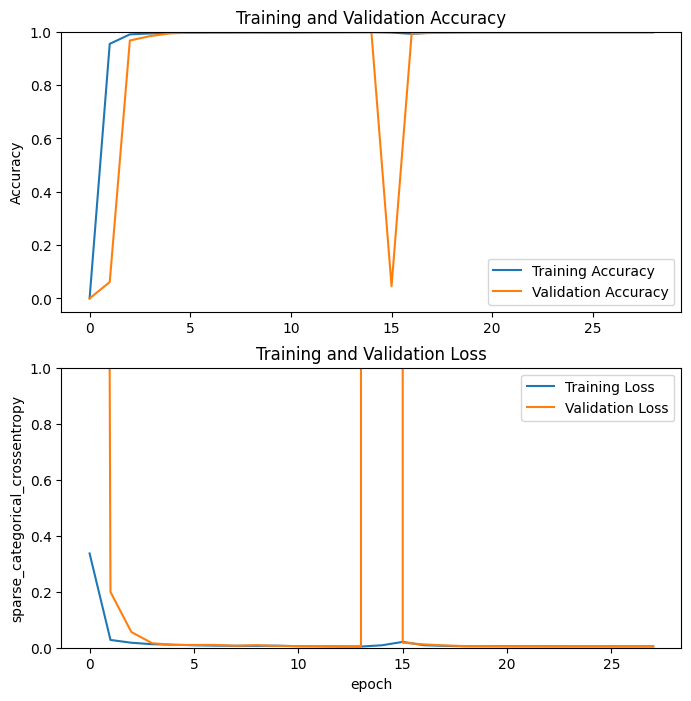

In [13]:
import matplotlib.pyplot as plt


acc = [0.] + history.history['accuracy']
val_acc = [0.] + history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('sparse_categorical_crossentropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [14]:
import tensorflow as tf

if 'model' not in globals():
    model = tf.keras.models.load_model('/Models/'+modelChoice + '.h5')

else:
    model.save('/Models/'+modelChoice + '.h5')



In [15]:
train_loss, train_accuracy = model.evaluate(trainDataset, batch_size = 32)
validation_loss, validation_accuracy = model.evaluate(valDataset, batch_size = 32)
test_loss, test_accuracy = model.evaluate(testDataset, batch_size = 32)

print(f'model Accuracy on the Training Dataset: {round(train_accuracy * 100, 2)}%')
print(f'model Accuracy on the Validation Dataset: {round(validation_accuracy * 100, 2)}%')
print(f'model Accuracy on the Test Dataset: {round(test_accuracy * 100, 2)}%')

63/63 [==============================] - 40s 532ms/step - loss: 0.0048 - accuracy: 0.9981
model Accuracy on the Training Dataset: 99.82%
model Accuracy on the Validation Dataset: 99.81%
model Accuracy on the Test Dataset: 99.81%


In [16]:
def display(display_list):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

In [17]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask[0]


1/1 [==============================] - 1s 514ms/step


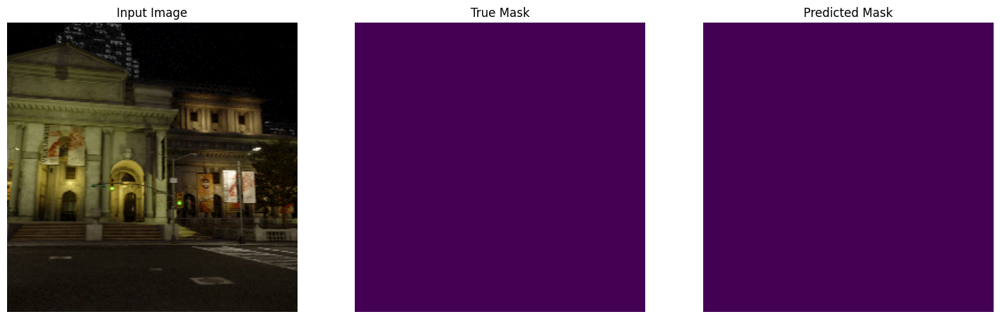

1/1 [==============================] - 0s 24ms/step


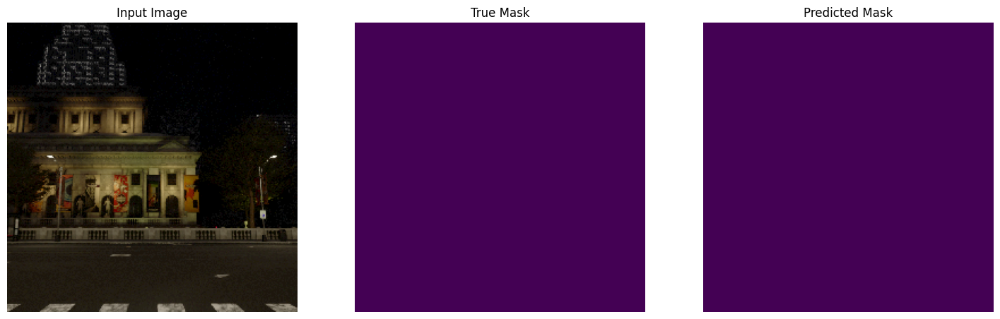

1/1 [==============================] - 0s 50ms/step


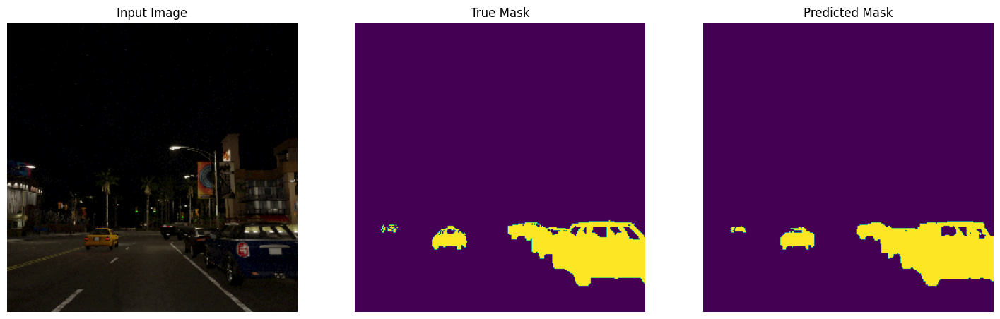

1/1 [==============================] - 0s 31ms/step


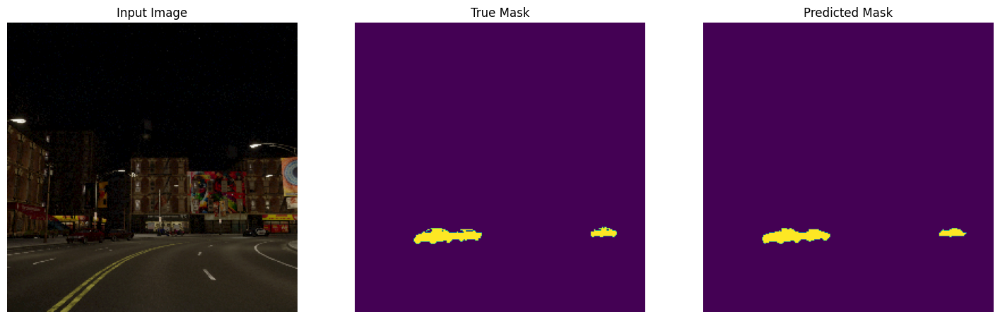

1/1 [==============================] - 0s 23ms/step


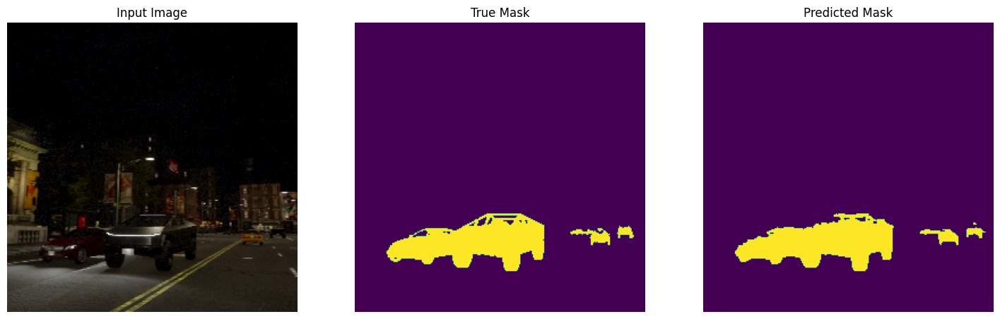

1/1 [==============================] - 0s 30ms/step


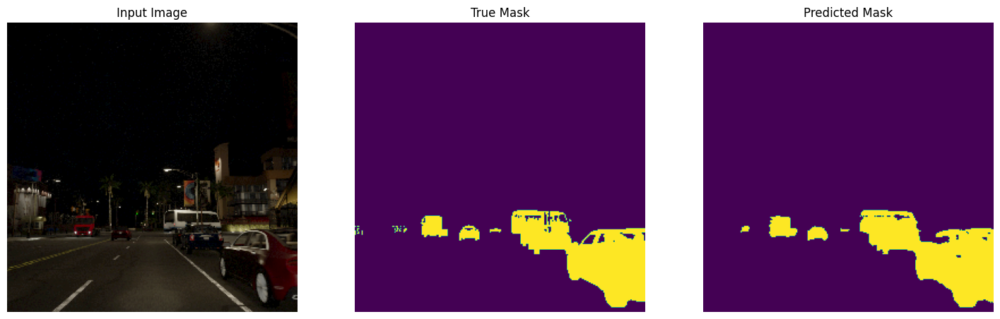

1/1 [==============================] - 0s 23ms/step


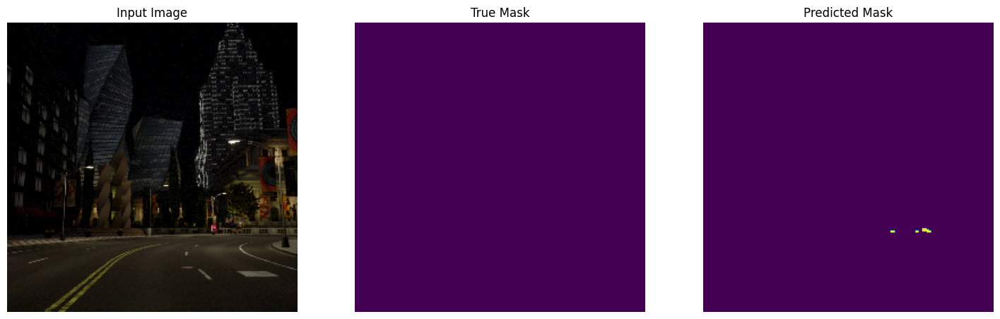

1/1 [==============================] - 0s 22ms/step


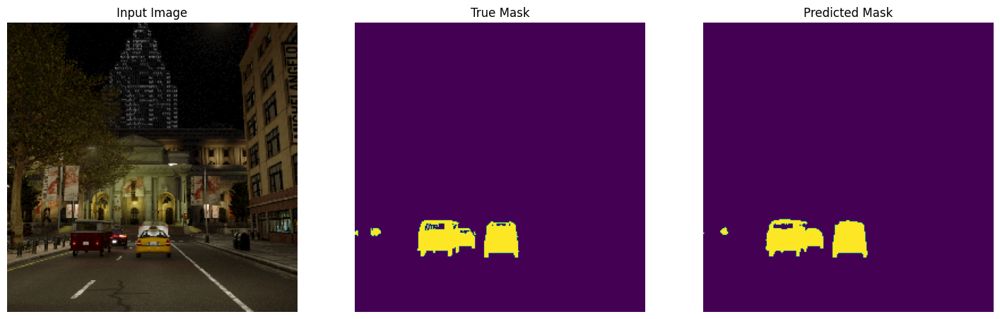

1/1 [==============================] - 0s 22ms/step


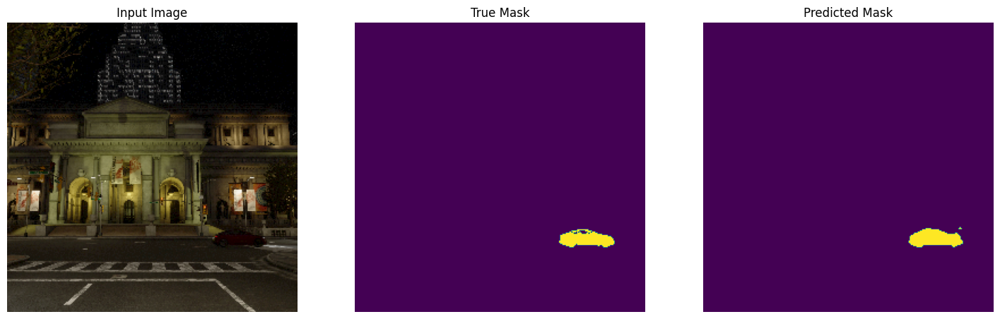

1/1 [==============================] - 0s 29ms/step


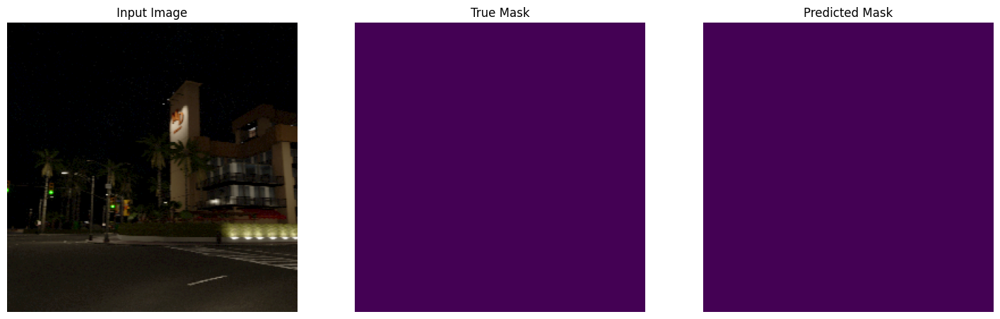

1/1 [==============================] - 0s 22ms/step


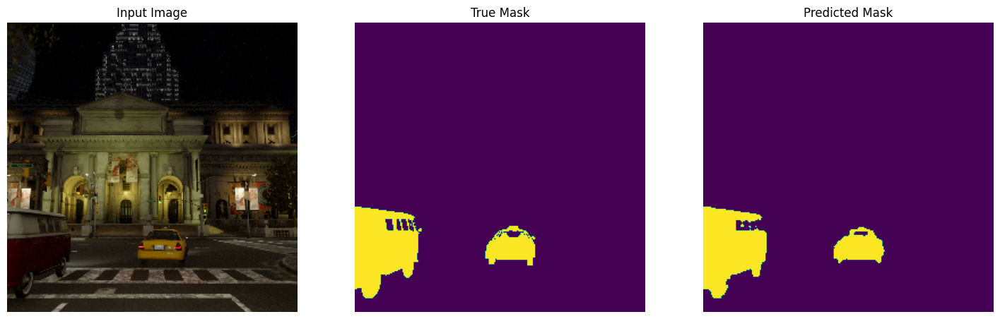

1/1 [==============================] - 0s 30ms/step


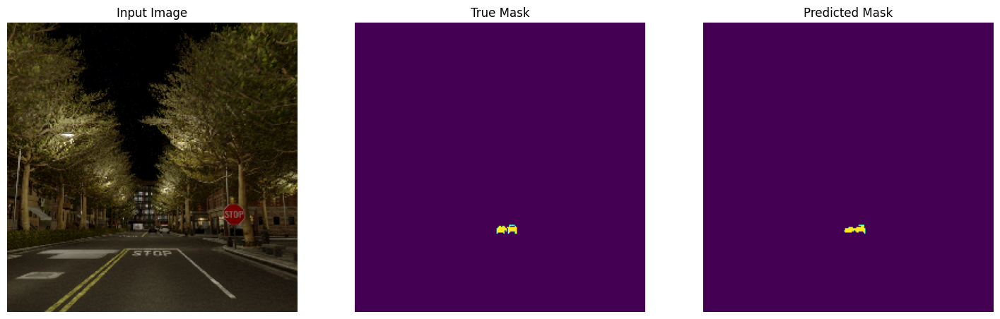

1/1 [==============================] - 0s 23ms/step


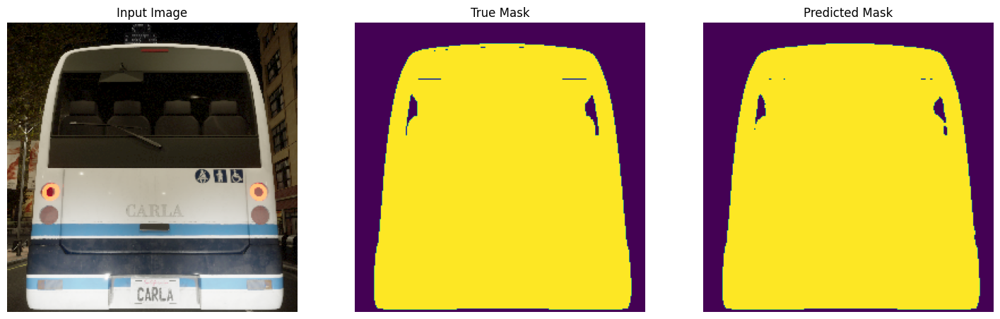

1/1 [==============================] - 0s 29ms/step


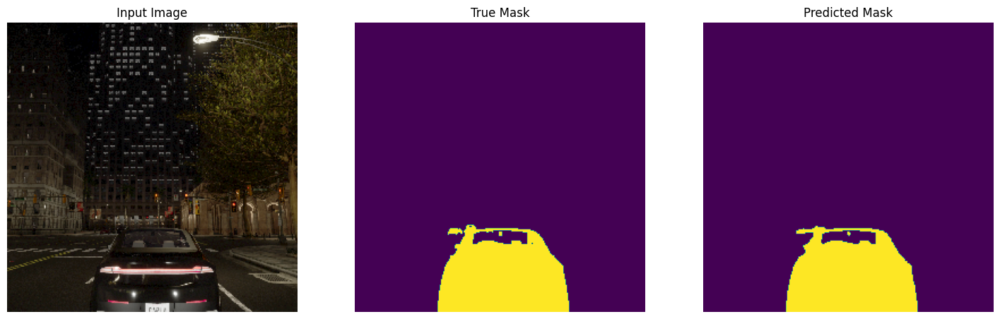

1/1 [==============================] - 0s 23ms/step


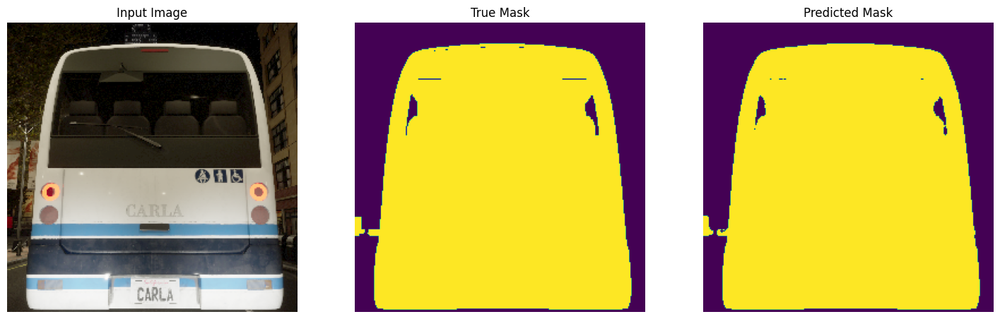

1/1 [==============================] - 0s 22ms/step


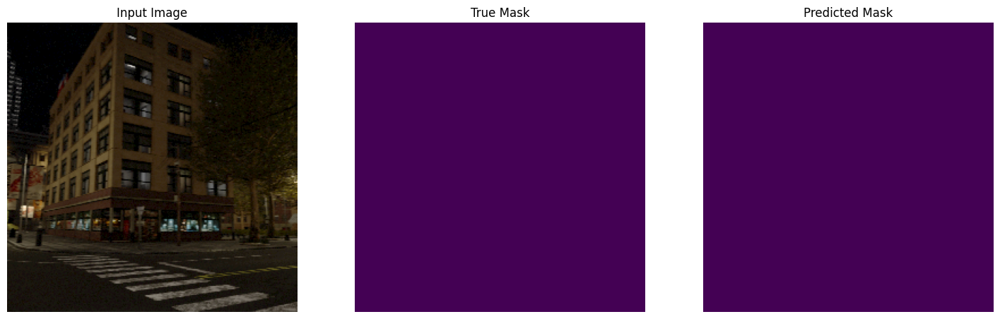

1/1 [==============================] - 0s 23ms/step


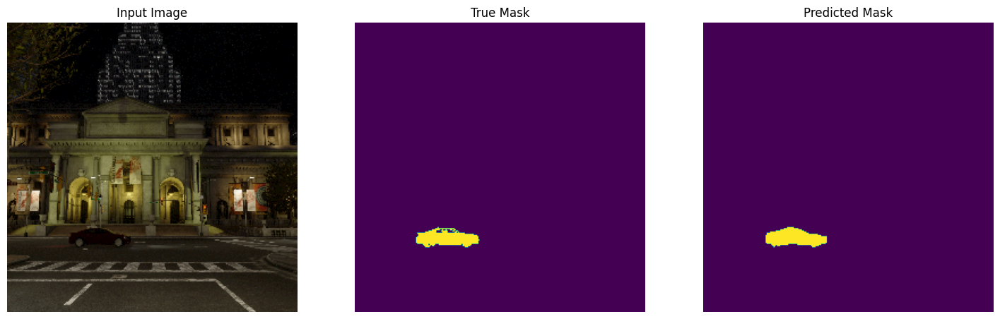

1/1 [==============================] - 0s 40ms/step


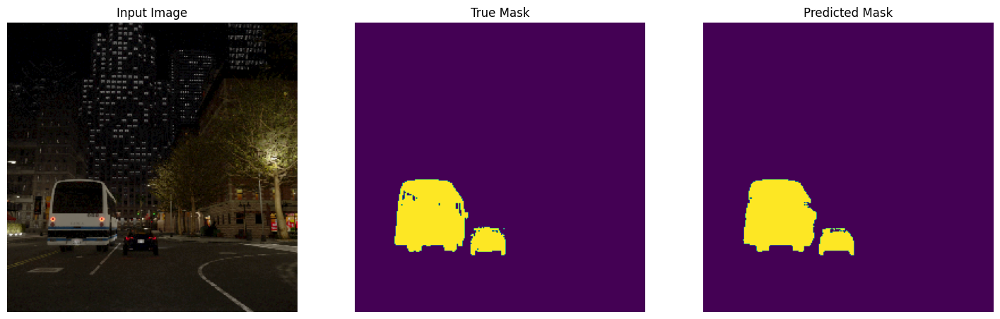

1/1 [==============================] - 0s 23ms/step


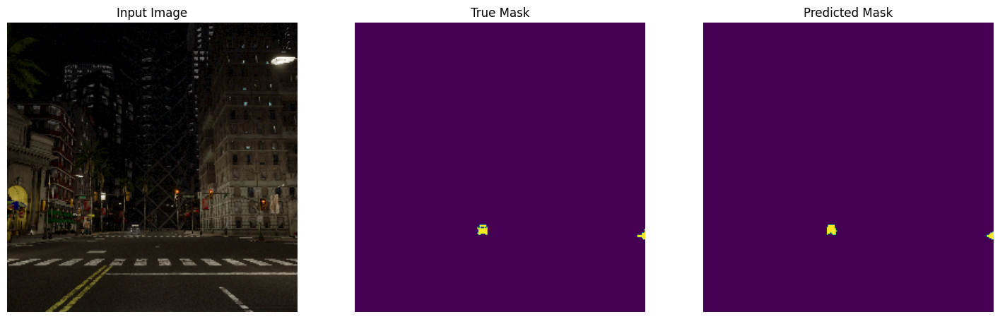

1/1 [==============================] - 0s 29ms/step


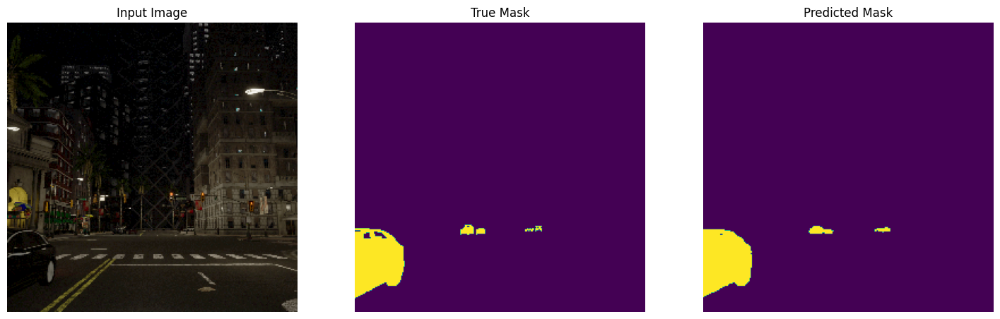

1/1 [==============================] - 0s 23ms/step


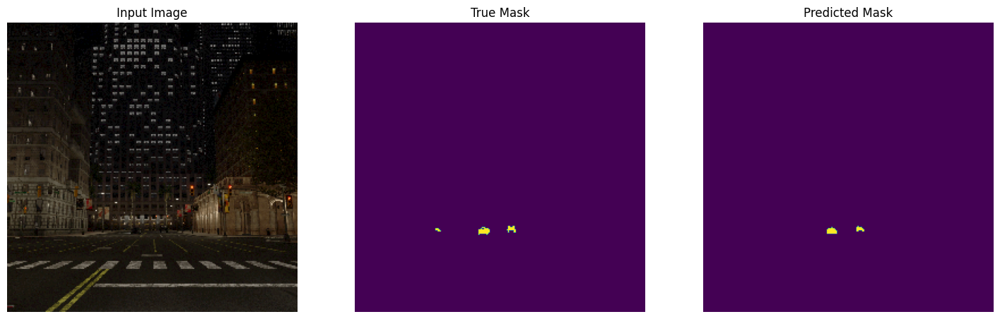

1/1 [==============================] - 0s 23ms/step


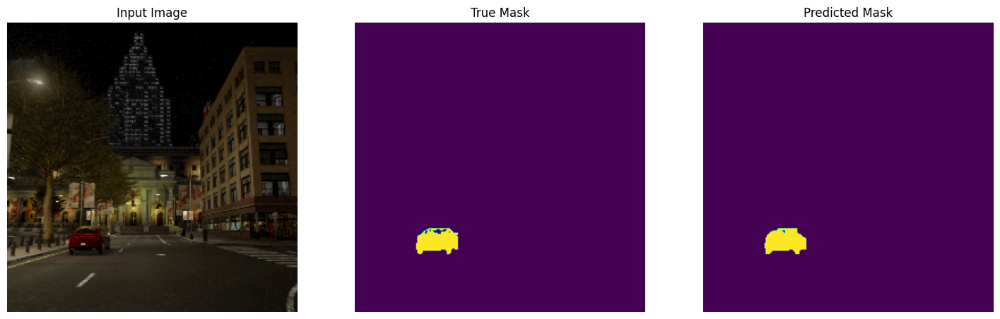

1/1 [==============================] - 0s 23ms/step


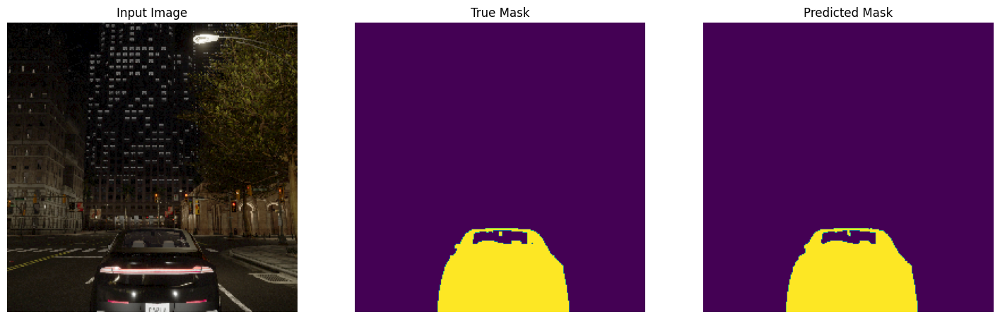

1/1 [==============================] - 0s 23ms/step


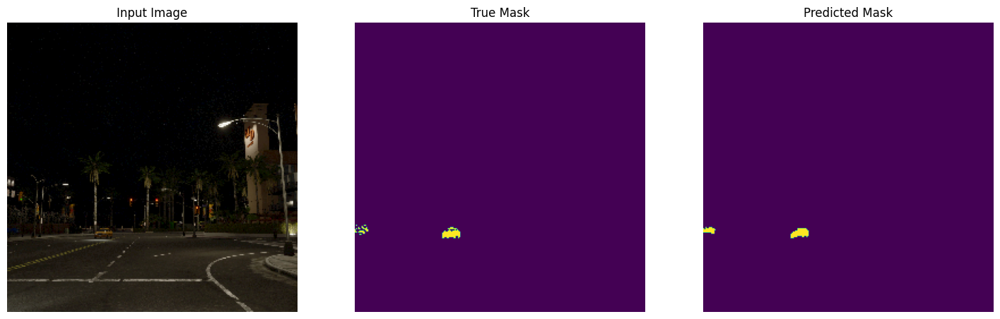

1/1 [==============================] - 0s 23ms/step


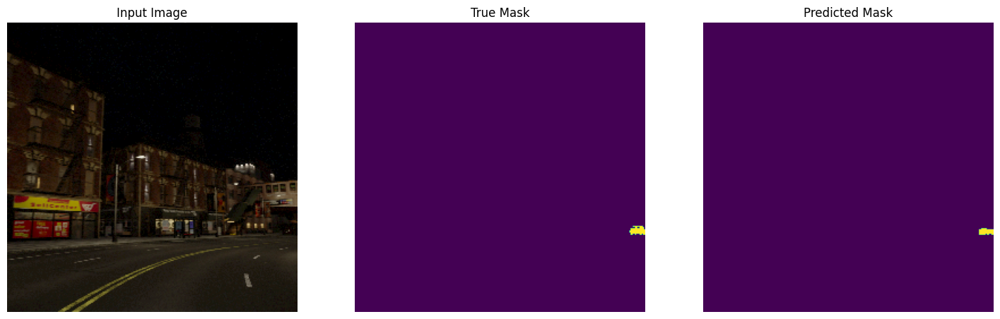

1/1 [==============================] - 0s 23ms/step


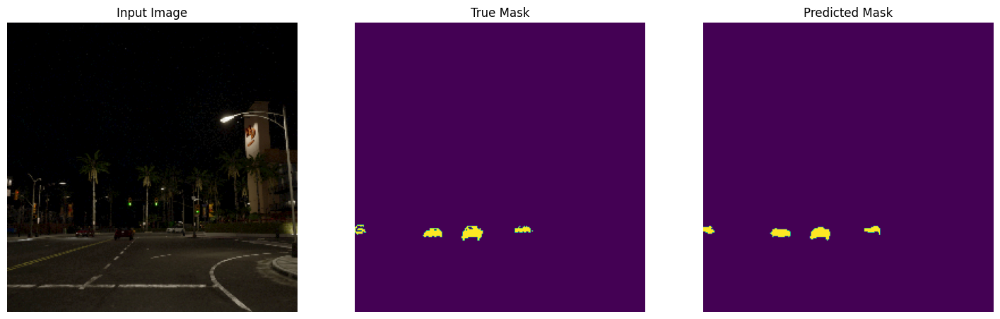

1/1 [==============================] - 0s 22ms/step


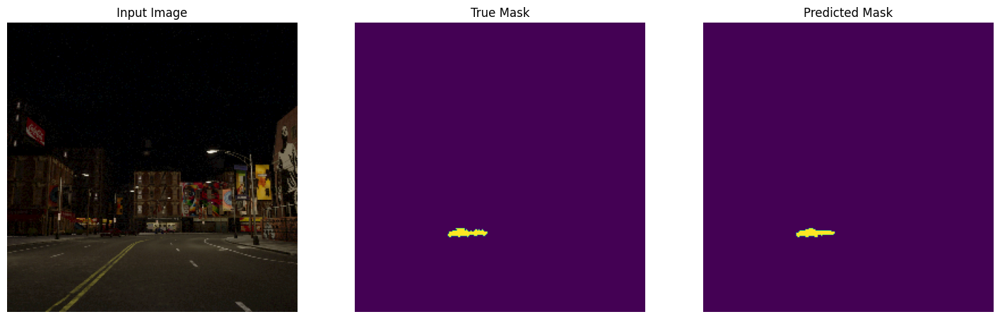

1/1 [==============================] - 0s 23ms/step


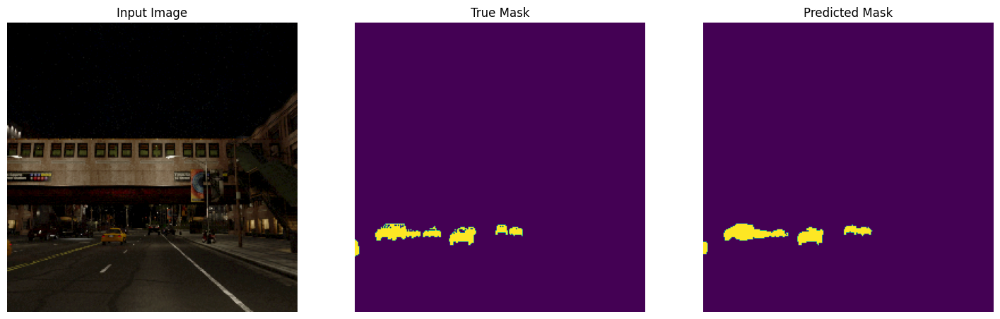

1/1 [==============================] - 0s 23ms/step


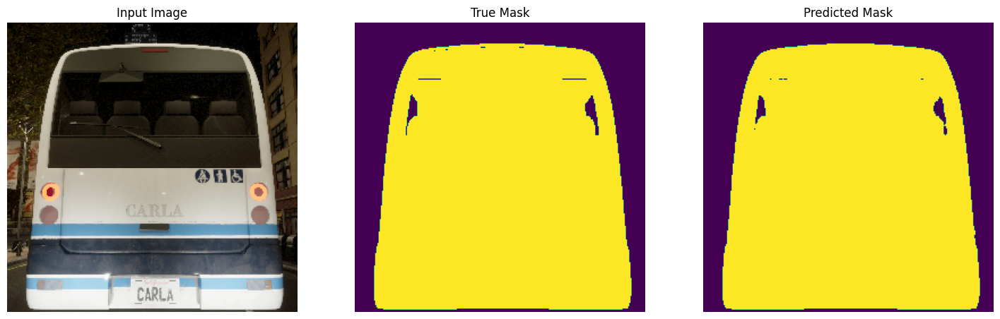

1/1 [==============================] - 0s 23ms/step


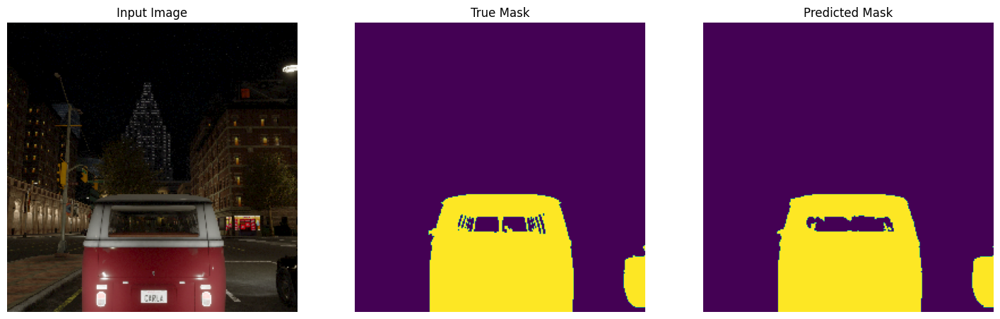

1/1 [==============================] - 0s 23ms/step


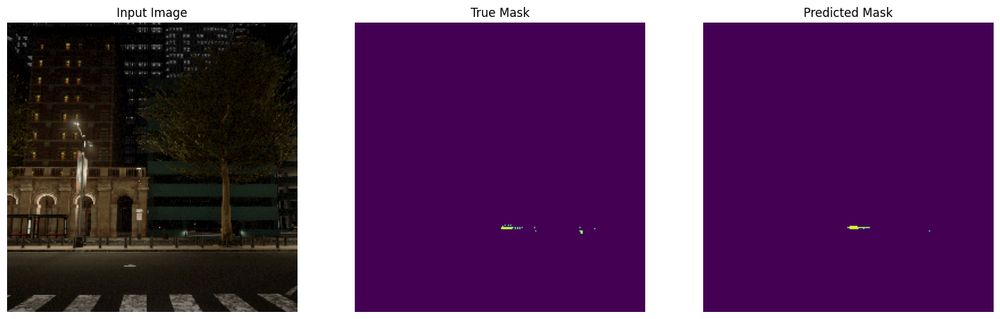

1/1 [==============================] - 0s 39ms/step


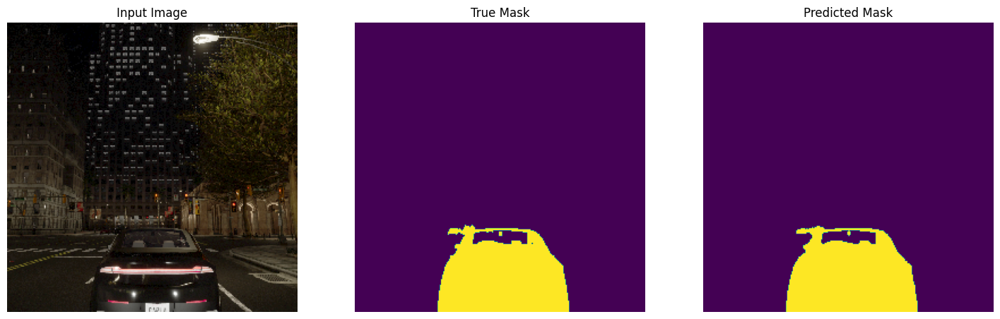

1/1 [==============================] - 0s 23ms/step


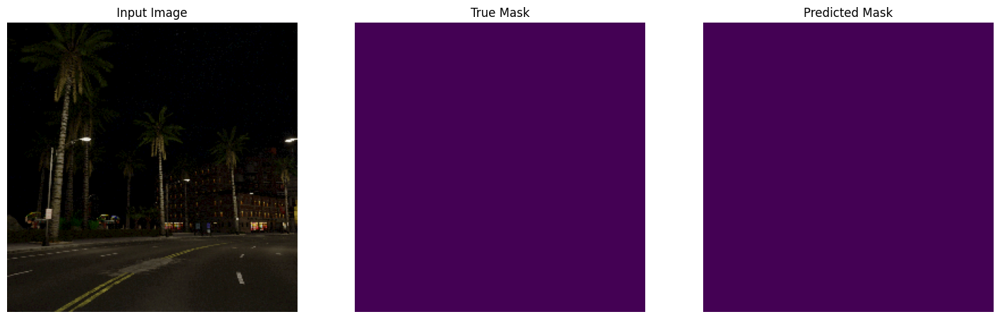

1/1 [==============================] - 0s 23ms/step


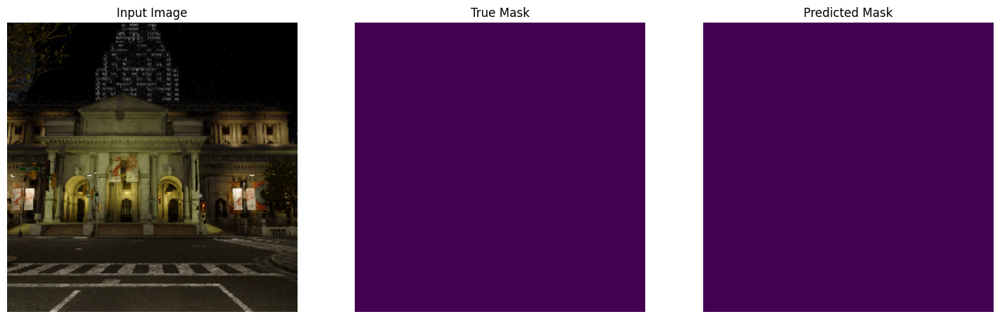

1/1 [==============================] - 0s 23ms/step


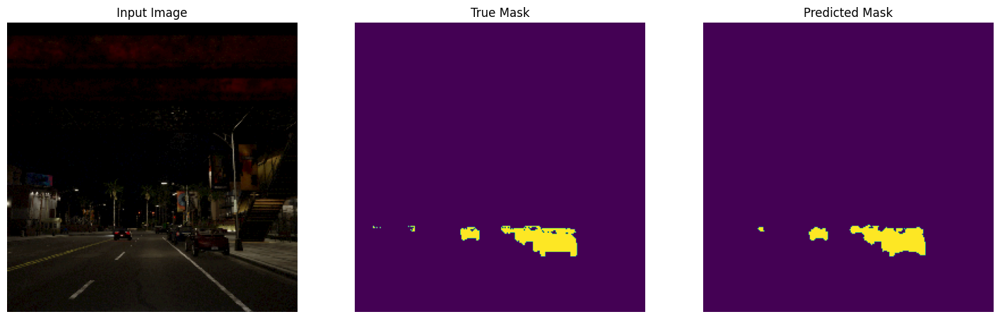

1/1 [==============================] - 0s 23ms/step


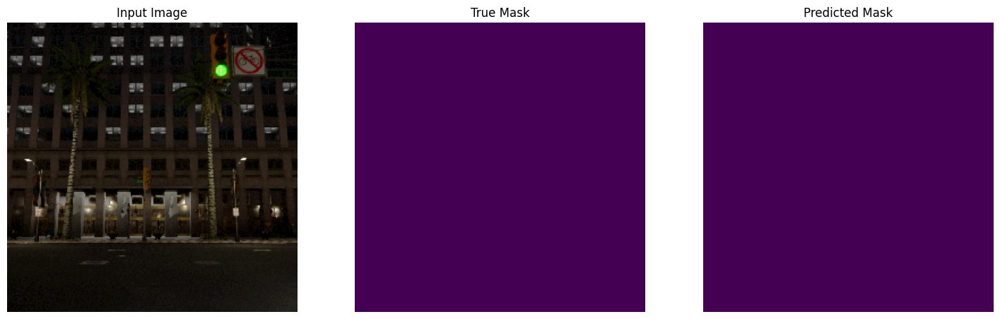

1/1 [==============================] - 0s 23ms/step


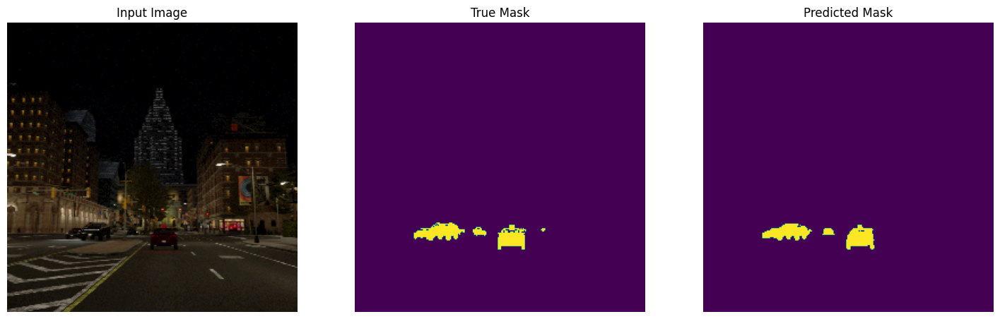

1/1 [==============================] - 0s 22ms/step


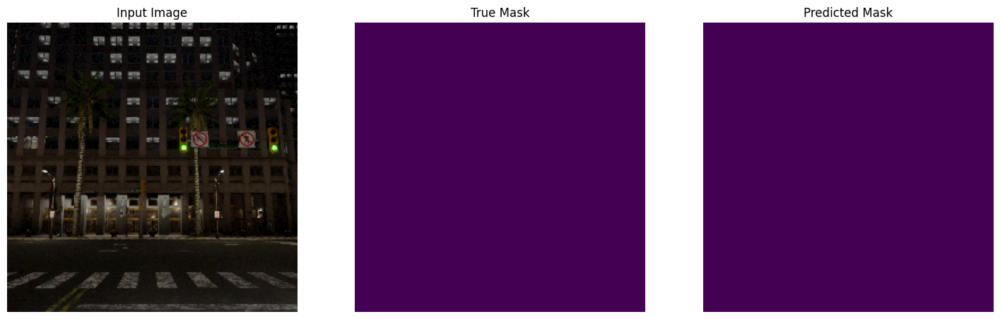

1/1 [==============================] - 0s 22ms/step


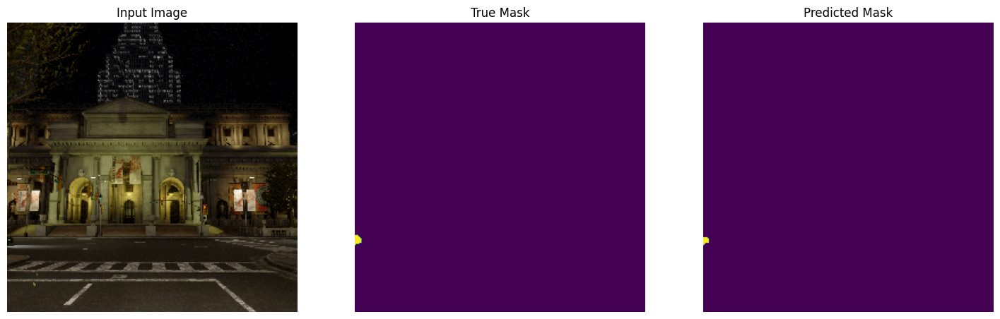

1/1 [==============================] - 0s 23ms/step


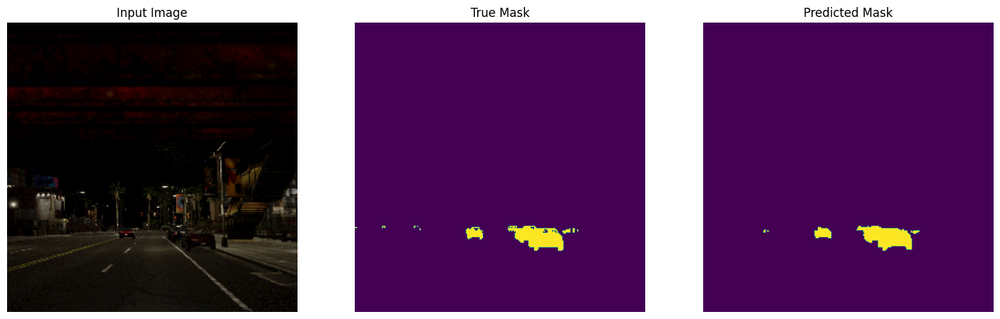

1/1 [==============================] - 0s 23ms/step


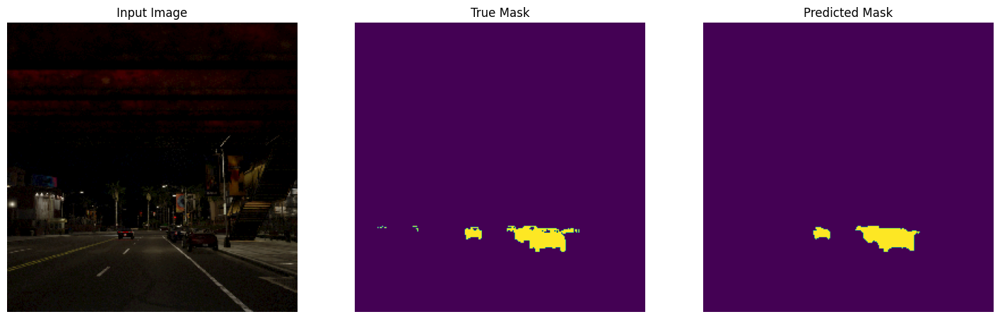

1/1 [==============================] - 0s 23ms/step


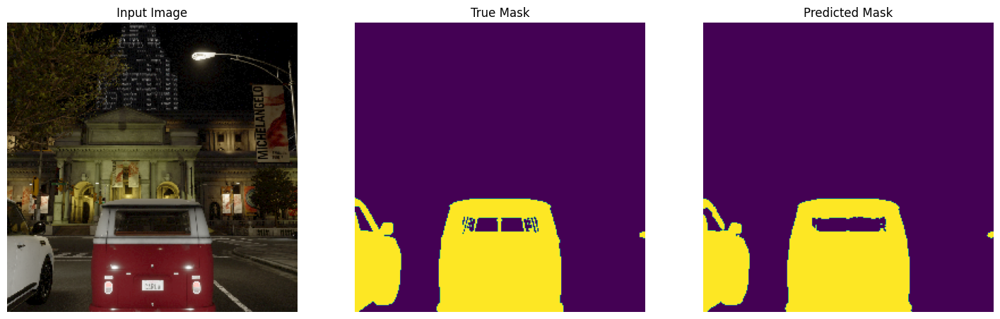

1/1 [==============================] - 0s 23ms/step


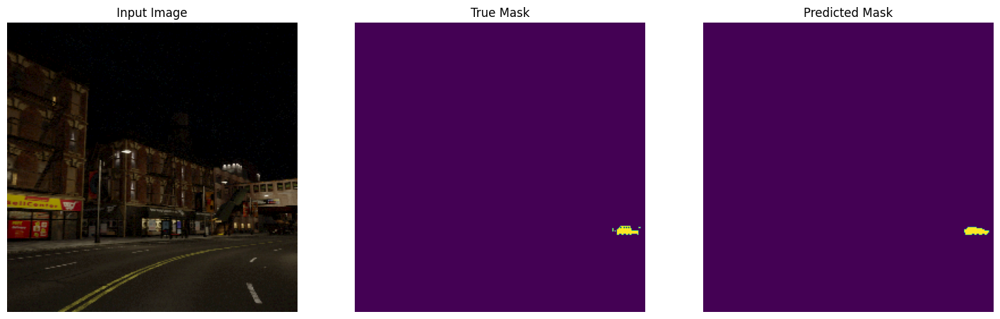

1/1 [==============================] - 0s 23ms/step


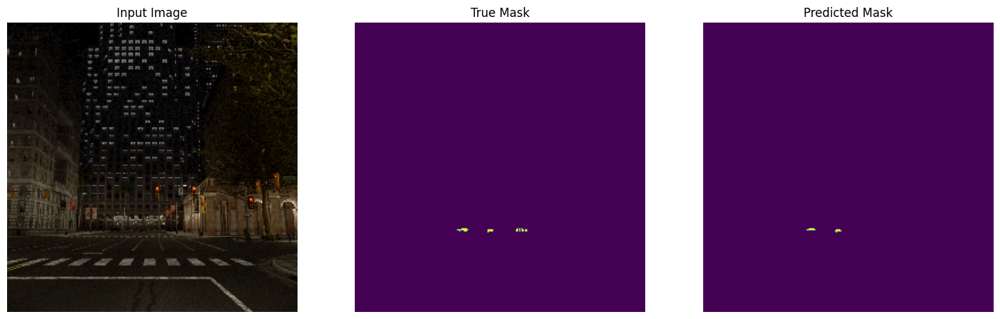

1/1 [==============================] - 0s 23ms/step


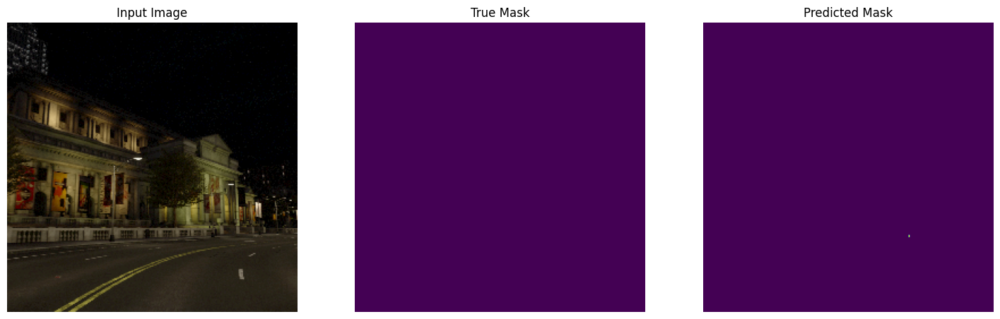

1/1 [==============================] - 0s 22ms/step


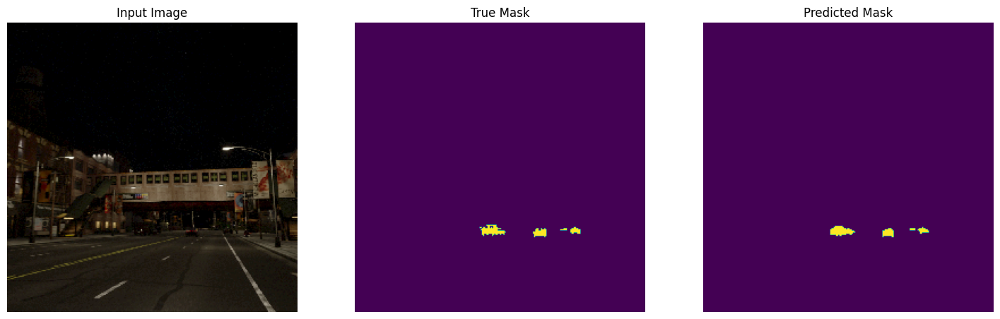

1/1 [==============================] - 0s 23ms/step


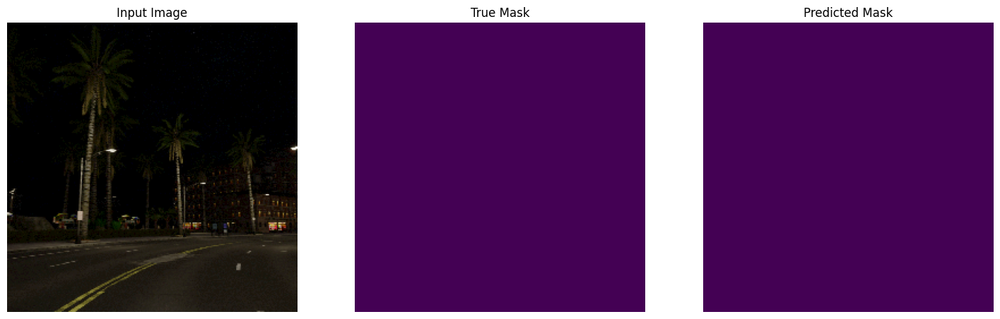

1/1 [==============================] - 0s 23ms/step


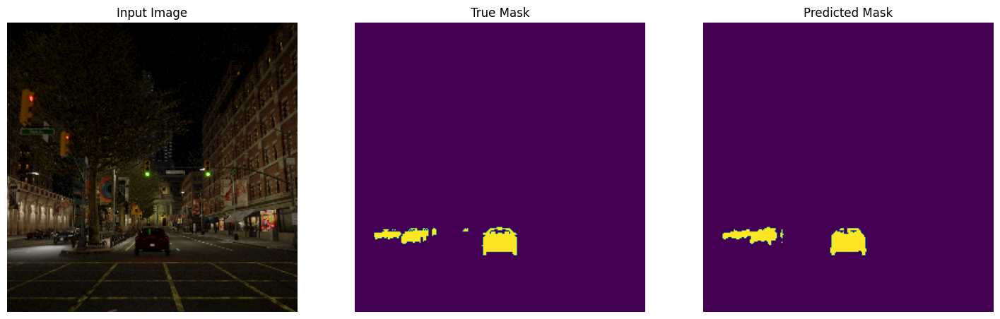

1/1 [==============================] - 0s 22ms/step


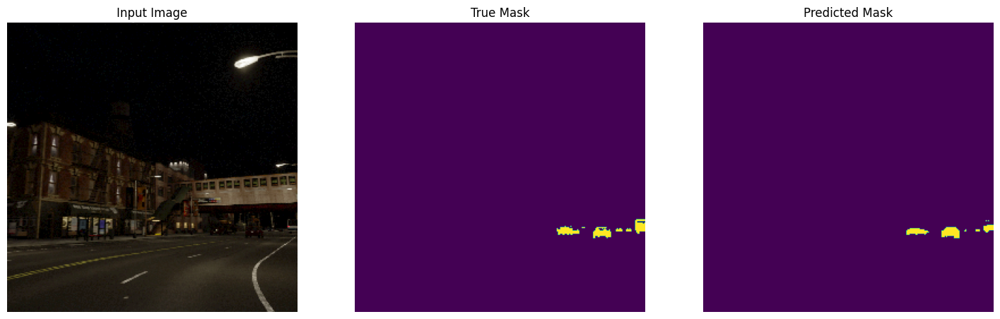

1/1 [==============================] - 0s 23ms/step


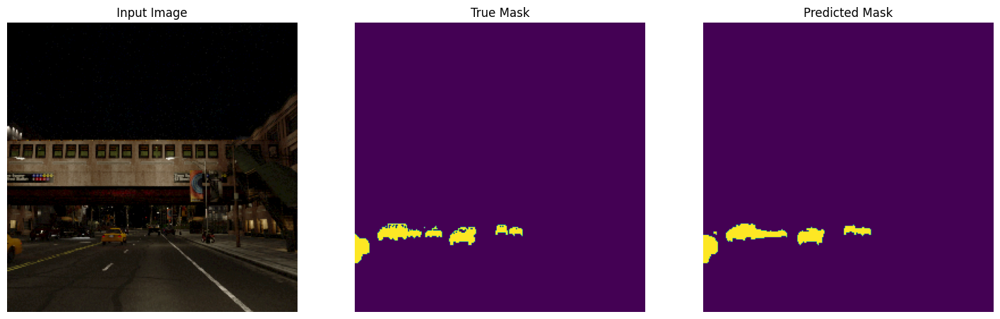

1/1 [==============================] - 0s 23ms/step


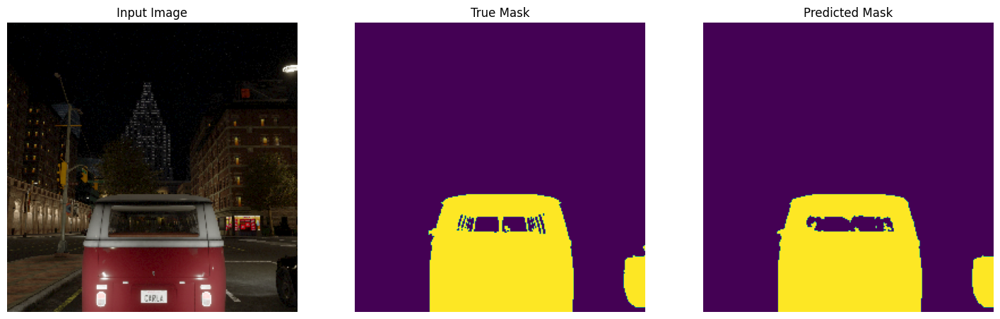

1/1 [==============================] - 0s 43ms/step


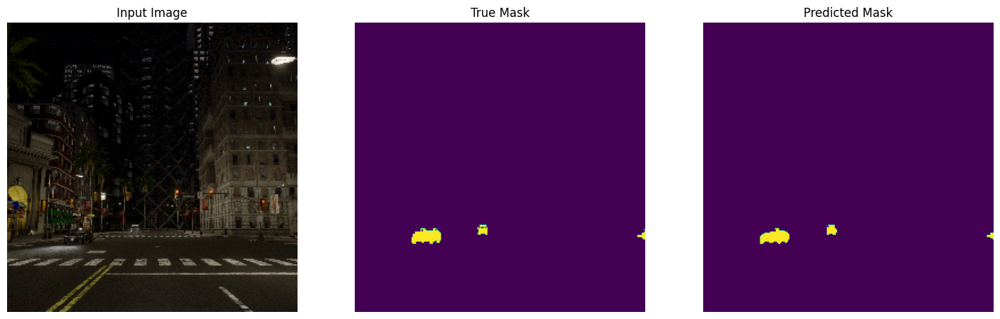

1/1 [==============================] - 0s 22ms/step


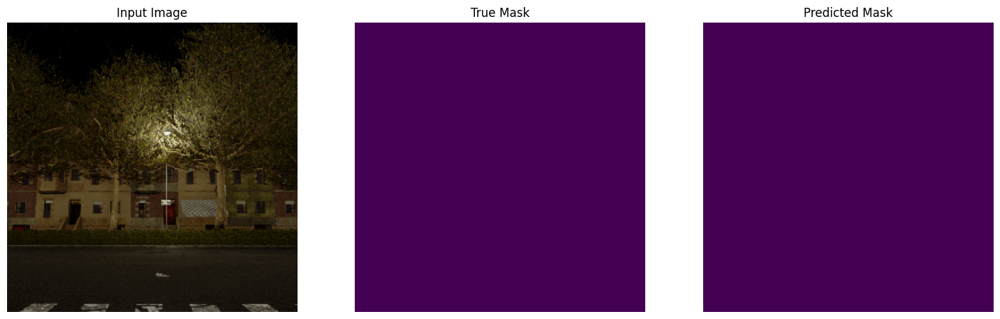

1/1 [==============================] - 0s 23ms/step


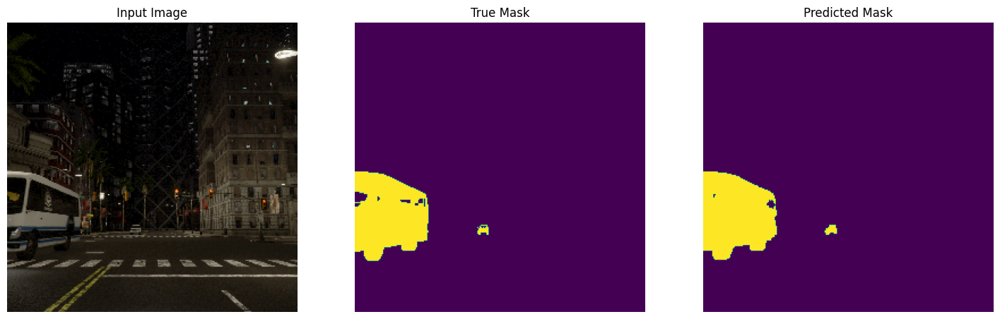

1/1 [==============================] - 0s 23ms/step


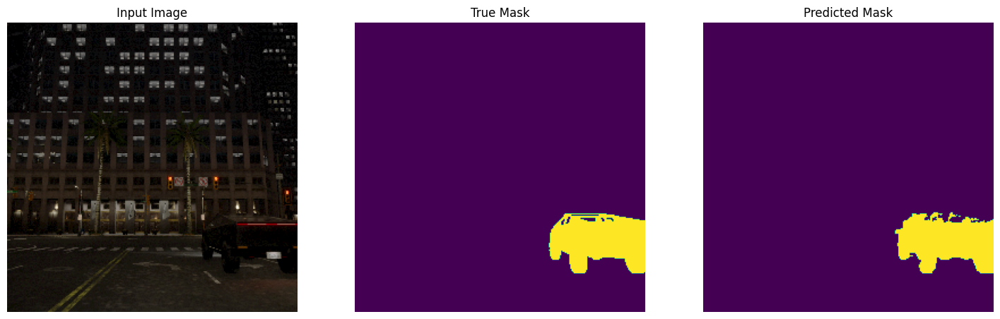

1/1 [==============================] - 0s 23ms/step


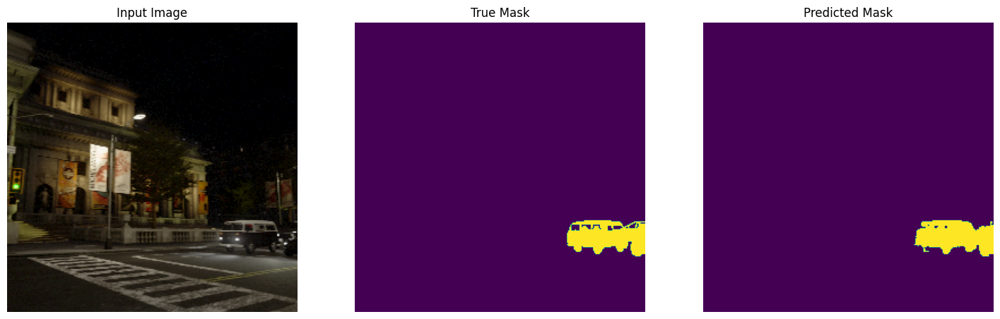

1/1 [==============================] - 0s 23ms/step


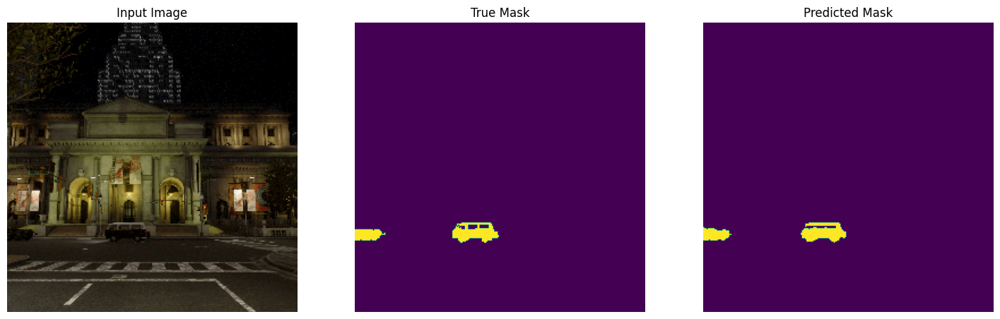

1/1 [==============================] - 0s 23ms/step


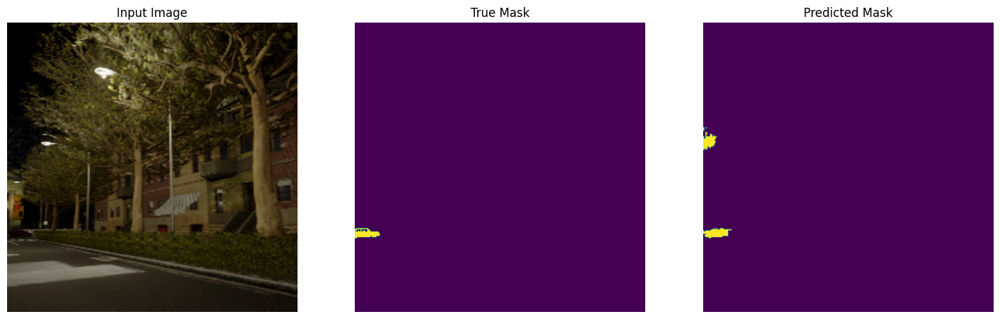

1/1 [==============================] - 0s 23ms/step


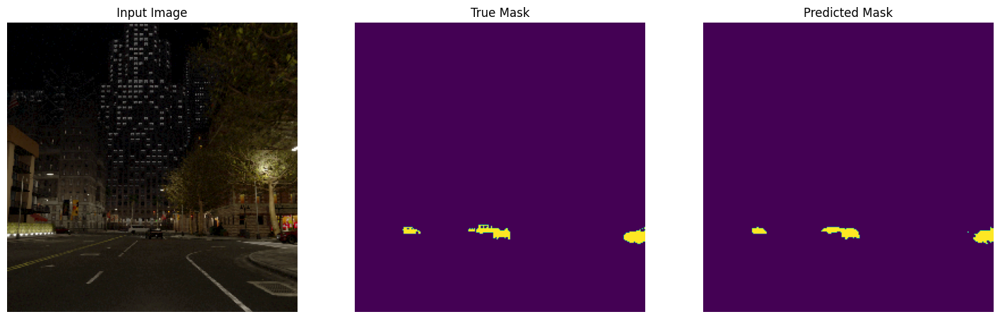

1/1 [==============================] - 0s 23ms/step


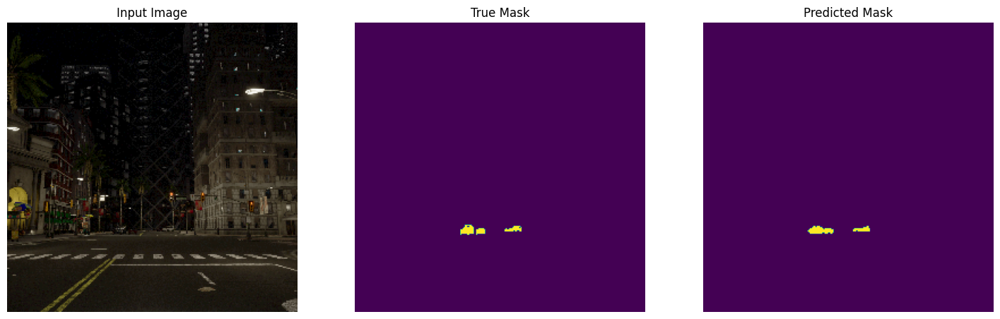

1/1 [==============================] - 0s 23ms/step


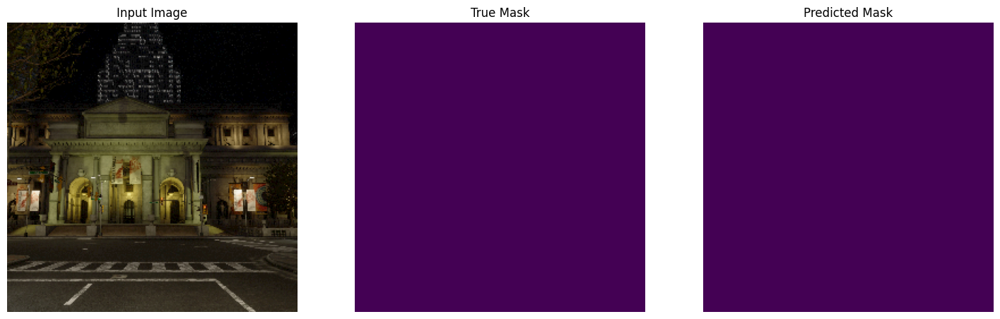

1/1 [==============================] - 0s 24ms/step


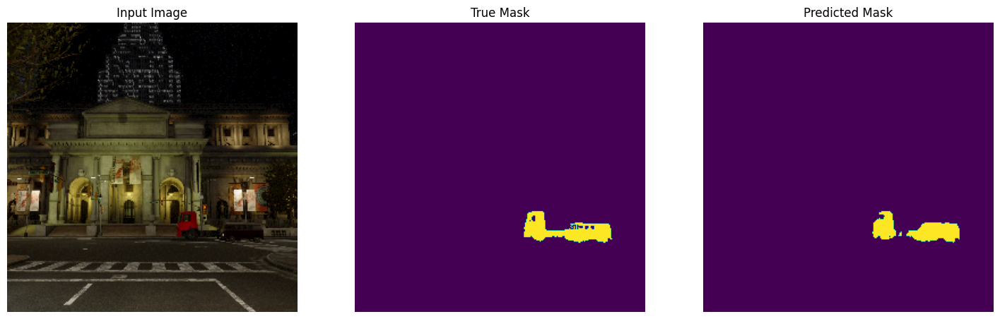

1/1 [==============================] - 0s 222ms/step


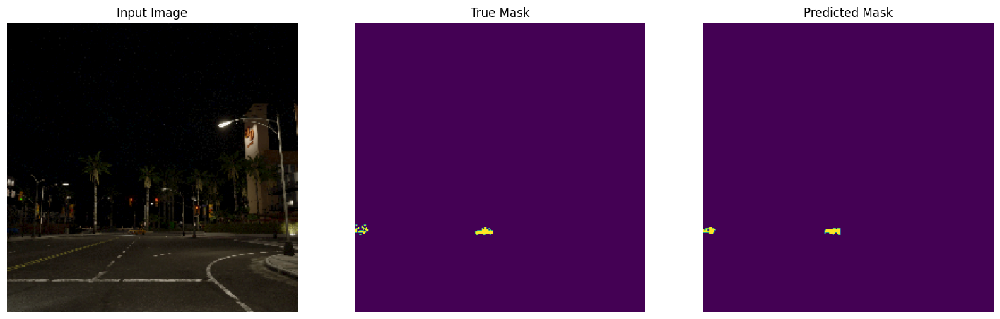

In [18]:
def show_predictions(dataset, num):
    """
    Displays the first image of each of the num batches
    """
    if dataset:
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            display([image[0], mask[0], create_mask(pred_mask)])
    else:
        display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))])

show_predictions(testDataset,100)